<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_4_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(3):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 29.0928 - IoU: 0.0934
Epoch 1: val_loss improved from inf to 36.40247, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4


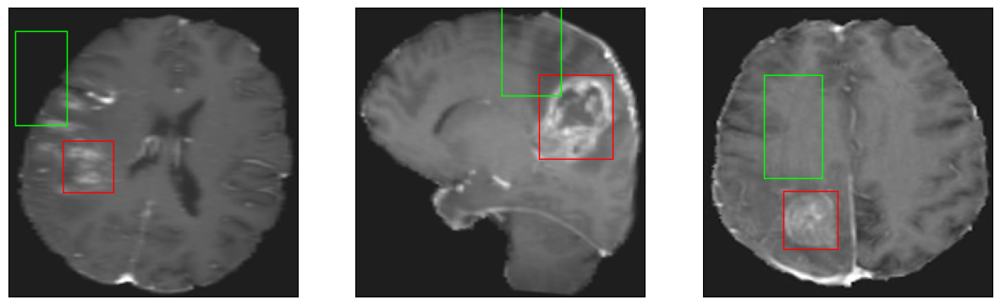

26/26 [==============================] - 17s 183ms/step - loss: 28.8453 - IoU: 0.0944 - val_loss: 36.4025 - val_IoU: 0.0652
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 17.7224 - IoU: 0.2034
Epoch 2: val_loss did not improve from 36.40247
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4


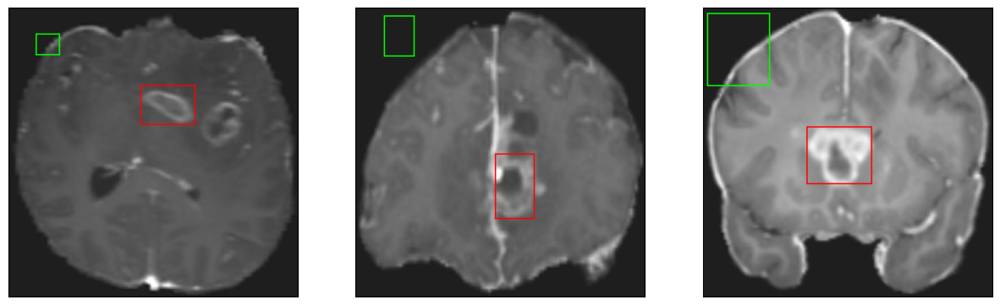

26/26 [==============================] - 2s 89ms/step - loss: 17.7170 - IoU: 0.2044 - val_loss: 45.6368 - val_IoU: 2.5956e-04
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 14.9786 - IoU: 0.2616
Epoch 3: val_loss did not improve from 36.40247
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


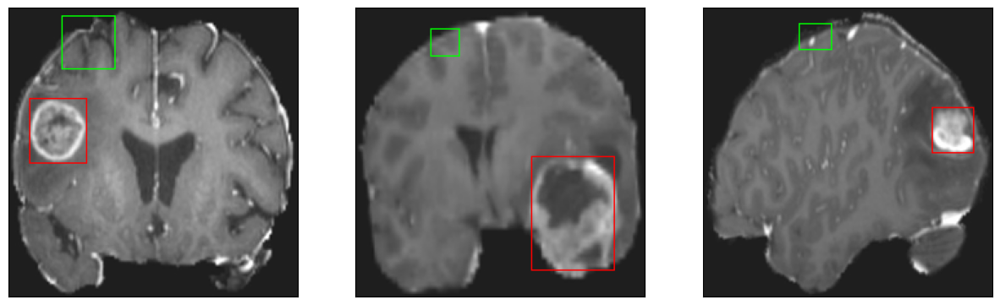

26/26 [==============================] - 2s 79ms/step - loss: 14.9786 - IoU: 0.2616 - val_loss: 41.2031 - val_IoU: 0.0019
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 13.4380 - IoU: 0.3018
Epoch 4: val_loss did not improve from 36.40247
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


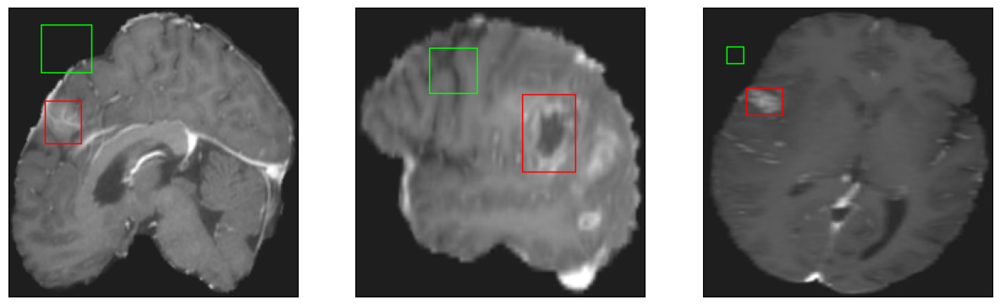

26/26 [==============================] - 2s 85ms/step - loss: 13.4064 - IoU: 0.3014 - val_loss: 43.5644 - val_IoU: 2.6436e-04
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 12.4983 - IoU: 0.3128
Epoch 5: val_loss did not improve from 36.40247
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


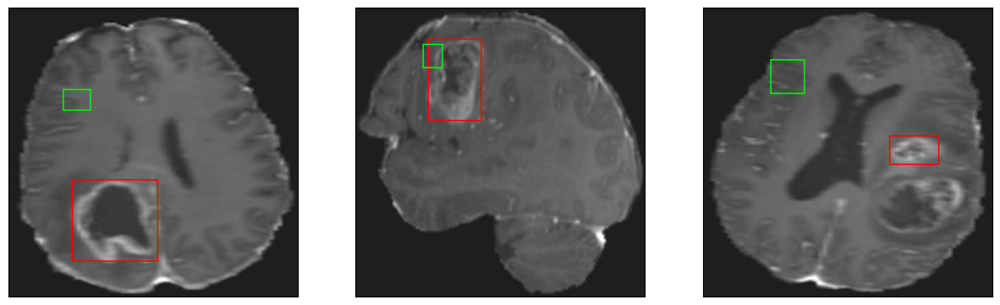

26/26 [==============================] - 3s 118ms/step - loss: 12.4983 - IoU: 0.3128 - val_loss: 38.6182 - val_IoU: 0.0039
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 11.6924 - IoU: 0.3475
Epoch 6: val_loss improved from 36.40247 to 35.79848, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


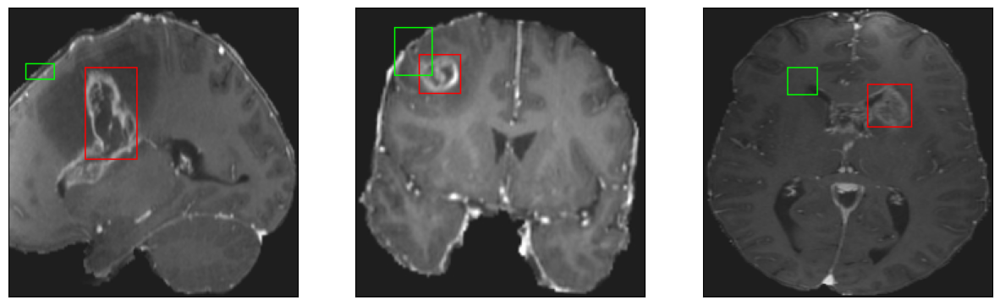

26/26 [==============================] - 3s 133ms/step - loss: 11.6924 - IoU: 0.3475 - val_loss: 35.7985 - val_IoU: 0.0081
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 10.7642 - IoU: 0.3697
Epoch 7: val_loss improved from 35.79848 to 31.48591, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


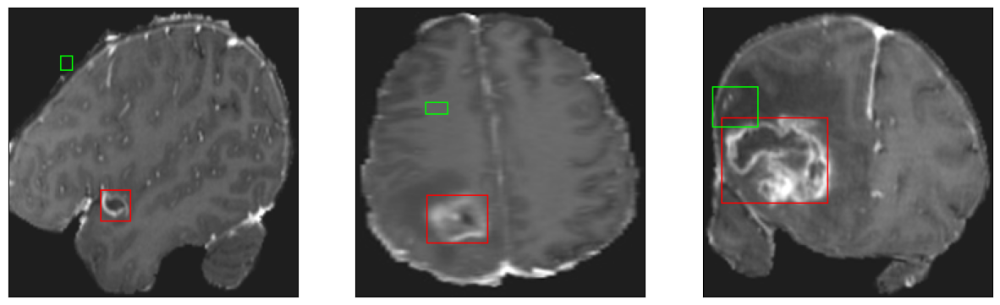

26/26 [==============================] - 3s 111ms/step - loss: 10.7642 - IoU: 0.3697 - val_loss: 31.4859 - val_IoU: 0.0275
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 10.4457 - IoU: 0.3787
Epoch 8: val_loss improved from 31.48591 to 27.67380, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4


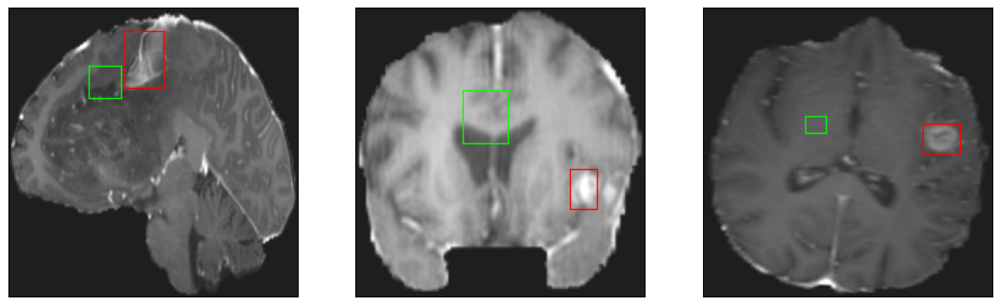

26/26 [==============================] - 3s 118ms/step - loss: 10.4804 - IoU: 0.3764 - val_loss: 27.6738 - val_IoU: 0.0573
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 9.8146 - IoU: 0.3879
Epoch 9: val_loss improved from 27.67380 to 22.49013, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


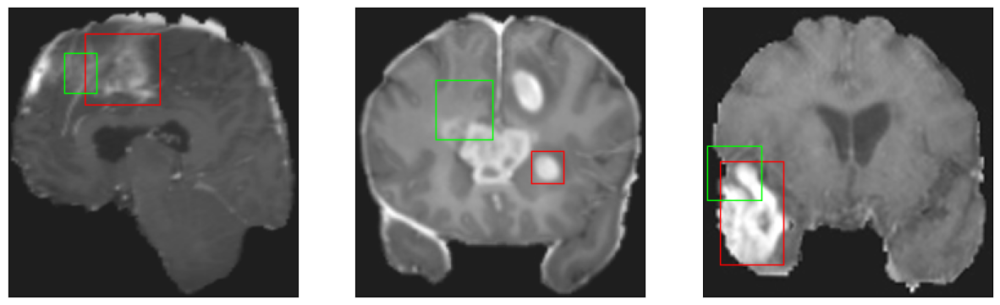

26/26 [==============================] - 4s 138ms/step - loss: 9.8078 - IoU: 0.3858 - val_loss: 22.4901 - val_IoU: 0.1106
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 9.6952 - IoU: 0.3910
Epoch 10: val_loss did not improve from 22.49013
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


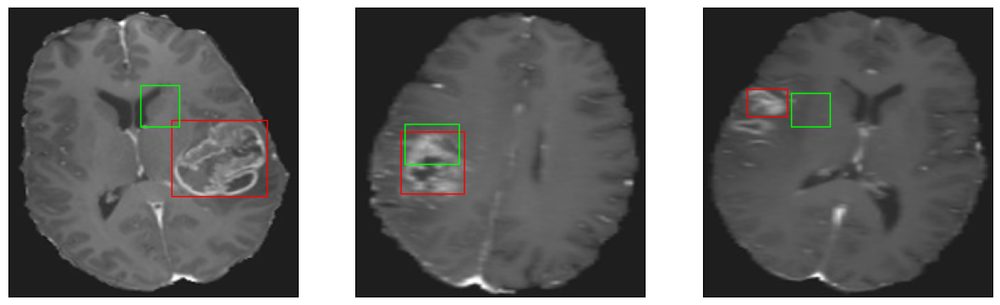

26/26 [==============================] - 2s 93ms/step - loss: 9.6952 - IoU: 0.3910 - val_loss: 24.3331 - val_IoU: 0.0707
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.4193 - IoU: 0.3887
Epoch 11: val_loss improved from 22.49013 to 17.78542, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


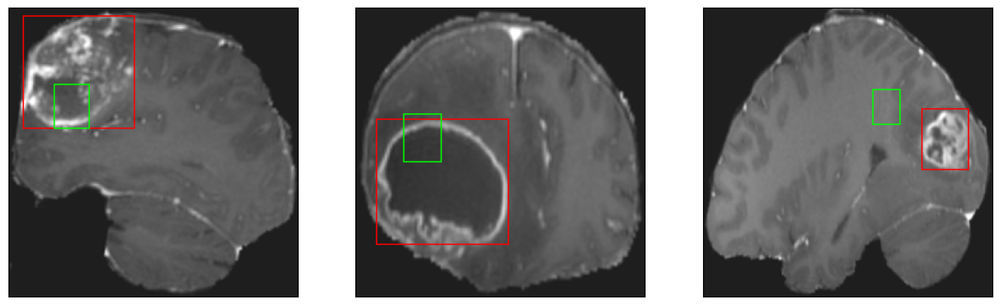

26/26 [==============================] - 3s 107ms/step - loss: 9.4082 - IoU: 0.3881 - val_loss: 17.7854 - val_IoU: 0.1948
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 8.6935 - IoU: 0.4176
Epoch 12: val_loss did not improve from 17.78542
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


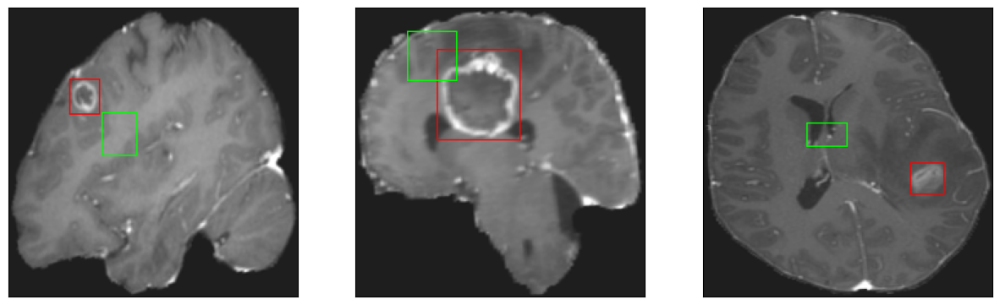

26/26 [==============================] - 3s 97ms/step - loss: 8.6935 - IoU: 0.4176 - val_loss: 19.2666 - val_IoU: 0.1541
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 8.4020 - IoU: 0.4372
Epoch 13: val_loss improved from 17.78542 to 16.28705, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


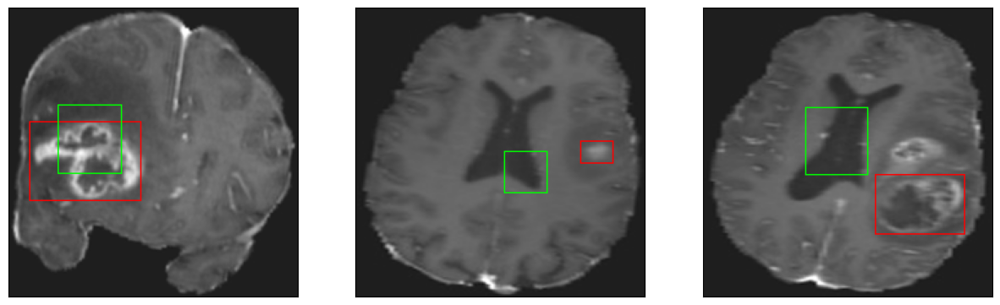

26/26 [==============================] - 3s 135ms/step - loss: 8.4020 - IoU: 0.4372 - val_loss: 16.2871 - val_IoU: 0.2119
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 8.2507 - IoU: 0.4337
Epoch 14: val_loss improved from 16.28705 to 15.55694, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


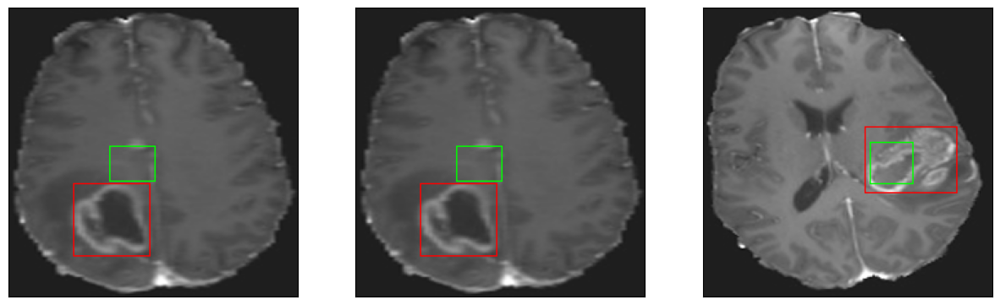

26/26 [==============================] - 3s 106ms/step - loss: 8.2507 - IoU: 0.4337 - val_loss: 15.5569 - val_IoU: 0.2400
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 8.3313 - IoU: 0.4333
Epoch 15: val_loss improved from 15.55694 to 13.07987, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


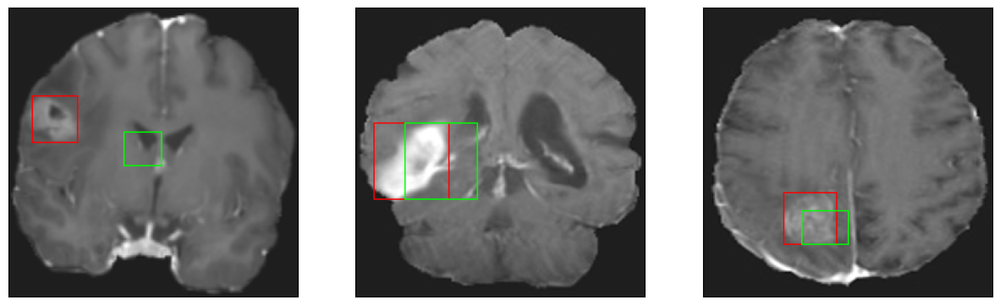

26/26 [==============================] - 4s 151ms/step - loss: 8.3313 - IoU: 0.4333 - val_loss: 13.0799 - val_IoU: 0.3335
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 8.1373 - IoU: 0.4406
Epoch 16: val_loss did not improve from 13.07987
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


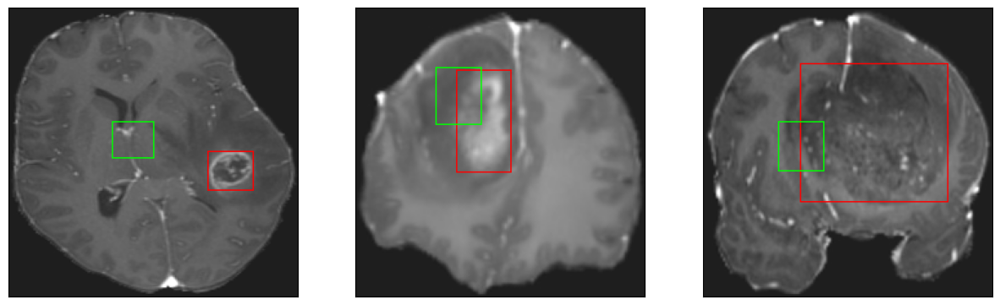

26/26 [==============================] - 3s 129ms/step - loss: 8.1382 - IoU: 0.4388 - val_loss: 14.5838 - val_IoU: 0.2662
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7407 - IoU: 0.4500
Epoch 17: val_loss improved from 13.07987 to 12.33981, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


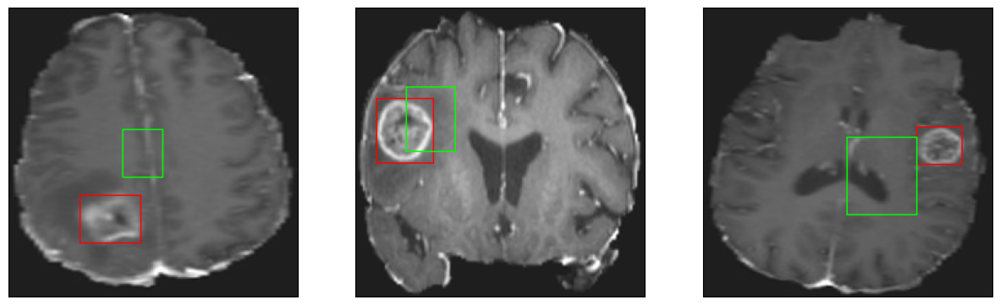

26/26 [==============================] - 4s 151ms/step - loss: 7.7107 - IoU: 0.4528 - val_loss: 12.3398 - val_IoU: 0.3530
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7346 - IoU: 0.4569
Epoch 18: val_loss improved from 12.33981 to 12.14036, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


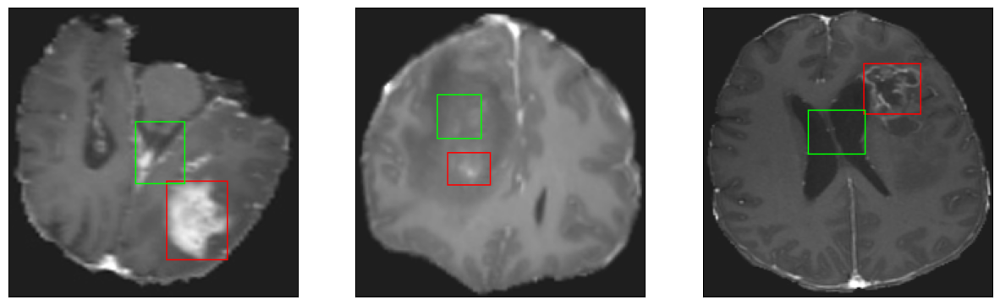

26/26 [==============================] - 3s 106ms/step - loss: 7.7272 - IoU: 0.4586 - val_loss: 12.1404 - val_IoU: 0.3516
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 7.5012 - IoU: 0.4705
Epoch 19: val_loss improved from 12.14036 to 11.77170, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


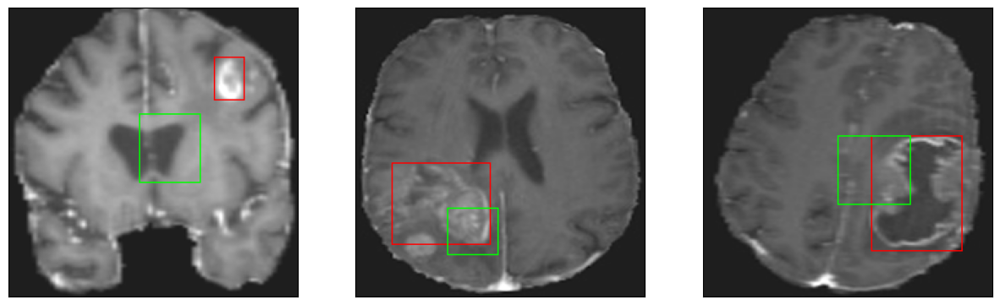

26/26 [==============================] - 4s 139ms/step - loss: 7.5012 - IoU: 0.4705 - val_loss: 11.7717 - val_IoU: 0.3662
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4130 - IoU: 0.4689
Epoch 20: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


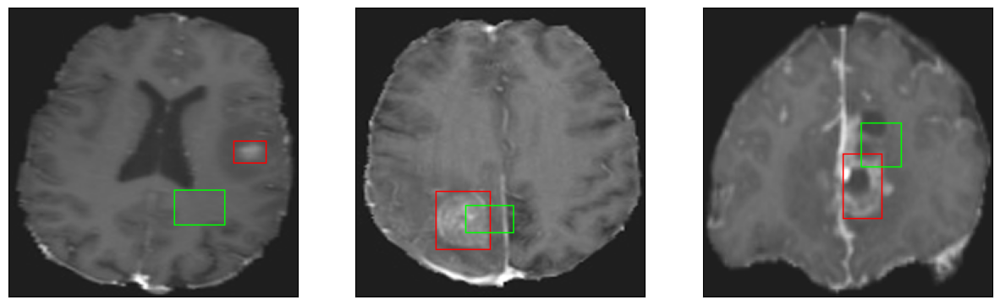

26/26 [==============================] - 3s 107ms/step - loss: 7.4005 - IoU: 0.4686 - val_loss: 13.6195 - val_IoU: 0.2983
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6615 - IoU: 0.4685
Epoch 21: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


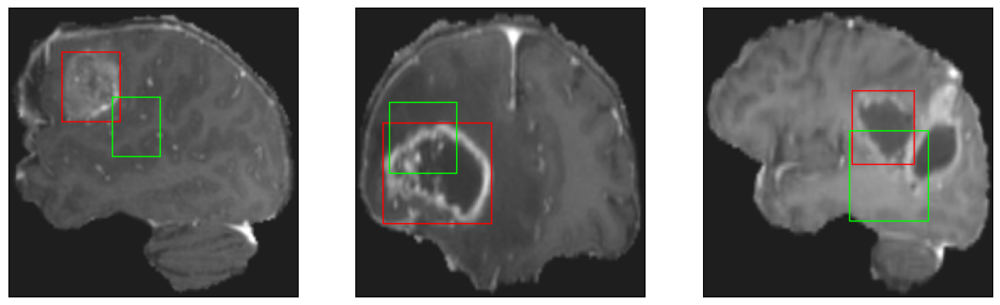

26/26 [==============================] - 3s 105ms/step - loss: 7.6419 - IoU: 0.4702 - val_loss: 12.9402 - val_IoU: 0.3390
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4898 - IoU: 0.4703
Epoch 22: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


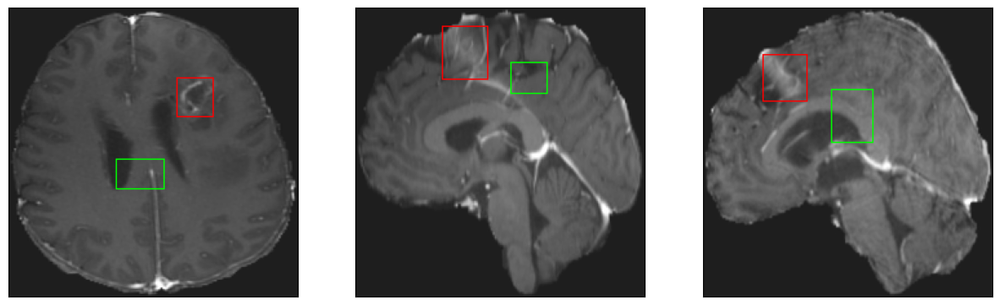

26/26 [==============================] - 3s 110ms/step - loss: 7.5928 - IoU: 0.4677 - val_loss: 12.4167 - val_IoU: 0.3391
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 7.5561 - IoU: 0.4682
Epoch 23: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


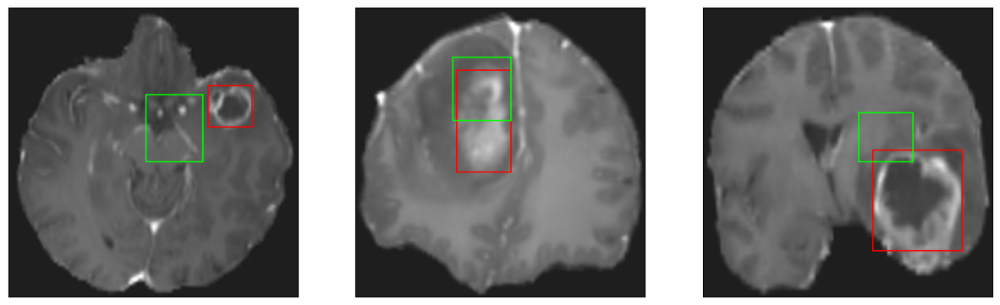

26/26 [==============================] - 3s 105ms/step - loss: 7.5561 - IoU: 0.4682 - val_loss: 13.1621 - val_IoU: 0.3155
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 7.2741 - IoU: 0.4755
Epoch 24: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


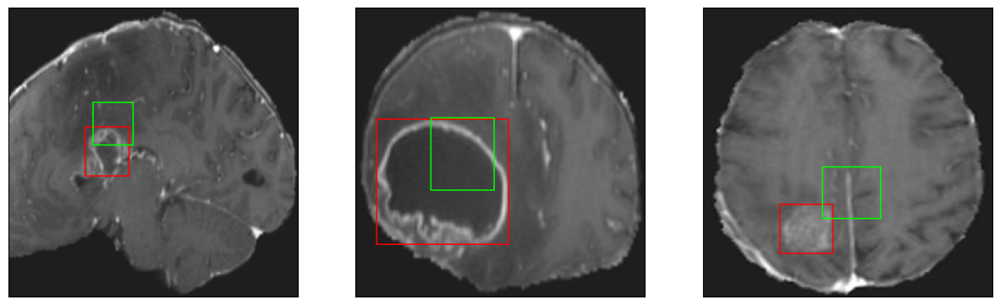

26/26 [==============================] - 3s 99ms/step - loss: 7.2741 - IoU: 0.4755 - val_loss: 14.3334 - val_IoU: 0.2897
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.0549 - IoU: 0.4868
Epoch 25: val_loss did not improve from 11.77170
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


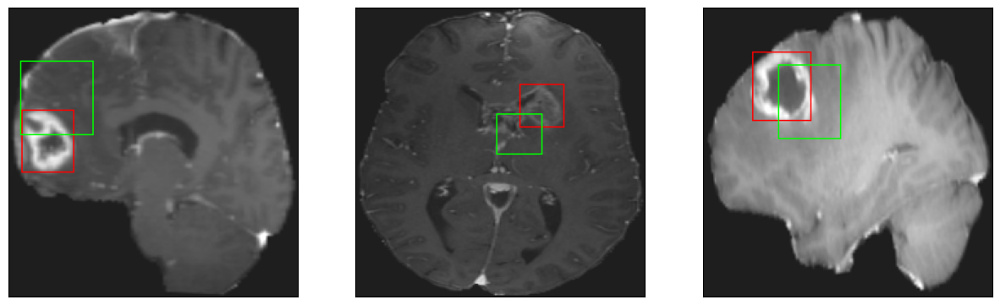

26/26 [==============================] - 3s 114ms/step - loss: 7.0711 - IoU: 0.4851 - val_loss: 13.1455 - val_IoU: 0.3344
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9127 - IoU: 0.4913
Epoch 26: val_loss improved from 11.77170 to 11.28831, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


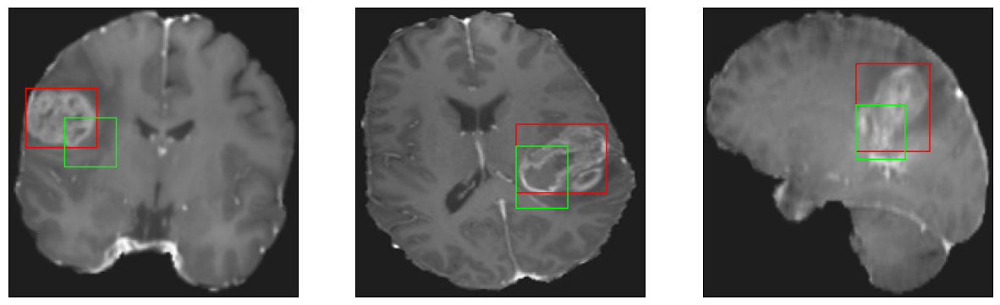

26/26 [==============================] - 4s 146ms/step - loss: 6.9241 - IoU: 0.4906 - val_loss: 11.2883 - val_IoU: 0.3955
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 6.8161 - IoU: 0.5005
Epoch 27: val_loss did not improve from 11.28831
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


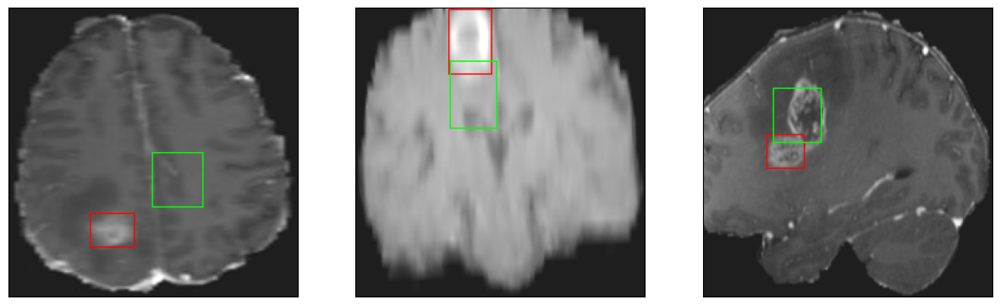

26/26 [==============================] - 3s 96ms/step - loss: 6.8161 - IoU: 0.5005 - val_loss: 12.3842 - val_IoU: 0.3457
Epoch 28/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7681 - IoU: 0.5107
Epoch 28: val_loss did not improve from 11.28831
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


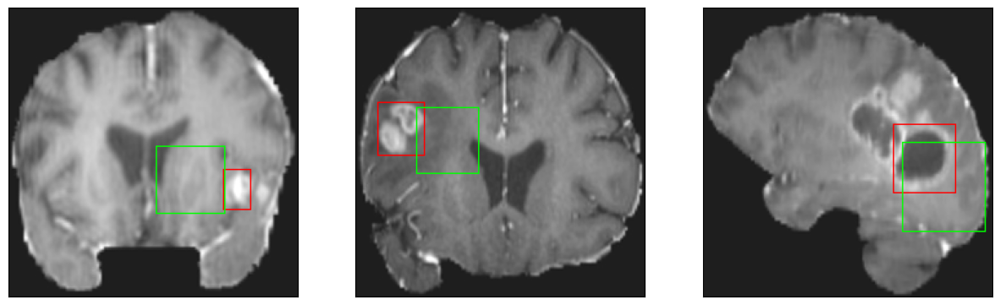

26/26 [==============================] - 3s 101ms/step - loss: 6.7648 - IoU: 0.5097 - val_loss: 12.7714 - val_IoU: 0.3397
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 6.5013 - IoU: 0.5158
Epoch 29: val_loss did not improve from 11.28831
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4


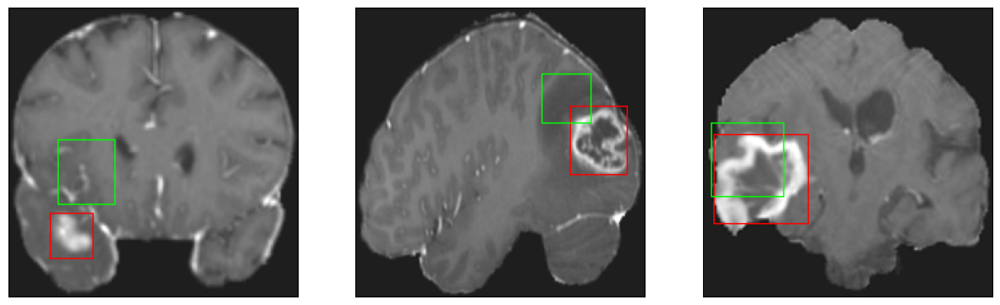

26/26 [==============================] - 4s 150ms/step - loss: 6.5013 - IoU: 0.5158 - val_loss: 14.5217 - val_IoU: 0.2605
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 6.4254 - IoU: 0.5187
Epoch 30: val_loss improved from 11.28831 to 10.99402, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


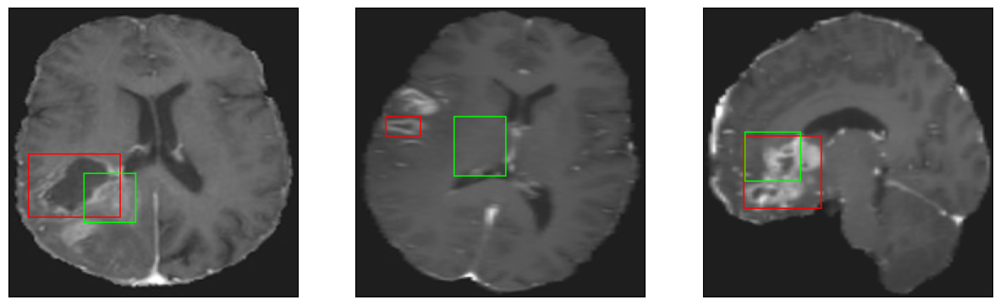

26/26 [==============================] - 4s 170ms/step - loss: 6.4254 - IoU: 0.5187 - val_loss: 10.9940 - val_IoU: 0.3983
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4677 - IoU: 0.5216
Epoch 31: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


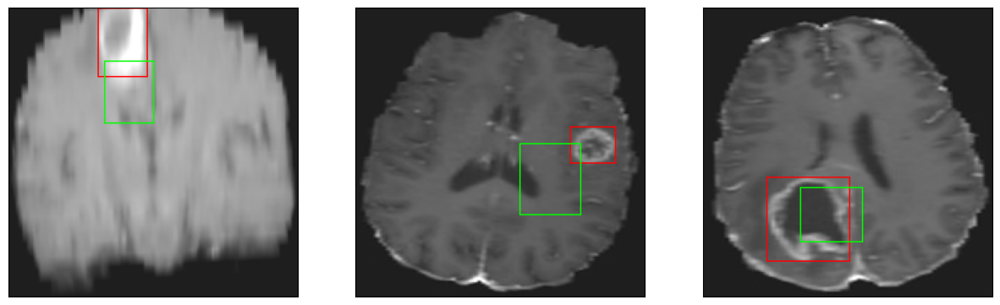

26/26 [==============================] - 3s 99ms/step - loss: 6.4491 - IoU: 0.5234 - val_loss: 12.4628 - val_IoU: 0.3434
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.4102 - IoU: 0.5309
Epoch 32: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


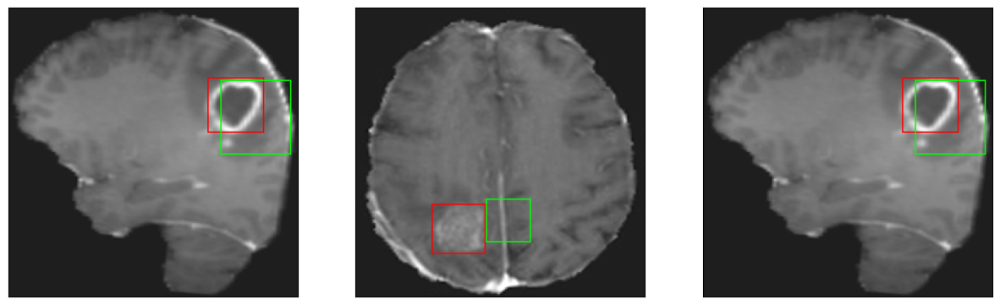

26/26 [==============================] - 3s 107ms/step - loss: 6.4102 - IoU: 0.5309 - val_loss: 11.5371 - val_IoU: 0.3761
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.1818 - IoU: 0.5384
Epoch 33: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


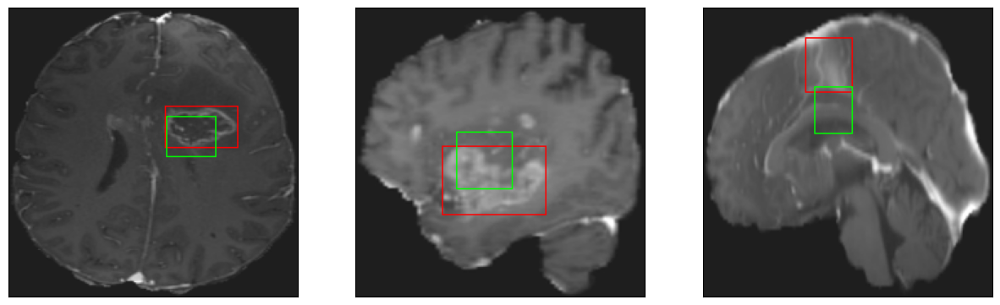

26/26 [==============================] - 3s 114ms/step - loss: 6.1818 - IoU: 0.5384 - val_loss: 12.0658 - val_IoU: 0.3632
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0599 - IoU: 0.5401
Epoch 34: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


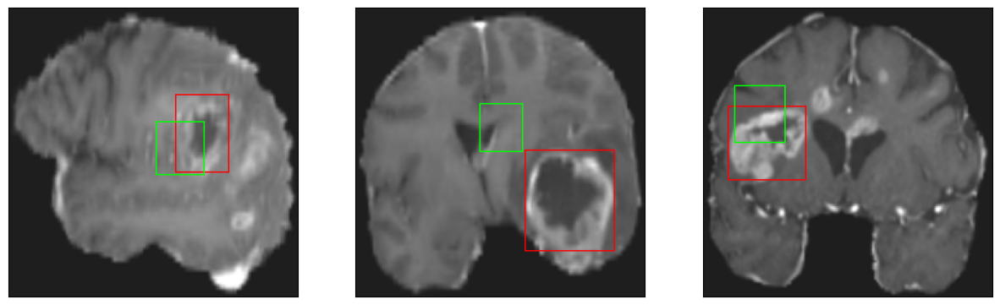

26/26 [==============================] - 3s 117ms/step - loss: 6.0843 - IoU: 0.5378 - val_loss: 17.1757 - val_IoU: 0.1882
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 6.2018 - IoU: 0.5316
Epoch 35: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


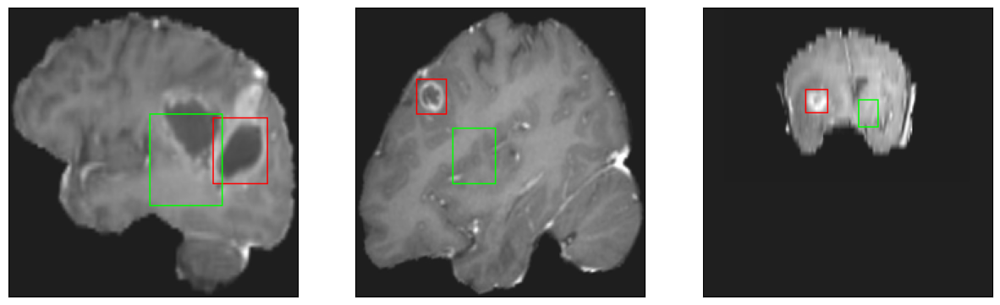

26/26 [==============================] - 2s 96ms/step - loss: 6.2018 - IoU: 0.5316 - val_loss: 11.4883 - val_IoU: 0.3780
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.0864 - IoU: 0.5339
Epoch 36: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


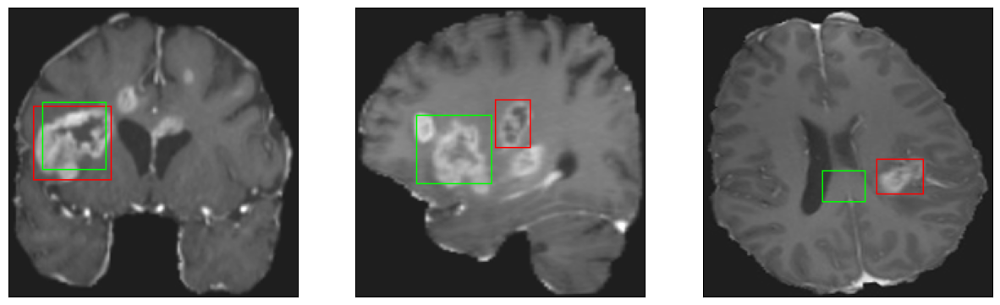

26/26 [==============================] - 3s 105ms/step - loss: 6.0864 - IoU: 0.5339 - val_loss: 11.8732 - val_IoU: 0.3637
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9560 - IoU: 0.5482
Epoch 37: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


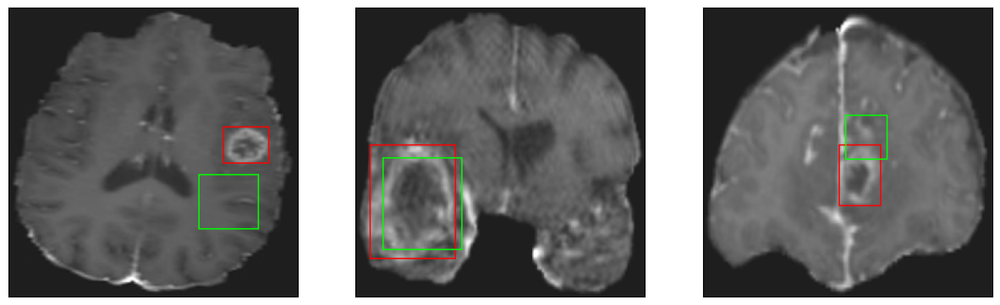

26/26 [==============================] - 3s 106ms/step - loss: 5.9942 - IoU: 0.5458 - val_loss: 12.3617 - val_IoU: 0.3359
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 6.0531 - IoU: 0.5472
Epoch 38: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


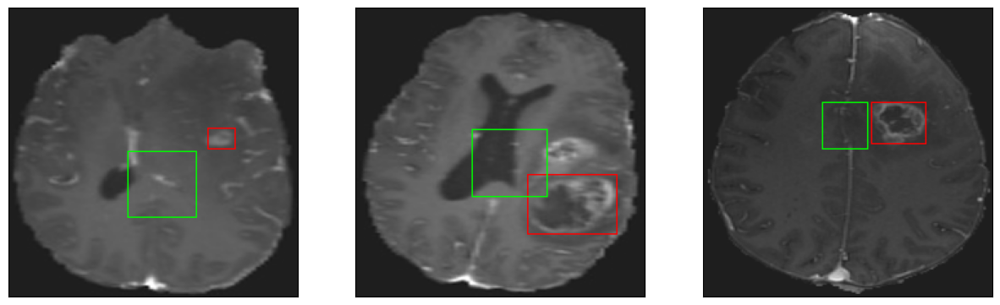

26/26 [==============================] - 4s 141ms/step - loss: 6.0531 - IoU: 0.5472 - val_loss: 11.7594 - val_IoU: 0.3636
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 5.9703 - IoU: 0.5488
Epoch 39: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


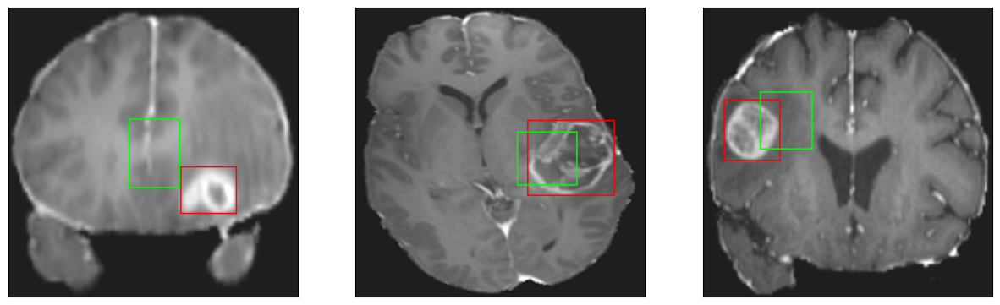

26/26 [==============================] - 3s 118ms/step - loss: 5.9703 - IoU: 0.5488 - val_loss: 11.8492 - val_IoU: 0.3656
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8395 - IoU: 0.5562
Epoch 40: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


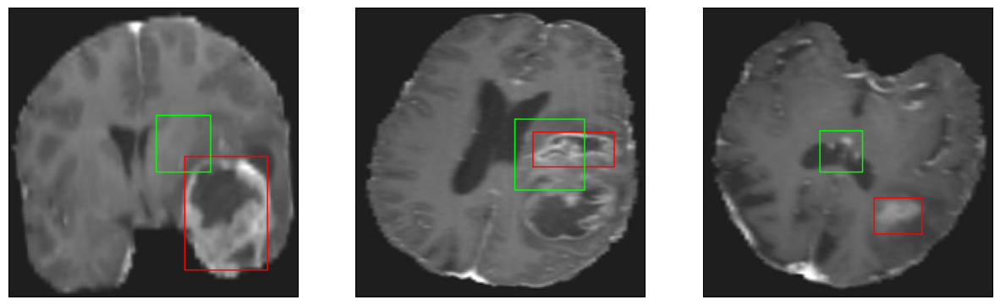

26/26 [==============================] - 3s 105ms/step - loss: 5.8268 - IoU: 0.5555 - val_loss: 11.1965 - val_IoU: 0.3801
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0880 - IoU: 0.5478
Epoch 41: val_loss did not improve from 10.99402
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


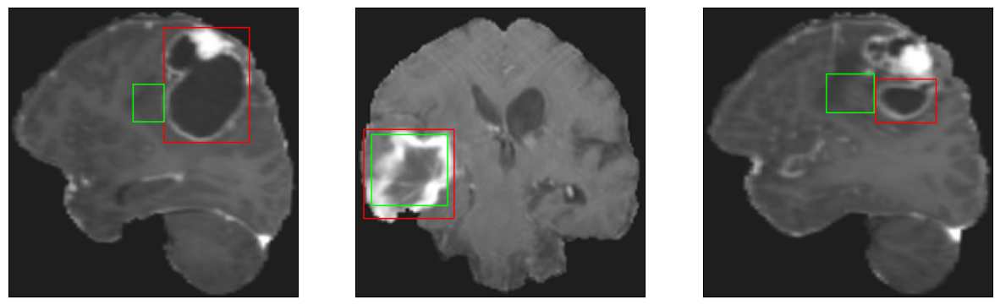

26/26 [==============================] - 3s 104ms/step - loss: 6.0816 - IoU: 0.5447 - val_loss: 11.7516 - val_IoU: 0.3403
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.8967 - IoU: 0.5552
Epoch 42: val_loss improved from 10.99402 to 10.68360, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


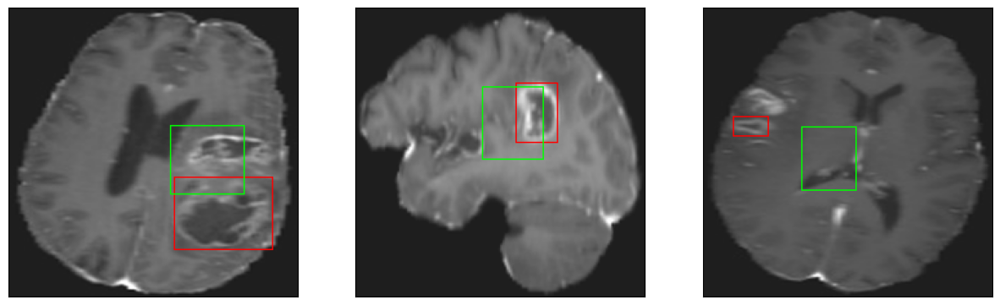

26/26 [==============================] - 4s 171ms/step - loss: 5.8967 - IoU: 0.5552 - val_loss: 10.6836 - val_IoU: 0.3975
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7733 - IoU: 0.5527
Epoch 43: val_loss did not improve from 10.68360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


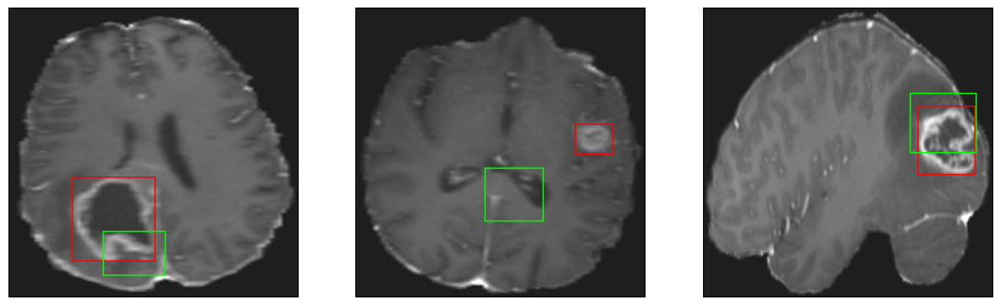

26/26 [==============================] - 3s 99ms/step - loss: 5.7291 - IoU: 0.5560 - val_loss: 11.6418 - val_IoU: 0.3825
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5769 - IoU: 0.5692
Epoch 44: val_loss did not improve from 10.68360
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


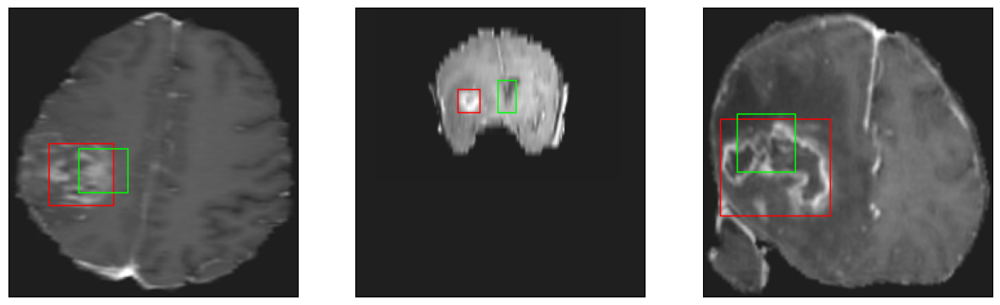

26/26 [==============================] - 3s 113ms/step - loss: 5.5593 - IoU: 0.5700 - val_loss: 11.6502 - val_IoU: 0.3660
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6849 - IoU: 0.5670
Epoch 45: val_loss did not improve from 10.68360
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


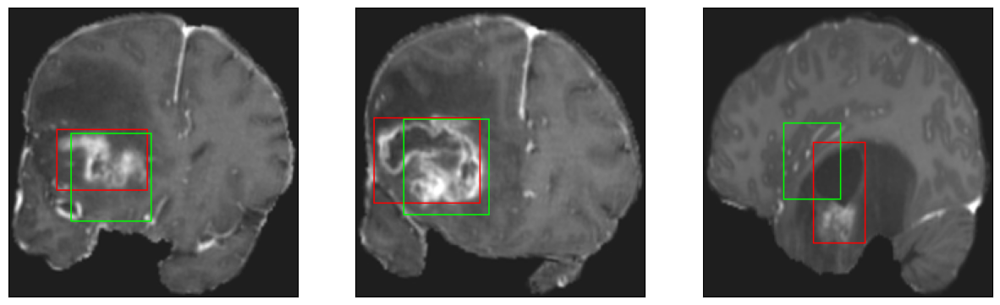

26/26 [==============================] - 3s 125ms/step - loss: 5.7112 - IoU: 0.5628 - val_loss: 12.6769 - val_IoU: 0.3331
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6820 - IoU: 0.5612
Epoch 46: val_loss improved from 10.68360 to 10.67935, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


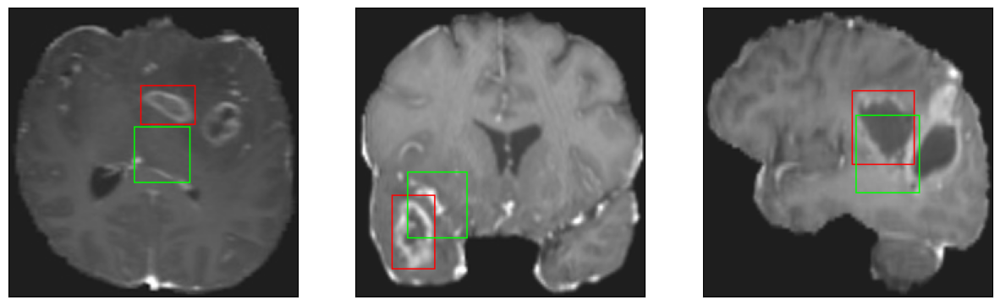

26/26 [==============================] - 4s 155ms/step - loss: 5.7038 - IoU: 0.5586 - val_loss: 10.6794 - val_IoU: 0.4016
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 5.6049 - IoU: 0.5678
Epoch 47: val_loss did not improve from 10.67935
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


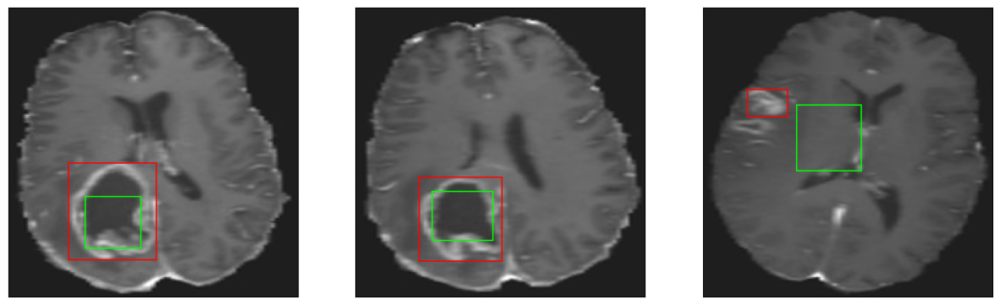

26/26 [==============================] - 3s 111ms/step - loss: 5.6049 - IoU: 0.5678 - val_loss: 11.5487 - val_IoU: 0.3707
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.8244 - IoU: 0.5495
Epoch 48: val_loss did not improve from 10.67935
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


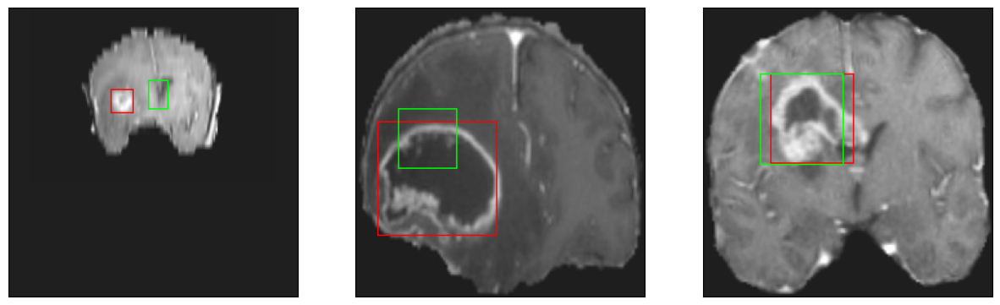

26/26 [==============================] - 3s 118ms/step - loss: 5.8244 - IoU: 0.5495 - val_loss: 11.6491 - val_IoU: 0.3777
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 5.6147 - IoU: 0.5651
Epoch 49: val_loss did not improve from 10.67935
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


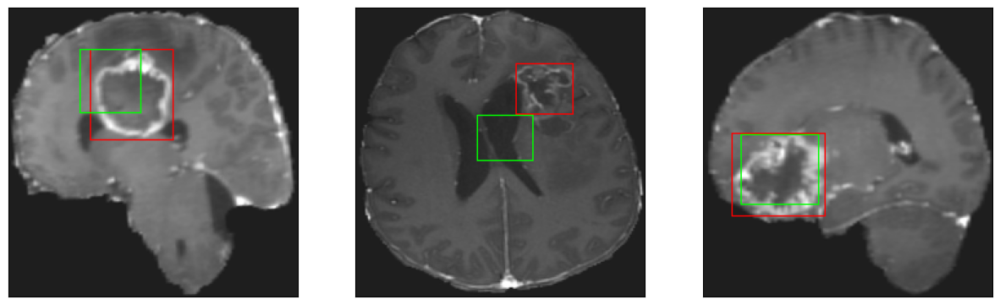

26/26 [==============================] - 3s 133ms/step - loss: 5.6147 - IoU: 0.5651 - val_loss: 11.1009 - val_IoU: 0.3879
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5668 - IoU: 0.5655
Epoch 50: val_loss did not improve from 10.67935
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


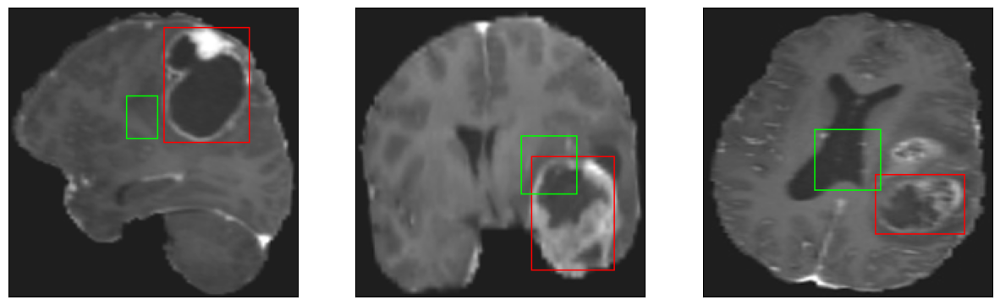

26/26 [==============================] - 3s 110ms/step - loss: 5.5729 - IoU: 0.5665 - val_loss: 10.7392 - val_IoU: 0.3976
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8184 - IoU: 0.5547
Epoch 51: val_loss improved from 10.67935 to 10.57237, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


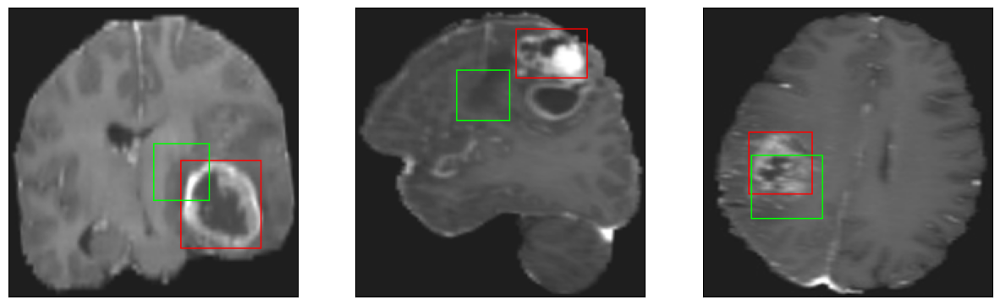

26/26 [==============================] - 4s 143ms/step - loss: 5.7541 - IoU: 0.5578 - val_loss: 10.5724 - val_IoU: 0.4164
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3595 - IoU: 0.5785
Epoch 52: val_loss did not improve from 10.57237
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


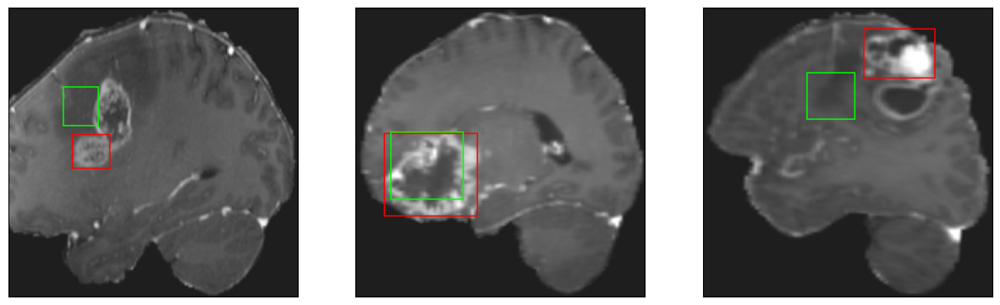

26/26 [==============================] - 3s 132ms/step - loss: 5.4005 - IoU: 0.5774 - val_loss: 11.0649 - val_IoU: 0.3920
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5437 - IoU: 0.5701
Epoch 53: val_loss improved from 10.57237 to 10.42366, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


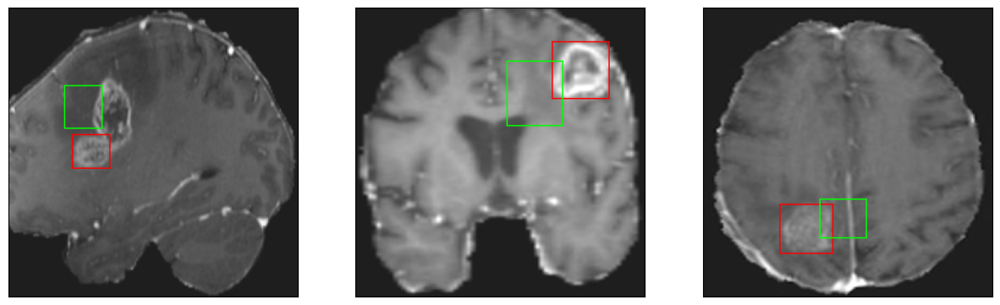

26/26 [==============================] - 4s 139ms/step - loss: 5.5647 - IoU: 0.5694 - val_loss: 10.4237 - val_IoU: 0.4125
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3497 - IoU: 0.5753
Epoch 54: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


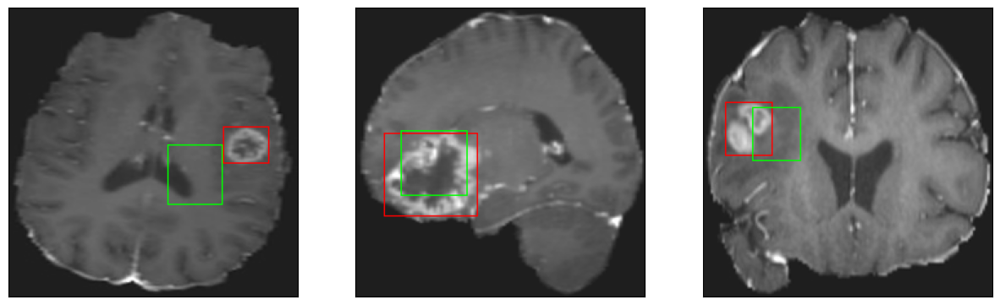

26/26 [==============================] - 3s 106ms/step - loss: 5.3260 - IoU: 0.5777 - val_loss: 10.8900 - val_IoU: 0.3916
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.5225 - IoU: 0.5714
Epoch 55: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


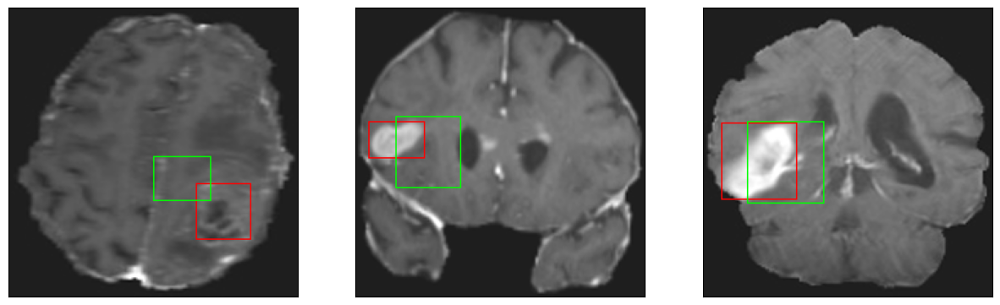

26/26 [==============================] - 3s 109ms/step - loss: 5.5225 - IoU: 0.5714 - val_loss: 10.5433 - val_IoU: 0.4133
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6694 - IoU: 0.5601
Epoch 56: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


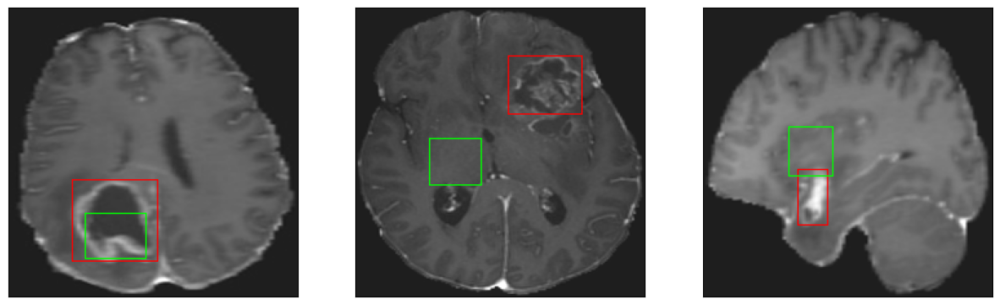

26/26 [==============================] - 3s 128ms/step - loss: 5.6228 - IoU: 0.5627 - val_loss: 10.5703 - val_IoU: 0.4082
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2568 - IoU: 0.5824
Epoch 57: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


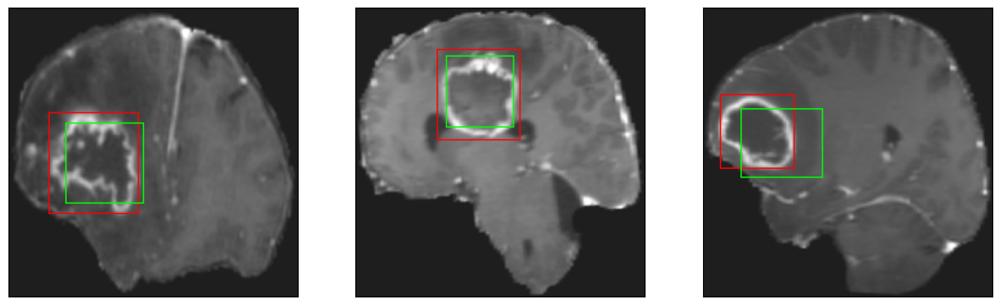

26/26 [==============================] - 3s 129ms/step - loss: 5.2579 - IoU: 0.5830 - val_loss: 12.2155 - val_IoU: 0.3302
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.2959 - IoU: 0.5845
Epoch 58: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


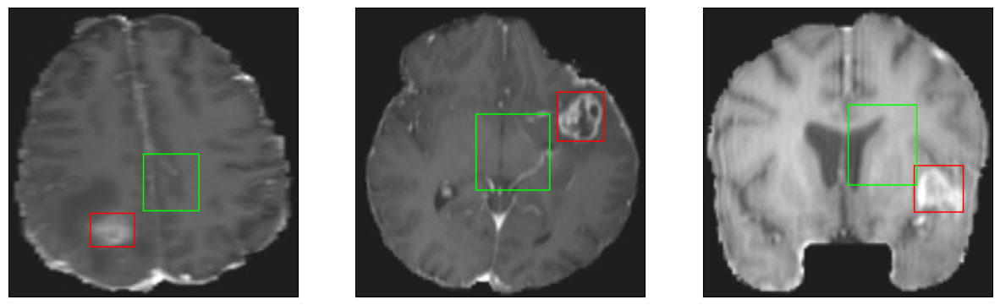

26/26 [==============================] - 3s 106ms/step - loss: 5.2959 - IoU: 0.5845 - val_loss: 12.7127 - val_IoU: 0.3469
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3842 - IoU: 0.5961
Epoch 59: val_loss did not improve from 10.42366
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


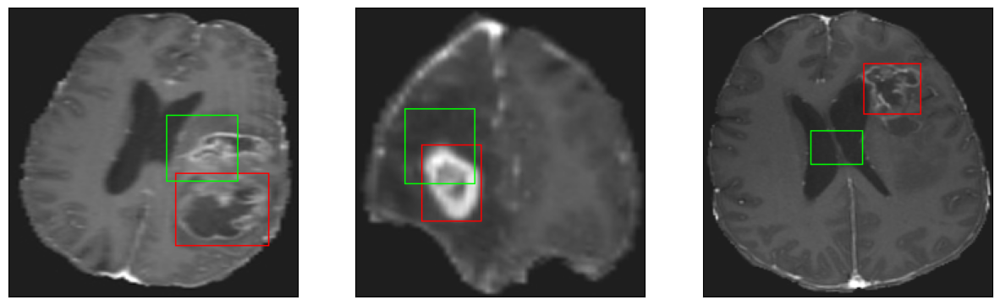

26/26 [==============================] - 3s 108ms/step - loss: 5.4090 - IoU: 0.5950 - val_loss: 11.7315 - val_IoU: 0.3633
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.4447 - IoU: 0.5794
Epoch 60: val_loss improved from 10.42366 to 10.14690, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


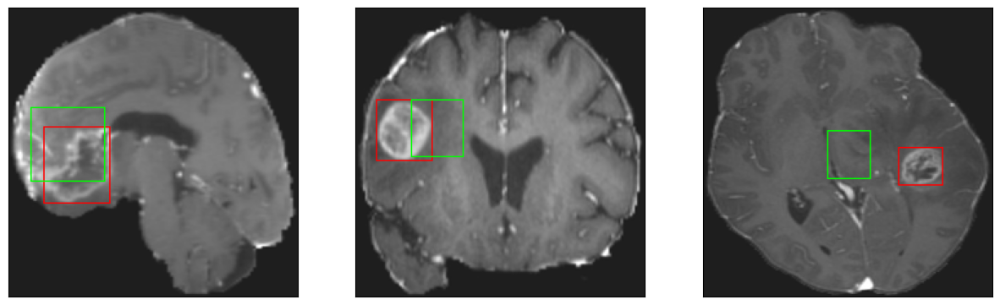

26/26 [==============================] - 4s 173ms/step - loss: 5.4447 - IoU: 0.5794 - val_loss: 10.1469 - val_IoU: 0.4222
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4017 - IoU: 0.5787
Epoch 61: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


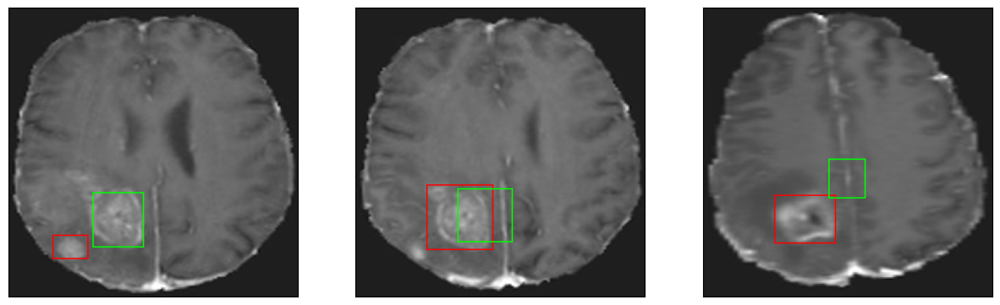

26/26 [==============================] - 3s 134ms/step - loss: 5.3692 - IoU: 0.5817 - val_loss: 10.7639 - val_IoU: 0.4110
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.3408 - IoU: 0.5923
Epoch 62: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


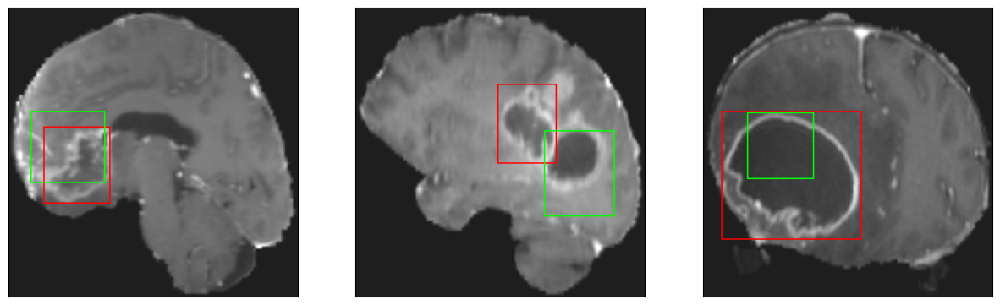

26/26 [==============================] - 3s 120ms/step - loss: 5.3408 - IoU: 0.5923 - val_loss: 10.5848 - val_IoU: 0.3971
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.2955 - IoU: 0.5843
Epoch 63: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


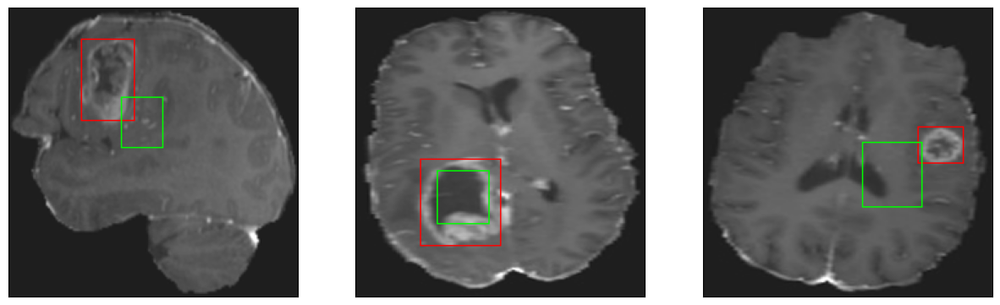

26/26 [==============================] - 3s 116ms/step - loss: 5.2955 - IoU: 0.5843 - val_loss: 10.9152 - val_IoU: 0.3899
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 5.1454 - IoU: 0.5995
Epoch 64: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


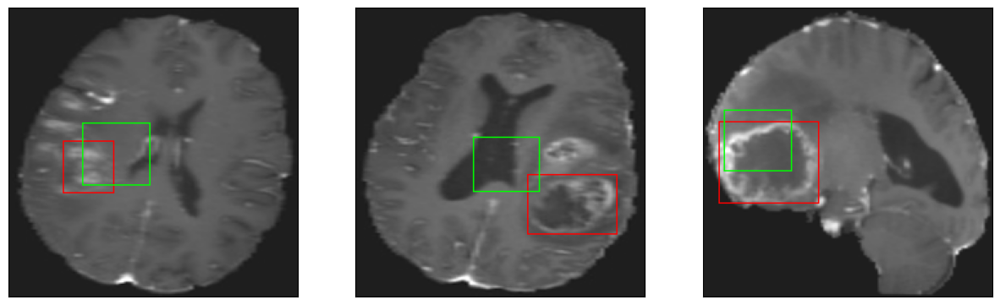

26/26 [==============================] - 3s 127ms/step - loss: 5.1454 - IoU: 0.5995 - val_loss: 10.5752 - val_IoU: 0.4004
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2627 - IoU: 0.5906
Epoch 65: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


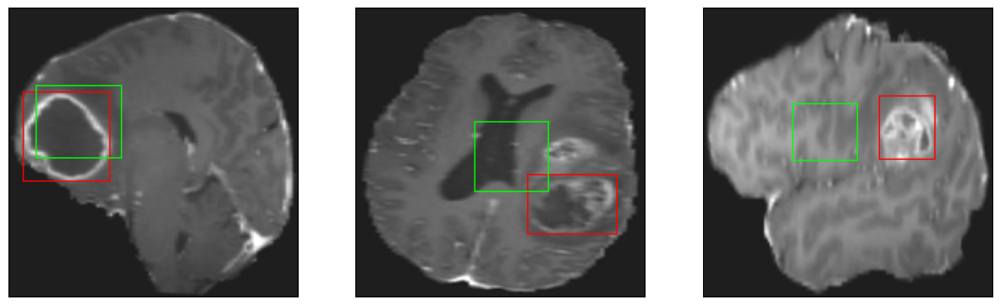

26/26 [==============================] - 3s 133ms/step - loss: 5.1928 - IoU: 0.5945 - val_loss: 10.2360 - val_IoU: 0.4326
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0877 - IoU: 0.6013
Epoch 66: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


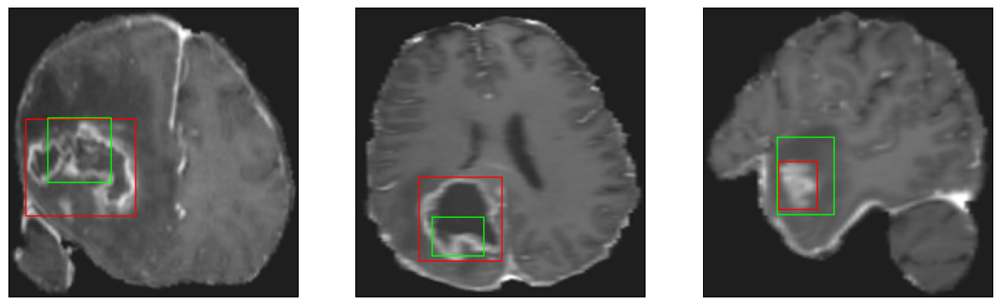

26/26 [==============================] - 3s 109ms/step - loss: 5.0405 - IoU: 0.6039 - val_loss: 10.1976 - val_IoU: 0.4207
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.1243 - IoU: 0.5920
Epoch 67: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


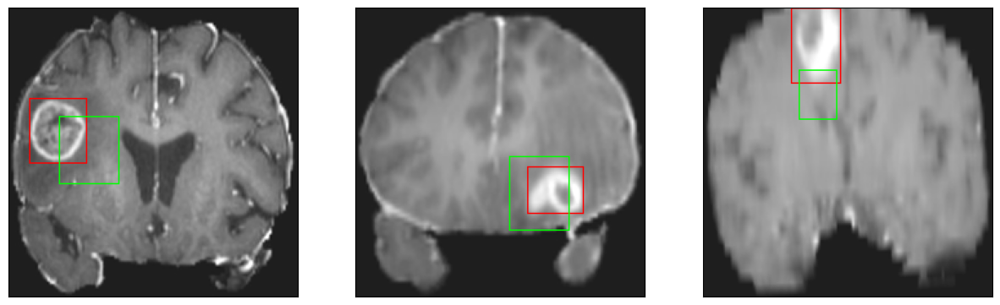

26/26 [==============================] - 3s 102ms/step - loss: 5.1243 - IoU: 0.5920 - val_loss: 11.6106 - val_IoU: 0.4072
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0978 - IoU: 0.5910
Epoch 68: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


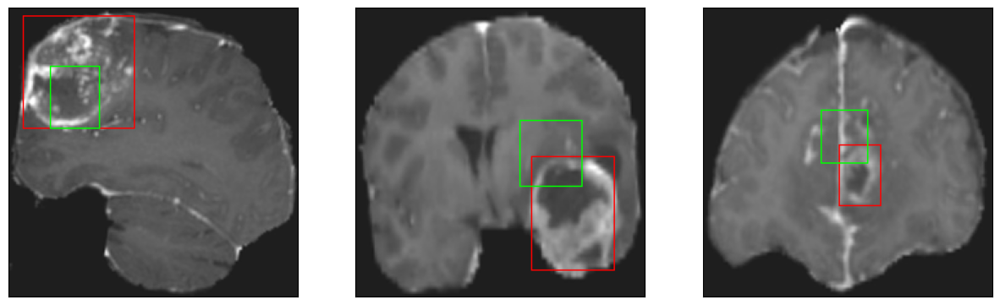

26/26 [==============================] - 3s 111ms/step - loss: 5.0860 - IoU: 0.5906 - val_loss: 10.5492 - val_IoU: 0.4134
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9580 - IoU: 0.6003
Epoch 69: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


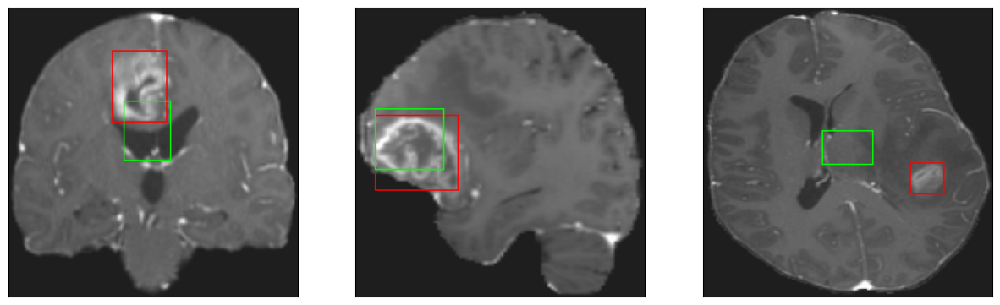

26/26 [==============================] - 3s 126ms/step - loss: 4.9625 - IoU: 0.6000 - val_loss: 11.6395 - val_IoU: 0.3634
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9744 - IoU: 0.6083
Epoch 70: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


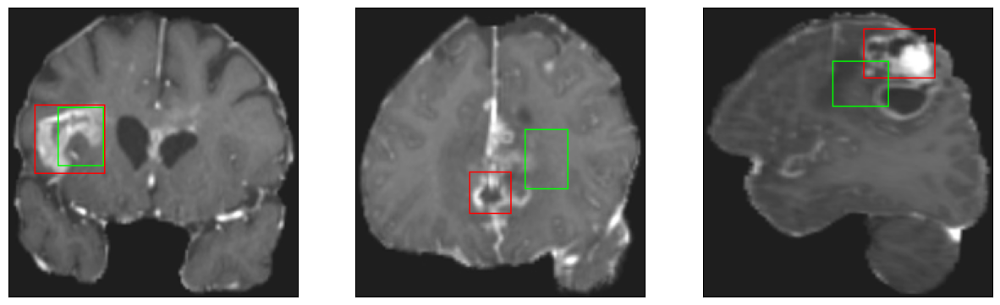

26/26 [==============================] - 3s 112ms/step - loss: 4.9760 - IoU: 0.6084 - val_loss: 10.5084 - val_IoU: 0.4172
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 4.9679 - IoU: 0.6005
Epoch 71: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


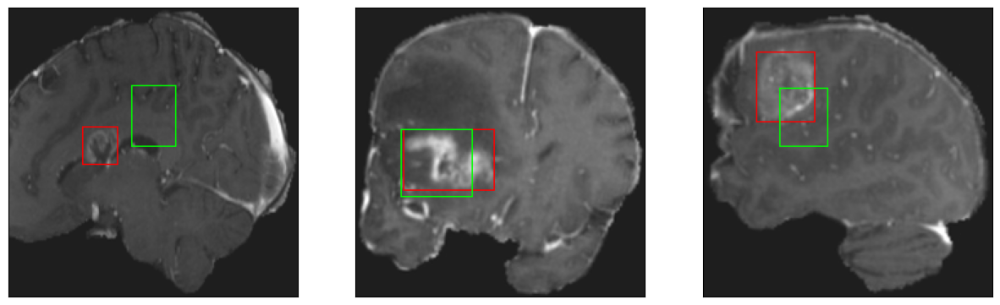

26/26 [==============================] - 3s 112ms/step - loss: 4.9679 - IoU: 0.6005 - val_loss: 10.5589 - val_IoU: 0.4185
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8790 - IoU: 0.6192
Epoch 72: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


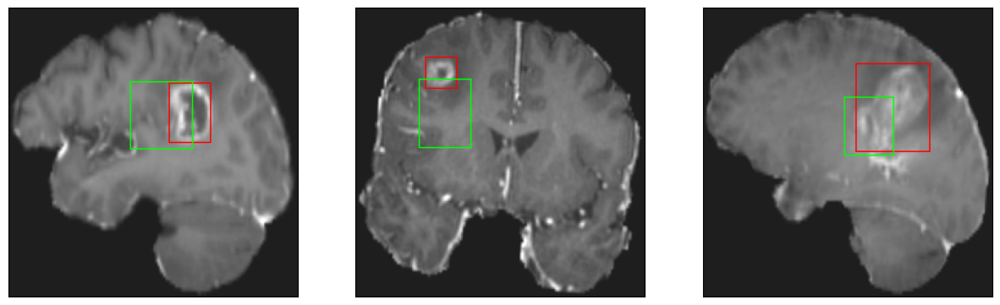

26/26 [==============================] - 3s 127ms/step - loss: 4.8927 - IoU: 0.6173 - val_loss: 10.9059 - val_IoU: 0.4001
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 4.9454 - IoU: 0.6053
Epoch 73: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


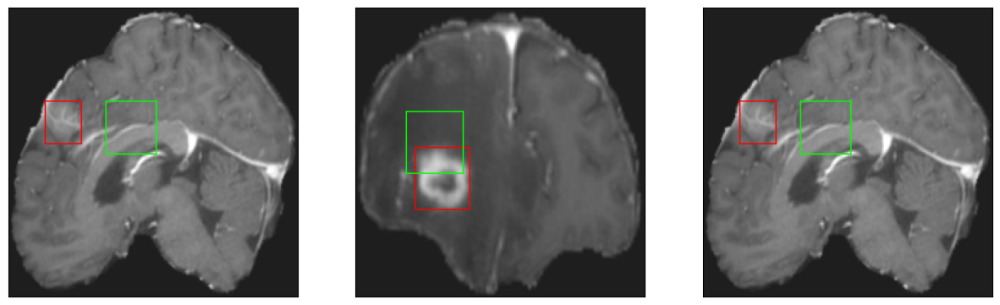

26/26 [==============================] - 4s 137ms/step - loss: 4.9454 - IoU: 0.6053 - val_loss: 10.2287 - val_IoU: 0.4242
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8680 - IoU: 0.6158
Epoch 74: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


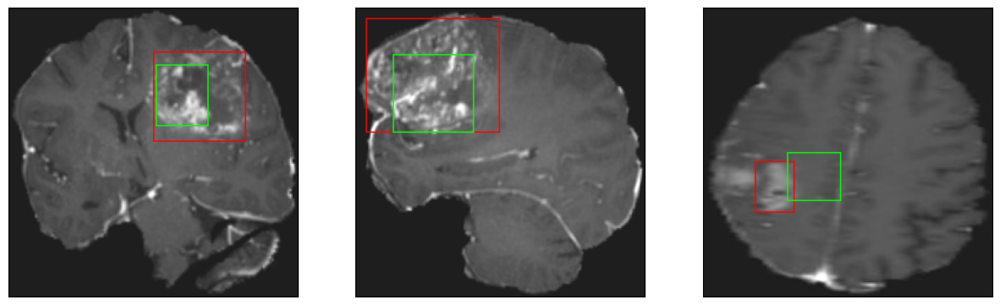

26/26 [==============================] - 3s 112ms/step - loss: 4.8786 - IoU: 0.6172 - val_loss: 10.3020 - val_IoU: 0.4213
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0294 - IoU: 0.6037
Epoch 75: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


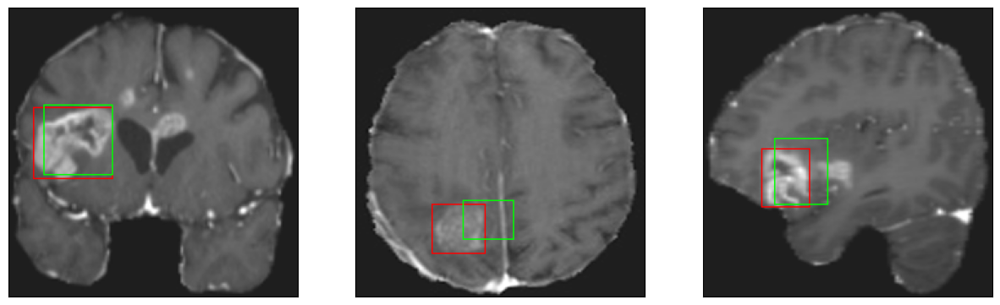

26/26 [==============================] - 3s 106ms/step - loss: 5.0345 - IoU: 0.6040 - val_loss: 10.2967 - val_IoU: 0.4165
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0267 - IoU: 0.6088
Epoch 76: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


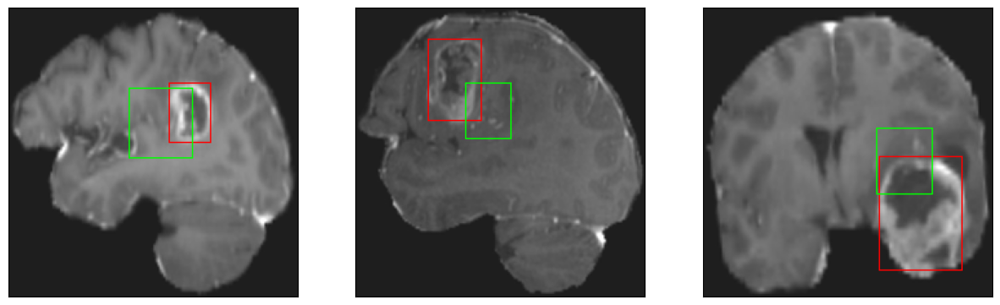

26/26 [==============================] - 3s 131ms/step - loss: 4.9972 - IoU: 0.6092 - val_loss: 10.6649 - val_IoU: 0.4050
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9979 - IoU: 0.6063
Epoch 77: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


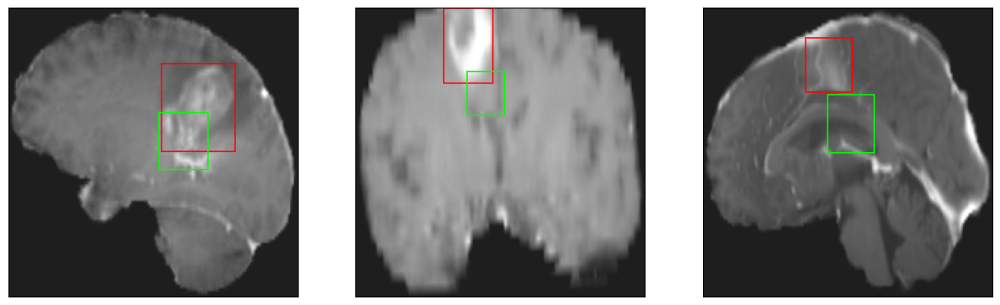

26/26 [==============================] - 3s 102ms/step - loss: 5.0473 - IoU: 0.6058 - val_loss: 10.6284 - val_IoU: 0.4261
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9361 - IoU: 0.6099
Epoch 78: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


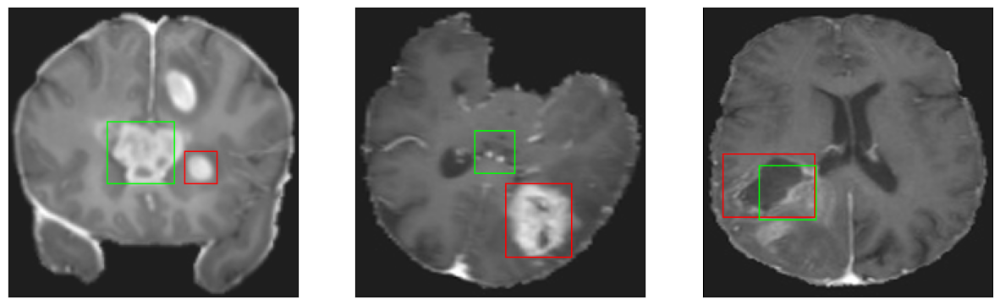

26/26 [==============================] - 3s 104ms/step - loss: 5.0029 - IoU: 0.6069 - val_loss: 11.4124 - val_IoU: 0.3616
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0465 - IoU: 0.5952
Epoch 79: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


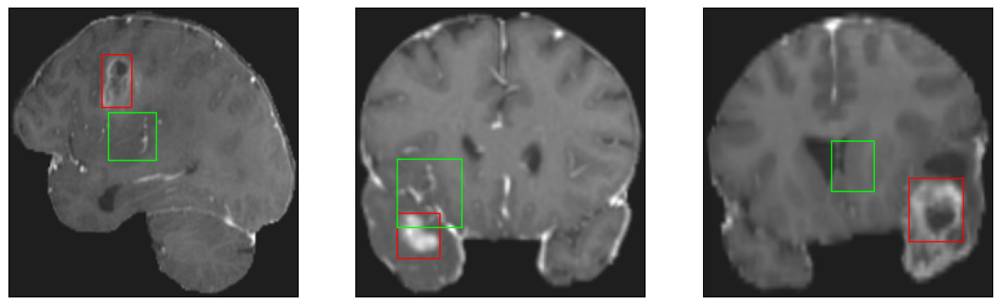

26/26 [==============================] - 3s 103ms/step - loss: 5.0273 - IoU: 0.5951 - val_loss: 10.5218 - val_IoU: 0.3974
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.2187 - IoU: 0.5852
Epoch 80: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


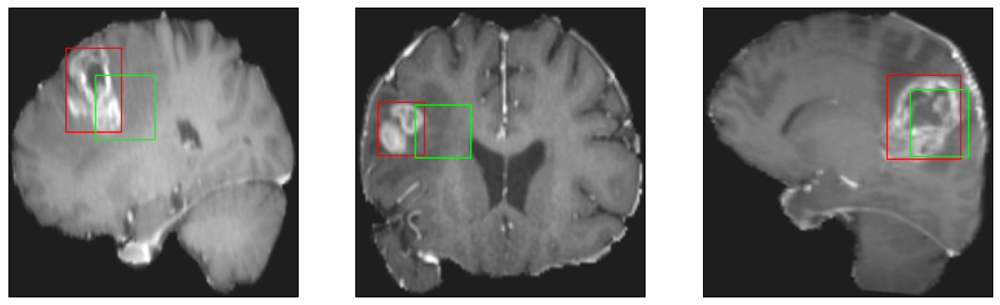

26/26 [==============================] - 4s 138ms/step - loss: 5.2187 - IoU: 0.5852 - val_loss: 11.1367 - val_IoU: 0.3887
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 5.0516 - IoU: 0.6024
Epoch 81: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


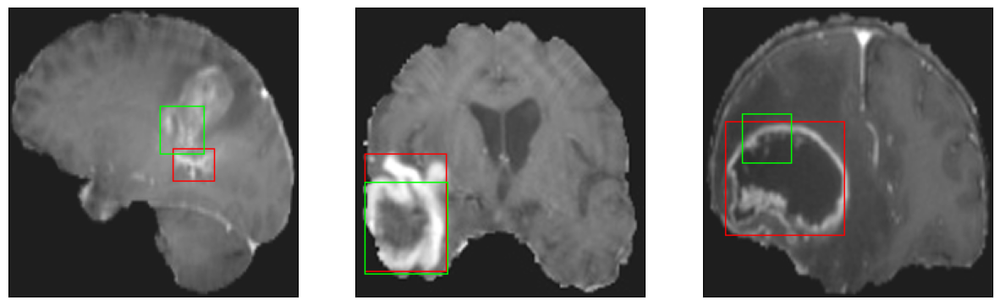

26/26 [==============================] - 3s 129ms/step - loss: 5.0516 - IoU: 0.6024 - val_loss: 10.2278 - val_IoU: 0.4113
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 4.7190 - IoU: 0.6170
Epoch 82: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


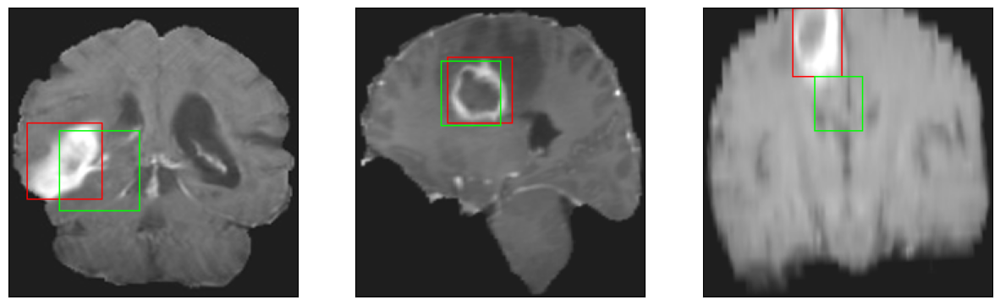

26/26 [==============================] - 3s 119ms/step - loss: 4.7190 - IoU: 0.6170 - val_loss: 10.9239 - val_IoU: 0.3897
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8003 - IoU: 0.6218
Epoch 83: val_loss did not improve from 10.14690
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


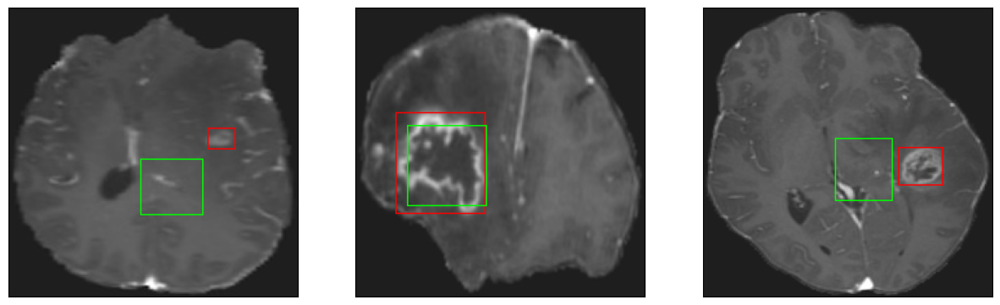

26/26 [==============================] - 3s 108ms/step - loss: 4.8009 - IoU: 0.6215 - val_loss: 12.2455 - val_IoU: 0.3527
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8410 - IoU: 0.6095
Epoch 84: val_loss improved from 10.14690 to 10.13476, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


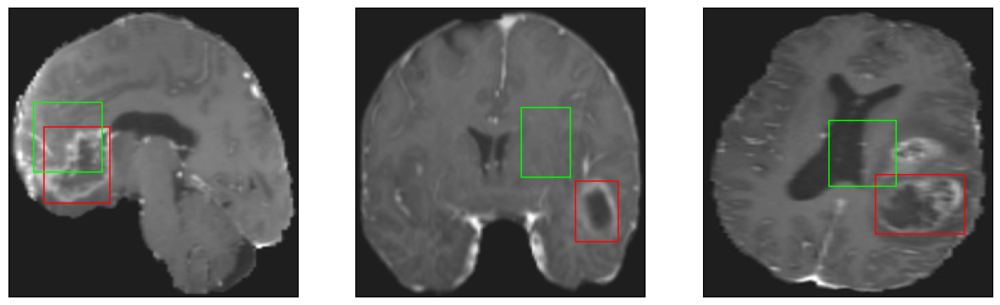

26/26 [==============================] - 4s 157ms/step - loss: 4.8971 - IoU: 0.6082 - val_loss: 10.1348 - val_IoU: 0.4370
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7521 - IoU: 0.6257
Epoch 85: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


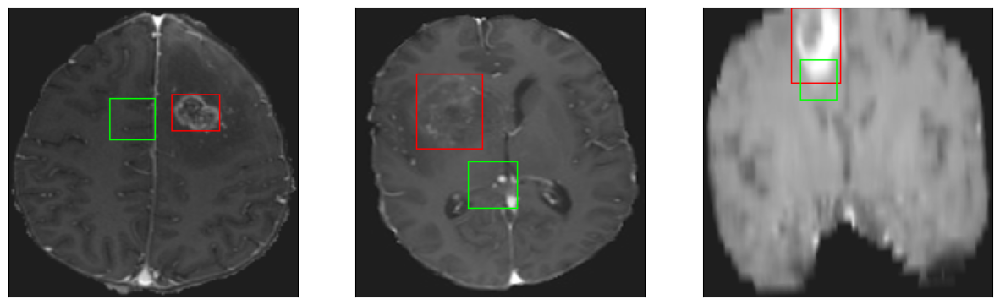

26/26 [==============================] - 3s 125ms/step - loss: 4.7445 - IoU: 0.6243 - val_loss: 10.6619 - val_IoU: 0.4046
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 4.9777 - IoU: 0.6162
Epoch 86: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


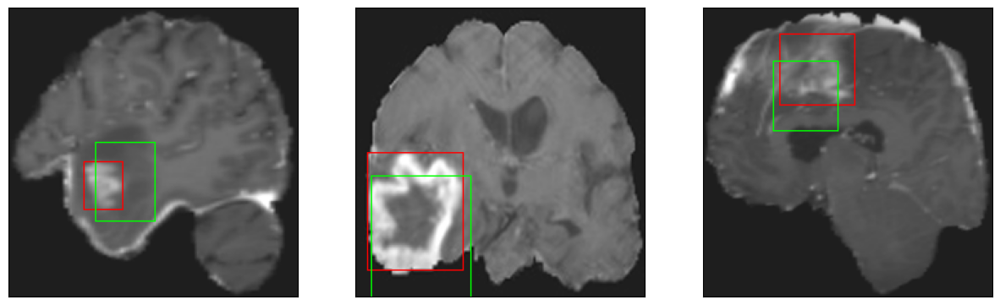

26/26 [==============================] - 3s 105ms/step - loss: 4.9777 - IoU: 0.6162 - val_loss: 10.3760 - val_IoU: 0.4273
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0104 - IoU: 0.6128
Epoch 87: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


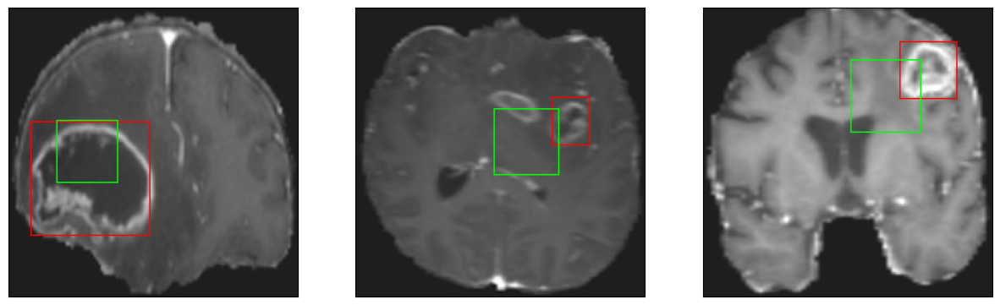

26/26 [==============================] - 3s 118ms/step - loss: 4.9832 - IoU: 0.6130 - val_loss: 11.3845 - val_IoU: 0.3823
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.8097 - IoU: 0.6257
Epoch 88: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


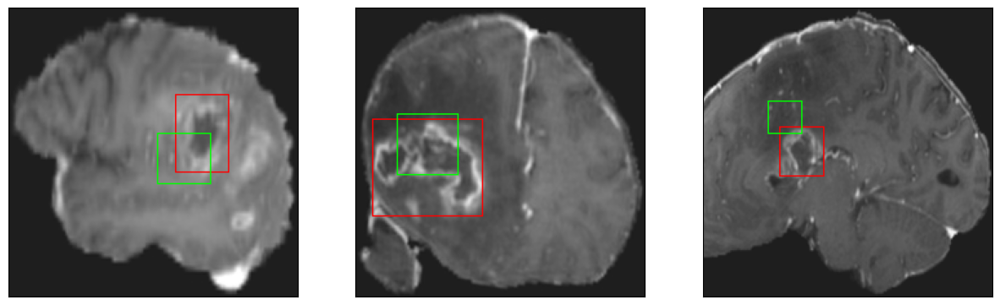

26/26 [==============================] - 2s 95ms/step - loss: 4.8097 - IoU: 0.6257 - val_loss: 10.3876 - val_IoU: 0.4153
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7804 - IoU: 0.6227
Epoch 89: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


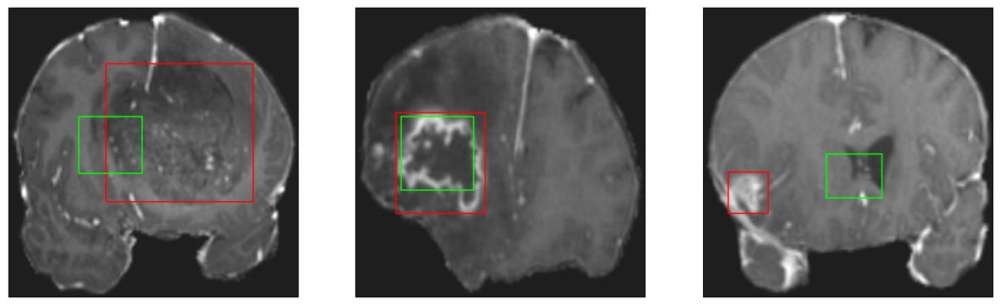

26/26 [==============================] - 3s 133ms/step - loss: 4.8129 - IoU: 0.6219 - val_loss: 10.1636 - val_IoU: 0.4421
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6928 - IoU: 0.6297
Epoch 90: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


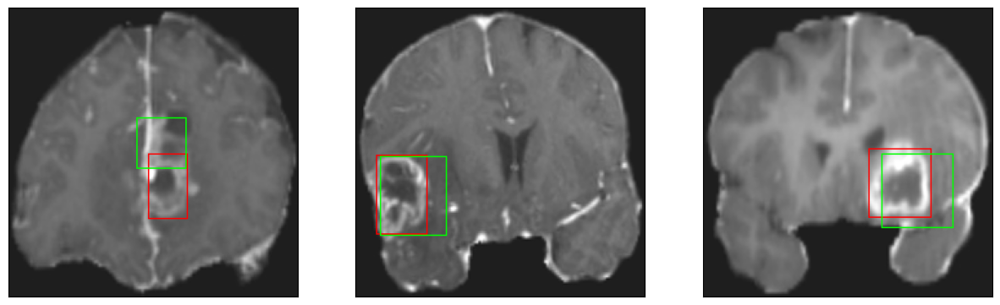

26/26 [==============================] - 3s 120ms/step - loss: 4.6908 - IoU: 0.6294 - val_loss: 10.5024 - val_IoU: 0.4152
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6902 - IoU: 0.6208
Epoch 91: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


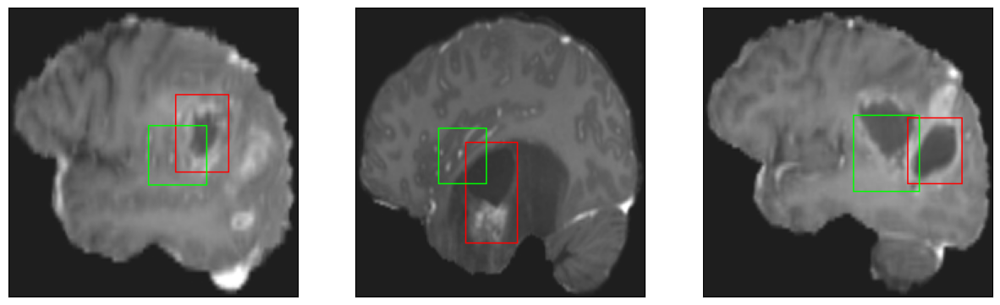

26/26 [==============================] - 3s 114ms/step - loss: 4.6850 - IoU: 0.6205 - val_loss: 10.1622 - val_IoU: 0.4314
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7846 - IoU: 0.6292
Epoch 92: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


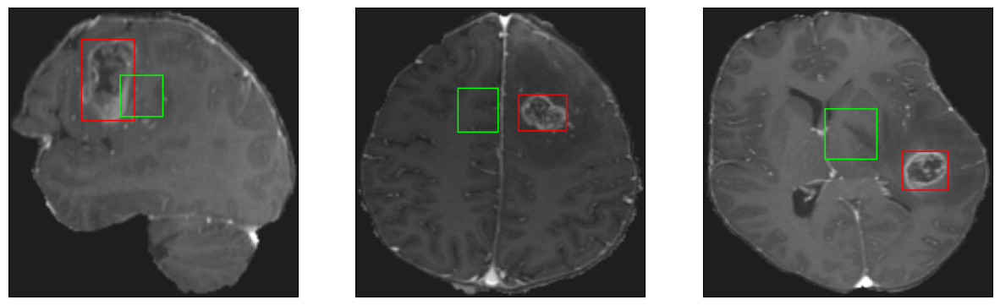

26/26 [==============================] - 3s 102ms/step - loss: 4.7702 - IoU: 0.6275 - val_loss: 10.8266 - val_IoU: 0.4022
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5957 - IoU: 0.6346
Epoch 93: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


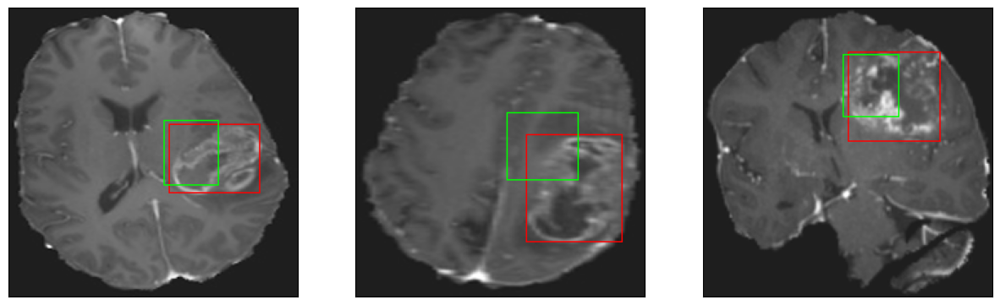

26/26 [==============================] - 3s 111ms/step - loss: 4.7242 - IoU: 0.6285 - val_loss: 11.0904 - val_IoU: 0.3796
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.8997 - IoU: 0.6116
Epoch 94: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


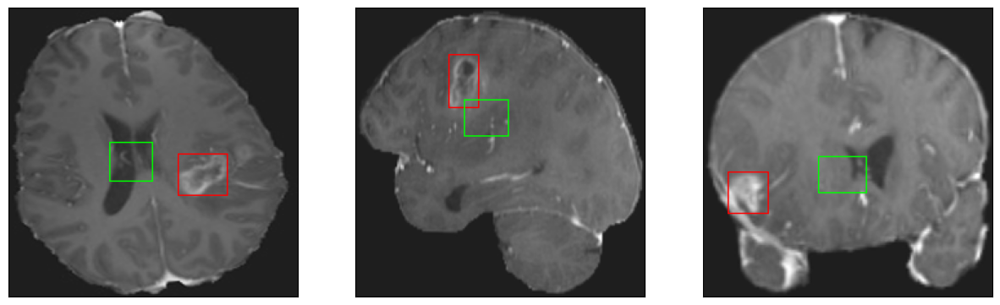

26/26 [==============================] - 3s 106ms/step - loss: 4.8997 - IoU: 0.6116 - val_loss: 10.5725 - val_IoU: 0.4148
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7073 - IoU: 0.6272
Epoch 95: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


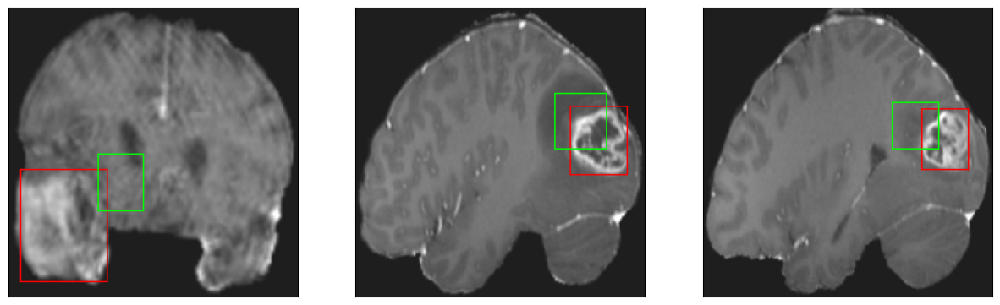

26/26 [==============================] - 3s 105ms/step - loss: 4.7054 - IoU: 0.6277 - val_loss: 10.3237 - val_IoU: 0.4003
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.5397 - IoU: 0.6356
Epoch 96: val_loss did not improve from 10.13476
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 11ms/step
4


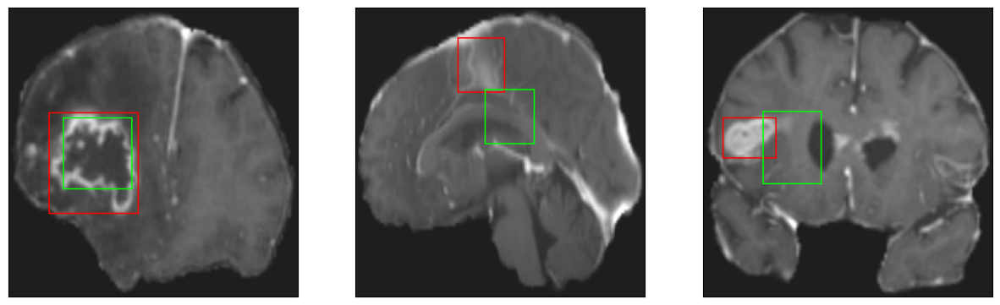

26/26 [==============================] - 3s 112ms/step - loss: 4.5397 - IoU: 0.6356 - val_loss: 11.1210 - val_IoU: 0.3850
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.5556 - IoU: 0.6308
Epoch 97: val_loss improved from 10.13476 to 10.06375, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


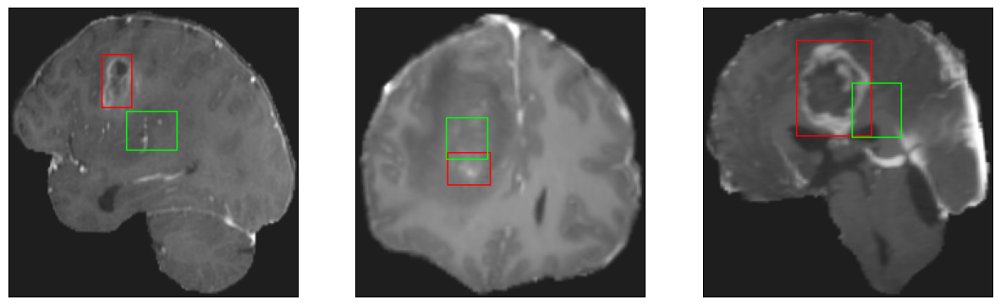

26/26 [==============================] - 4s 159ms/step - loss: 4.5556 - IoU: 0.6308 - val_loss: 10.0637 - val_IoU: 0.4228
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.8017 - IoU: 0.6211
Epoch 98: val_loss did not improve from 10.06375
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


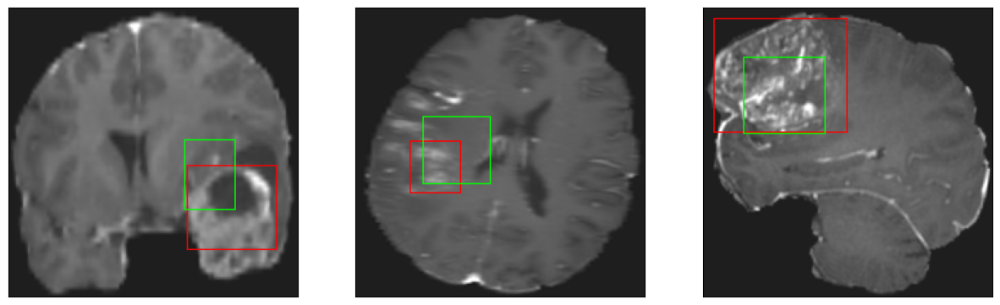

26/26 [==============================] - 3s 107ms/step - loss: 4.8017 - IoU: 0.6211 - val_loss: 11.9292 - val_IoU: 0.3465
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.6047 - IoU: 0.6315
Epoch 99: val_loss improved from 10.06375 to 10.05271, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


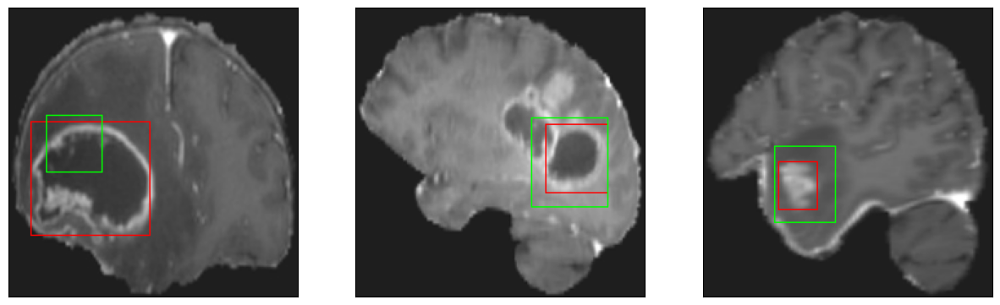

26/26 [==============================] - 3s 123ms/step - loss: 4.6047 - IoU: 0.6315 - val_loss: 10.0527 - val_IoU: 0.4444
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 4.8095 - IoU: 0.6112
Epoch 100: val_loss improved from 10.05271 to 9.94636, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


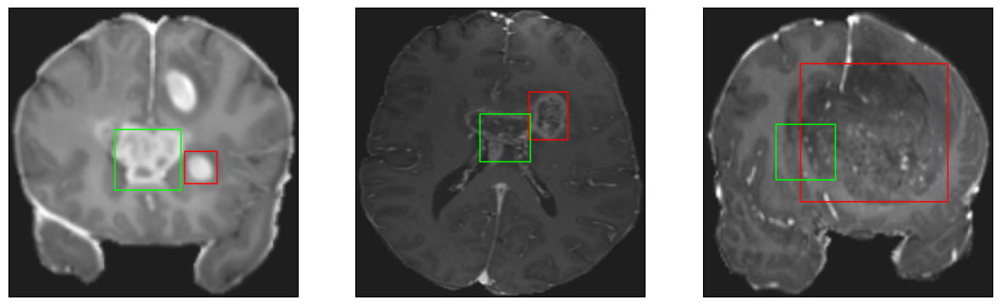

26/26 [==============================] - 4s 169ms/step - loss: 4.8095 - IoU: 0.6112 - val_loss: 9.9464 - val_IoU: 0.4346
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7289 - IoU: 0.6203
Epoch 101: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


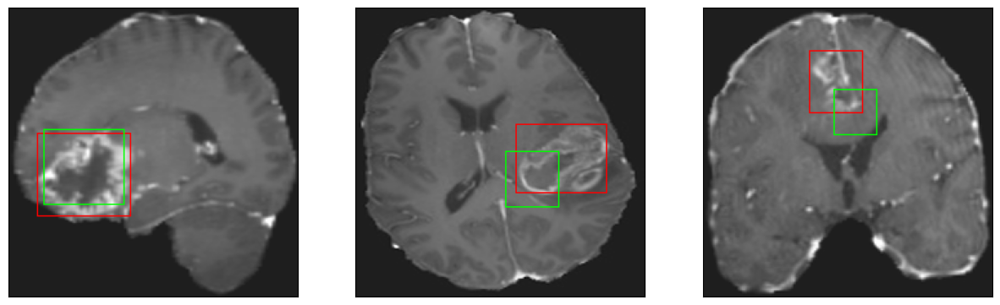

26/26 [==============================] - 3s 101ms/step - loss: 4.7229 - IoU: 0.6215 - val_loss: 10.6673 - val_IoU: 0.4064
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5475 - IoU: 0.6353
Epoch 102: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


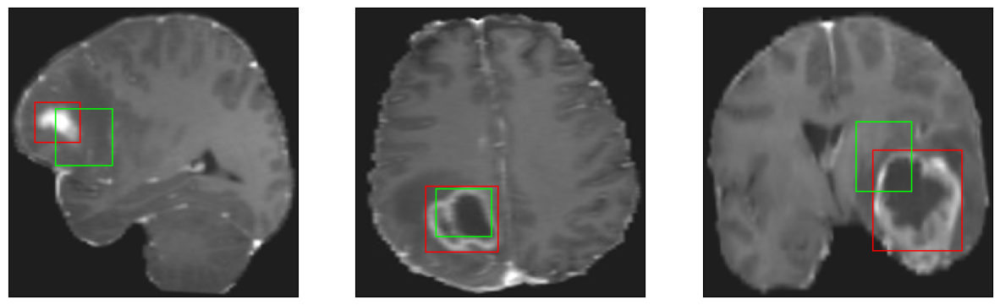

26/26 [==============================] - 3s 115ms/step - loss: 4.5228 - IoU: 0.6370 - val_loss: 10.3490 - val_IoU: 0.4205
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.4642 - IoU: 0.6426
Epoch 103: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


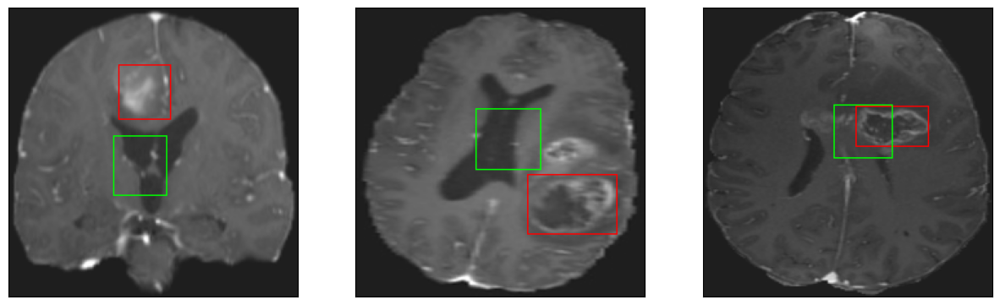

26/26 [==============================] - 3s 108ms/step - loss: 4.4642 - IoU: 0.6426 - val_loss: 11.1772 - val_IoU: 0.3776
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4206 - IoU: 0.6420
Epoch 104: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


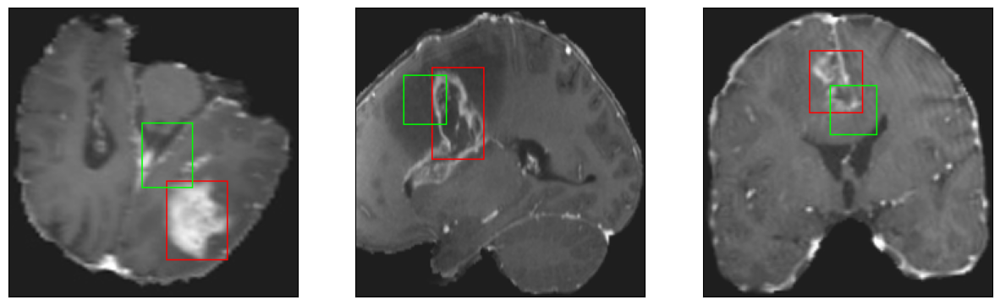

26/26 [==============================] - 4s 140ms/step - loss: 4.4111 - IoU: 0.6428 - val_loss: 10.1785 - val_IoU: 0.4318
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 4.4653 - IoU: 0.6422
Epoch 105: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


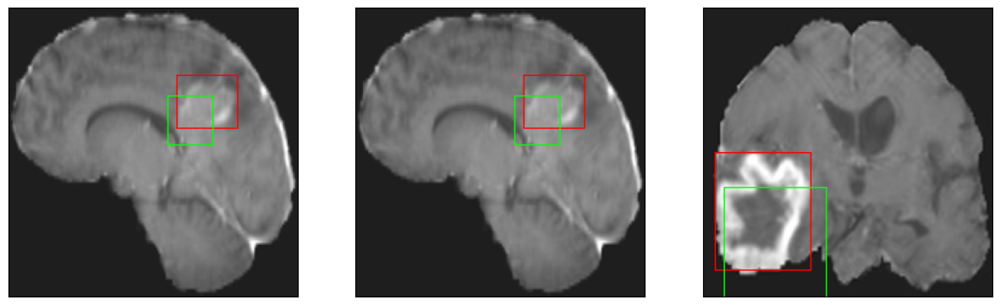

26/26 [==============================] - 3s 120ms/step - loss: 4.4653 - IoU: 0.6422 - val_loss: 10.3219 - val_IoU: 0.4125
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5066 - IoU: 0.6402
Epoch 106: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


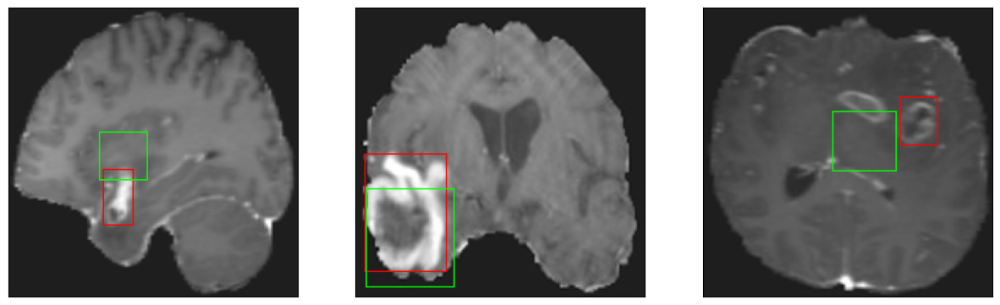

26/26 [==============================] - 3s 107ms/step - loss: 4.4870 - IoU: 0.6412 - val_loss: 9.9739 - val_IoU: 0.4403
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.4760 - IoU: 0.6360
Epoch 107: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


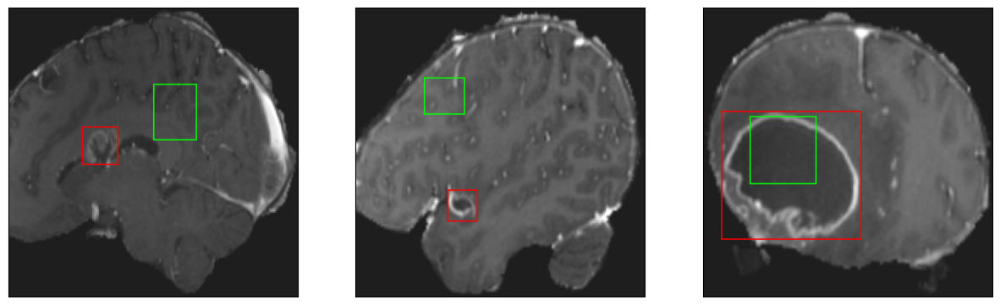

26/26 [==============================] - 3s 125ms/step - loss: 4.4760 - IoU: 0.6360 - val_loss: 10.2384 - val_IoU: 0.4383
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.3928 - IoU: 0.6409
Epoch 108: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


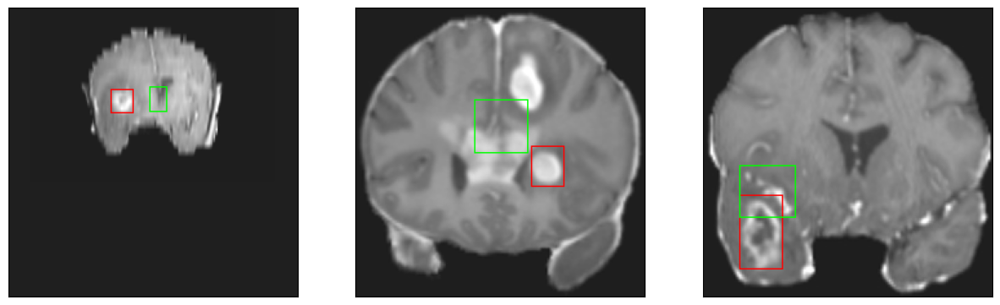

26/26 [==============================] - 3s 132ms/step - loss: 4.3928 - IoU: 0.6409 - val_loss: 10.1539 - val_IoU: 0.4241
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3457 - IoU: 0.6458
Epoch 109: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


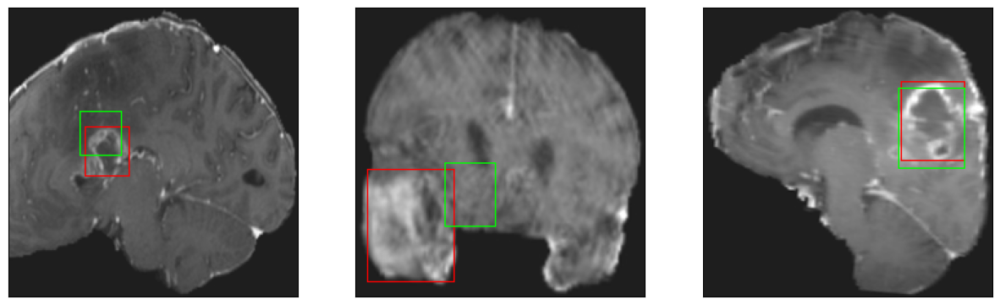

26/26 [==============================] - 2s 95ms/step - loss: 4.3998 - IoU: 0.6441 - val_loss: 11.0660 - val_IoU: 0.4003
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4760 - IoU: 0.6357
Epoch 110: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


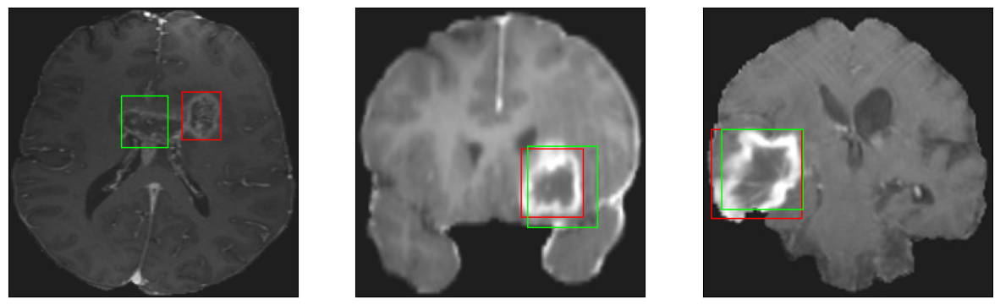

26/26 [==============================] - 3s 100ms/step - loss: 4.4937 - IoU: 0.6343 - val_loss: 10.0742 - val_IoU: 0.4311
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5085 - IoU: 0.6353
Epoch 111: val_loss did not improve from 9.94636
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


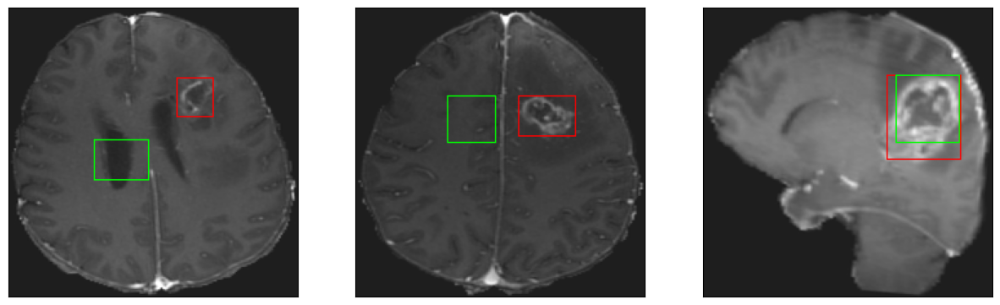

26/26 [==============================] - 3s 122ms/step - loss: 4.5678 - IoU: 0.6314 - val_loss: 10.5657 - val_IoU: 0.4136
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5179 - IoU: 0.6384
Epoch 112: val_loss improved from 9.94636 to 9.89172, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4


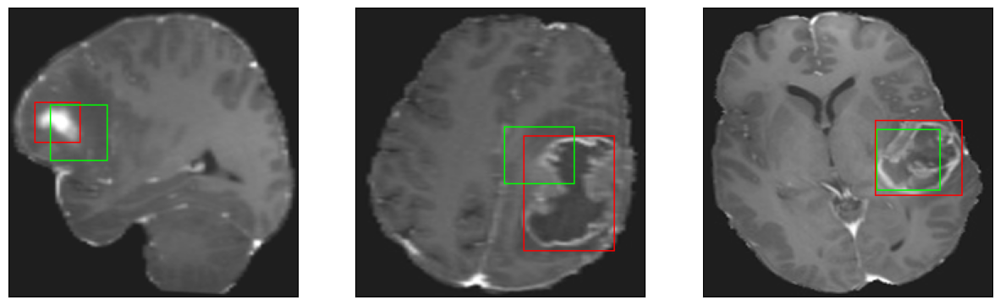

26/26 [==============================] - 5s 189ms/step - loss: 4.5248 - IoU: 0.6370 - val_loss: 9.8917 - val_IoU: 0.4240
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.3382 - IoU: 0.6499
Epoch 113: val_loss did not improve from 9.89172
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


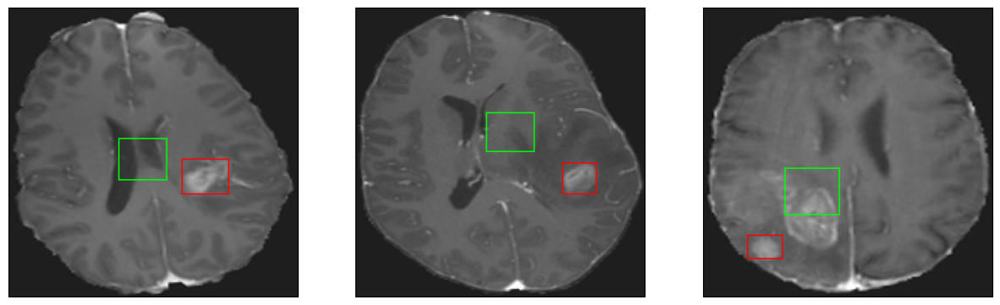

26/26 [==============================] - 3s 102ms/step - loss: 4.3382 - IoU: 0.6499 - val_loss: 11.2638 - val_IoU: 0.3870
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.4769 - IoU: 0.6423
Epoch 114: val_loss improved from 9.89172 to 9.83280, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


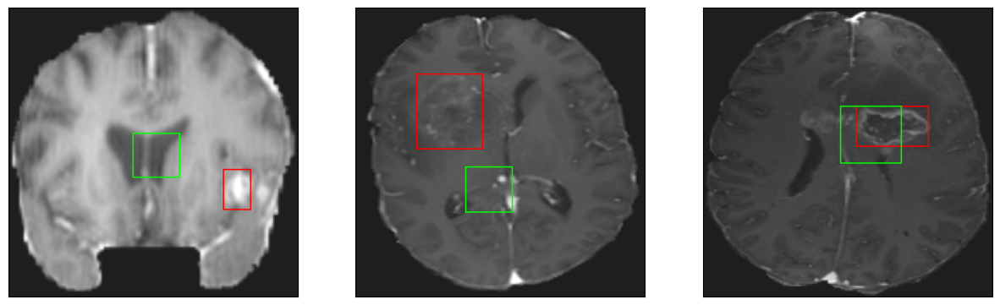

26/26 [==============================] - 3s 121ms/step - loss: 4.4769 - IoU: 0.6423 - val_loss: 9.8328 - val_IoU: 0.4392
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4275 - IoU: 0.6435
Epoch 115: val_loss did not improve from 9.83280
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


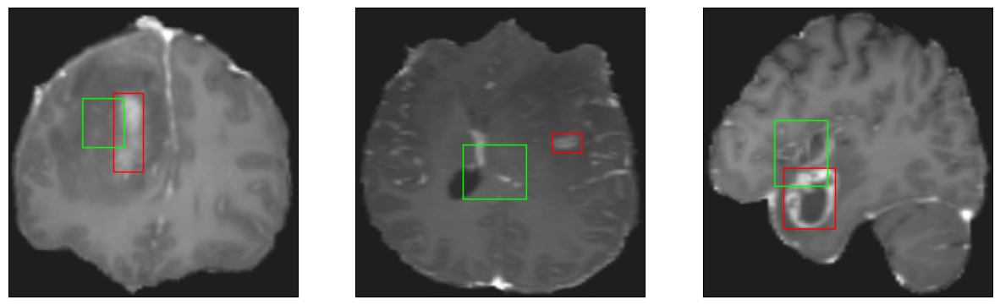

26/26 [==============================] - 4s 136ms/step - loss: 4.4012 - IoU: 0.6436 - val_loss: 10.4047 - val_IoU: 0.4197
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6586 - IoU: 0.6257
Epoch 116: val_loss did not improve from 9.83280
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


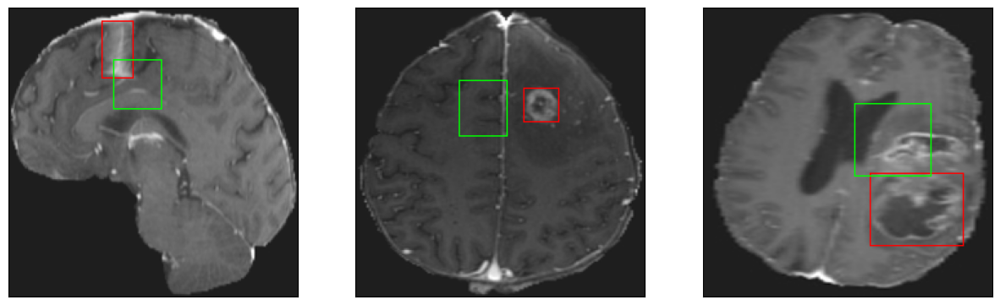

26/26 [==============================] - 3s 114ms/step - loss: 4.6539 - IoU: 0.6251 - val_loss: 10.7229 - val_IoU: 0.3946
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.3255 - IoU: 0.6471
Epoch 117: val_loss improved from 9.83280 to 9.65672, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


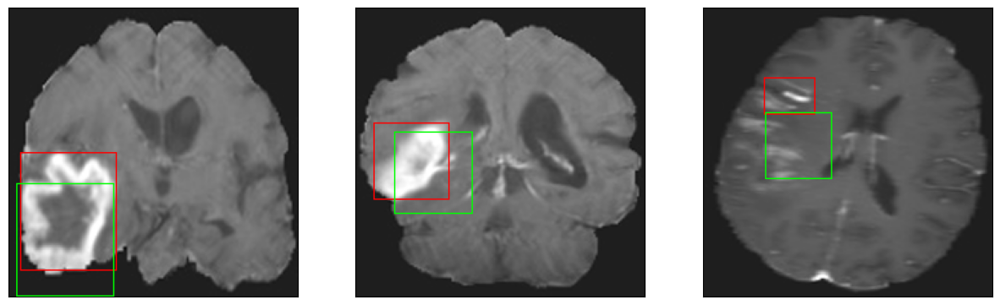

26/26 [==============================] - 4s 159ms/step - loss: 4.3255 - IoU: 0.6471 - val_loss: 9.6567 - val_IoU: 0.4441
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4751 - IoU: 0.6461
Epoch 118: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


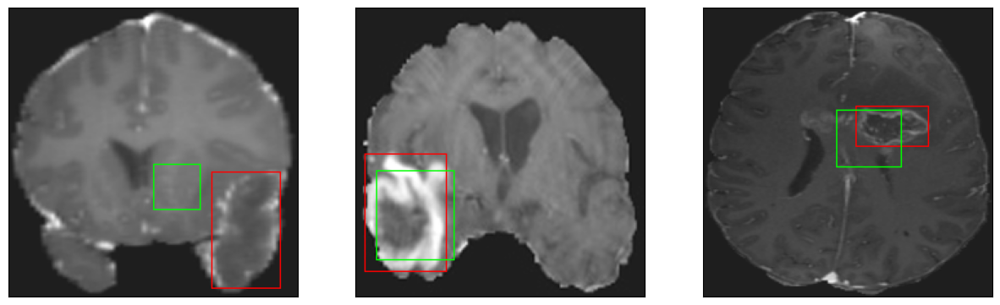

26/26 [==============================] - 3s 110ms/step - loss: 4.4649 - IoU: 0.6463 - val_loss: 11.1950 - val_IoU: 0.3789
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5151 - IoU: 0.6469
Epoch 119: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


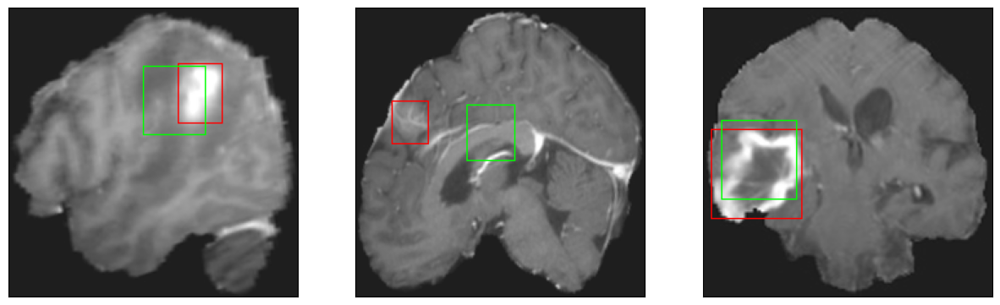

26/26 [==============================] - 3s 131ms/step - loss: 4.4826 - IoU: 0.6483 - val_loss: 10.4586 - val_IoU: 0.4083
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.3083 - IoU: 0.6448
Epoch 120: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


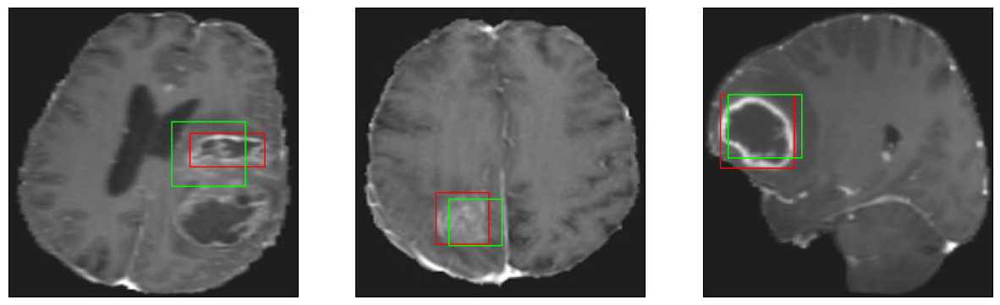

26/26 [==============================] - 3s 115ms/step - loss: 4.3083 - IoU: 0.6448 - val_loss: 10.6022 - val_IoU: 0.4164
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.4212 - IoU: 0.6360
Epoch 121: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


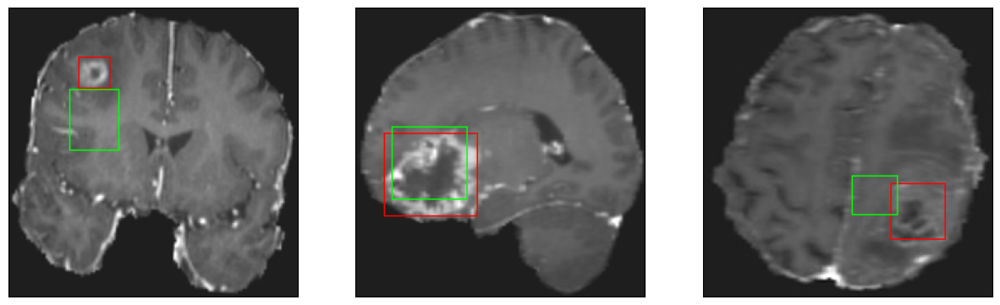

26/26 [==============================] - 3s 107ms/step - loss: 4.4212 - IoU: 0.6360 - val_loss: 10.8754 - val_IoU: 0.3890
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4015 - IoU: 0.6382
Epoch 122: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


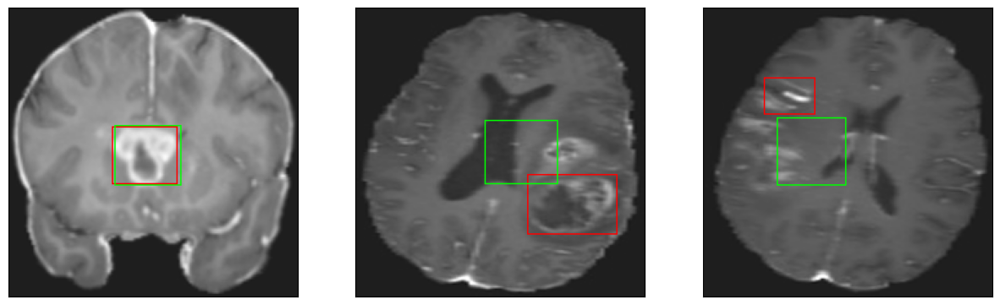

26/26 [==============================] - 2s 93ms/step - loss: 4.4376 - IoU: 0.6397 - val_loss: 10.8739 - val_IoU: 0.3904
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3321 - IoU: 0.6483
Epoch 123: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 7ms/step
4


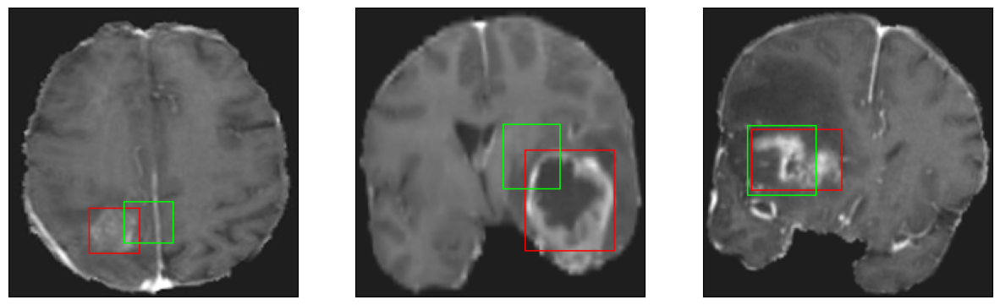

26/26 [==============================] - 3s 123ms/step - loss: 4.3630 - IoU: 0.6467 - val_loss: 10.3546 - val_IoU: 0.4141
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.3149 - IoU: 0.6468
Epoch 124: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


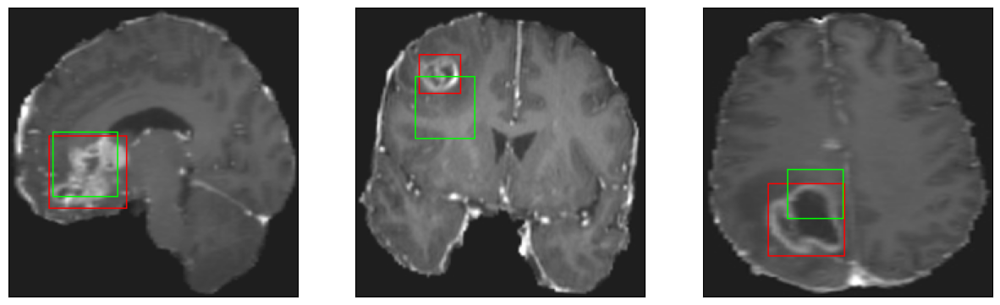

26/26 [==============================] - 3s 108ms/step - loss: 4.3149 - IoU: 0.6468 - val_loss: 9.9619 - val_IoU: 0.4377
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4867 - IoU: 0.6454
Epoch 125: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


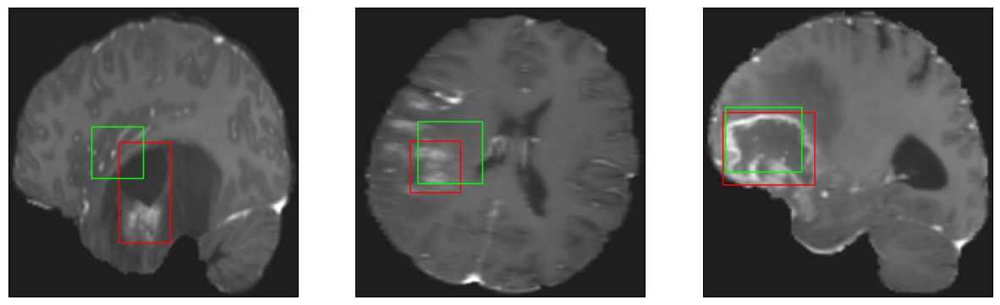

26/26 [==============================] - 3s 97ms/step - loss: 4.4743 - IoU: 0.6441 - val_loss: 10.3265 - val_IoU: 0.4151
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6904 - IoU: 0.6348
Epoch 126: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


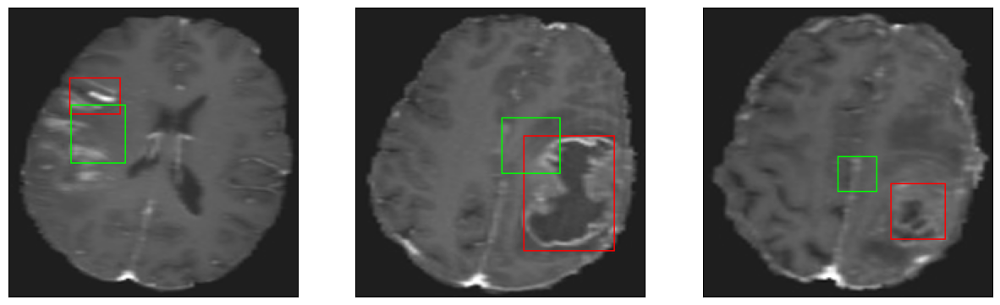

26/26 [==============================] - 3s 98ms/step - loss: 4.6617 - IoU: 0.6366 - val_loss: 12.8572 - val_IoU: 0.3209
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.5047 - IoU: 0.6417
Epoch 127: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


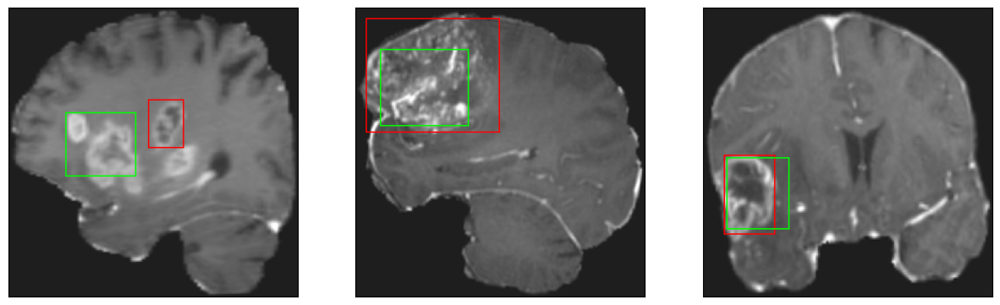

26/26 [==============================] - 3s 121ms/step - loss: 4.5047 - IoU: 0.6417 - val_loss: 10.1639 - val_IoU: 0.4180
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3476 - IoU: 0.6557
Epoch 128: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


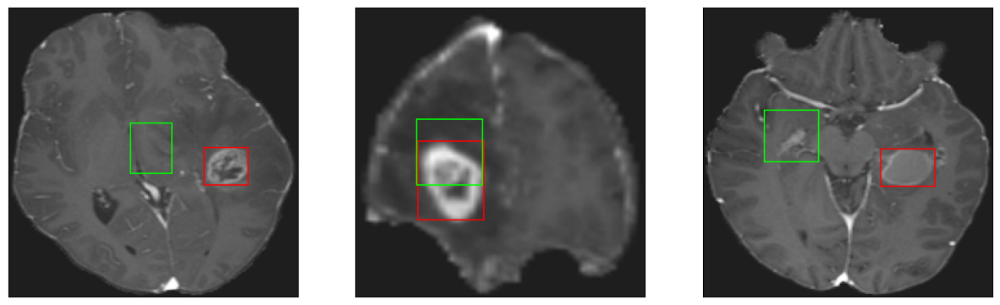

26/26 [==============================] - 3s 125ms/step - loss: 4.3485 - IoU: 0.6556 - val_loss: 10.7711 - val_IoU: 0.3916
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.4820 - IoU: 0.6485
Epoch 129: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


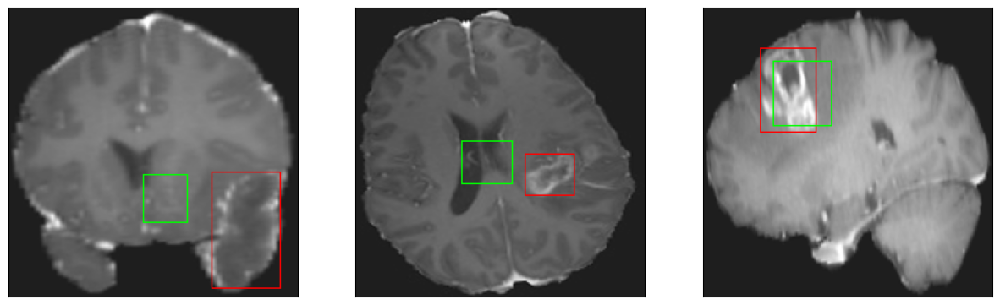

26/26 [==============================] - 3s 131ms/step - loss: 4.4820 - IoU: 0.6485 - val_loss: 9.8452 - val_IoU: 0.4495
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5570 - IoU: 0.6338
Epoch 130: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


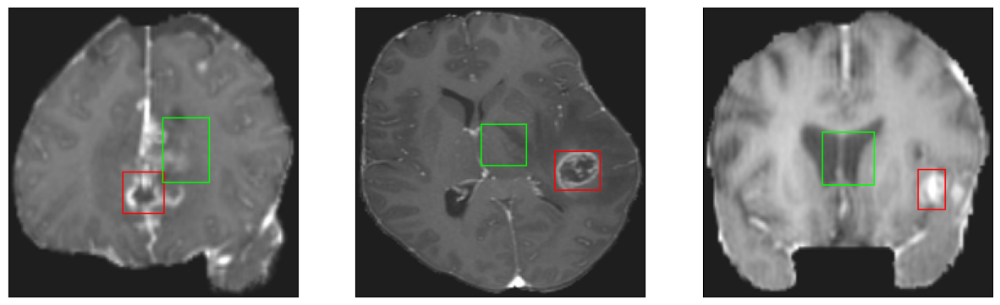

26/26 [==============================] - 3s 109ms/step - loss: 4.5766 - IoU: 0.6339 - val_loss: 10.0036 - val_IoU: 0.4286
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4562 - IoU: 0.6396
Epoch 131: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


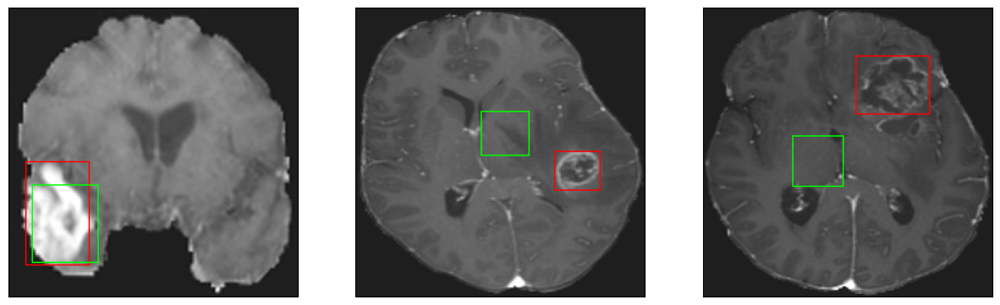

26/26 [==============================] - 3s 97ms/step - loss: 4.5007 - IoU: 0.6375 - val_loss: 10.3025 - val_IoU: 0.4140
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.5005 - IoU: 0.6415
Epoch 132: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


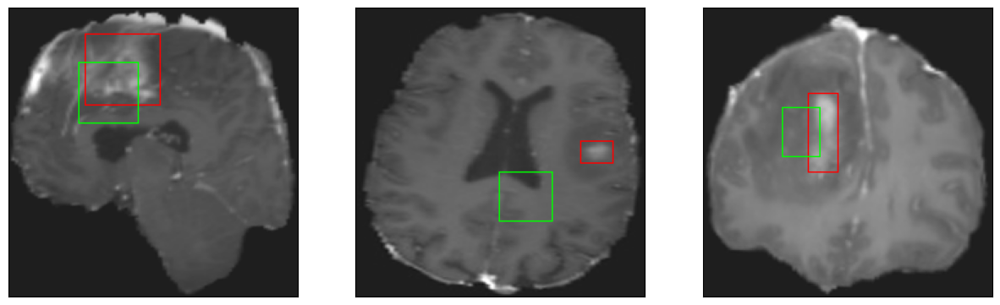

26/26 [==============================] - 3s 114ms/step - loss: 4.5005 - IoU: 0.6415 - val_loss: 12.2776 - val_IoU: 0.3384
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.3473 - IoU: 0.6532
Epoch 133: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


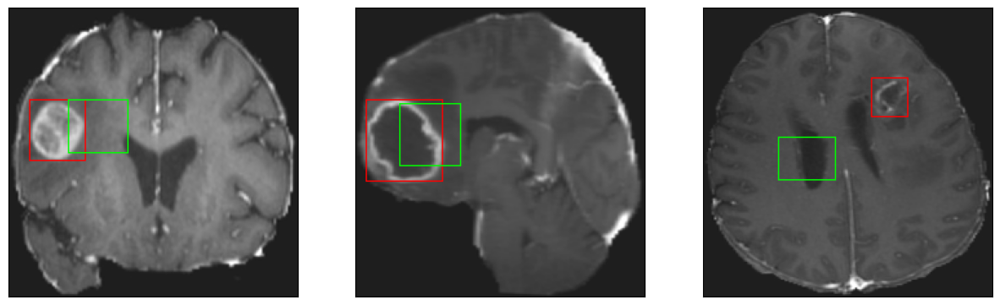

26/26 [==============================] - 3s 113ms/step - loss: 4.3473 - IoU: 0.6532 - val_loss: 11.3437 - val_IoU: 0.3713
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2367 - IoU: 0.6616
Epoch 134: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


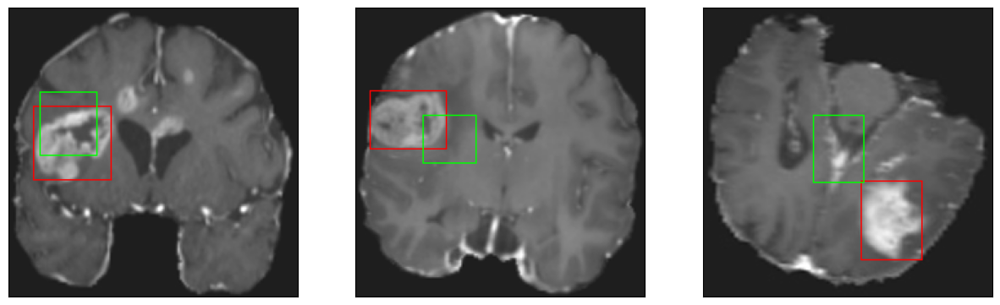

26/26 [==============================] - 3s 101ms/step - loss: 4.2535 - IoU: 0.6611 - val_loss: 11.5184 - val_IoU: 0.3557
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.2021 - IoU: 0.6596
Epoch 135: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


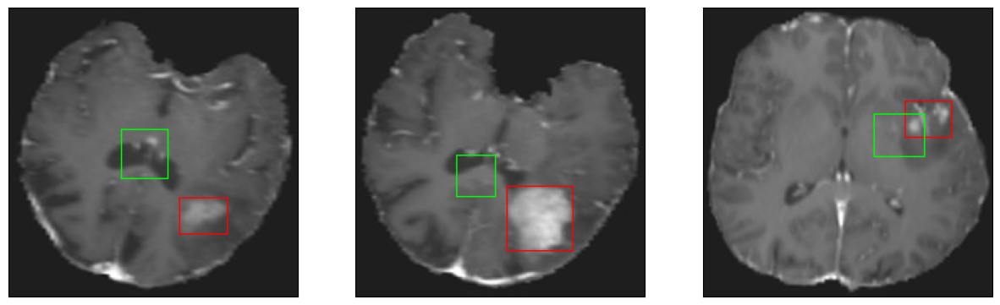

26/26 [==============================] - 3s 100ms/step - loss: 4.2021 - IoU: 0.6596 - val_loss: 9.8892 - val_IoU: 0.4339
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.3269 - IoU: 0.6488
Epoch 136: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


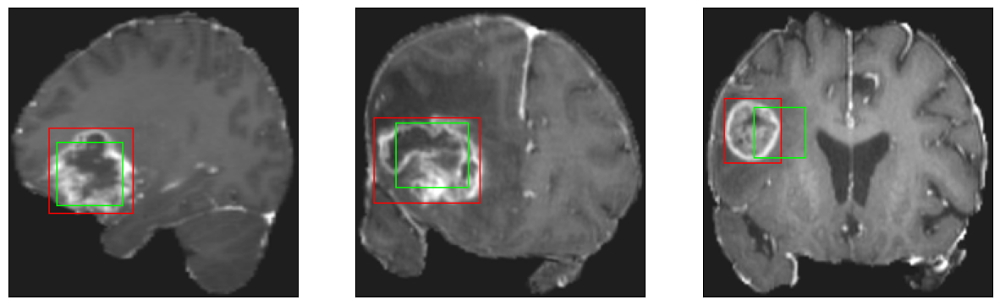

26/26 [==============================] - 3s 133ms/step - loss: 4.3269 - IoU: 0.6488 - val_loss: 11.2728 - val_IoU: 0.3826
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.3861 - IoU: 0.6459
Epoch 137: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


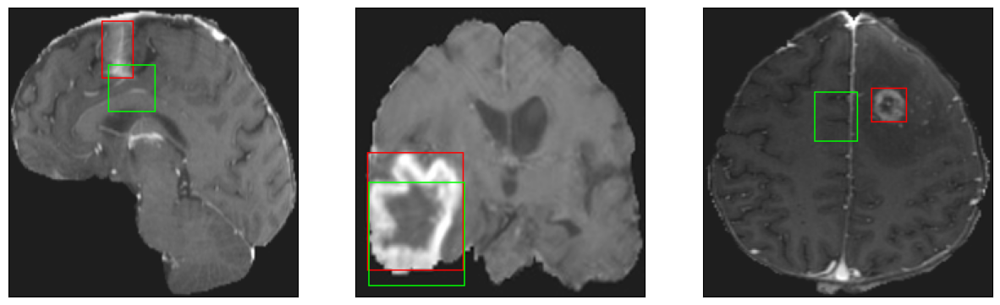

26/26 [==============================] - 3s 101ms/step - loss: 4.3861 - IoU: 0.6459 - val_loss: 9.9086 - val_IoU: 0.4296
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.3340 - IoU: 0.6505
Epoch 138: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


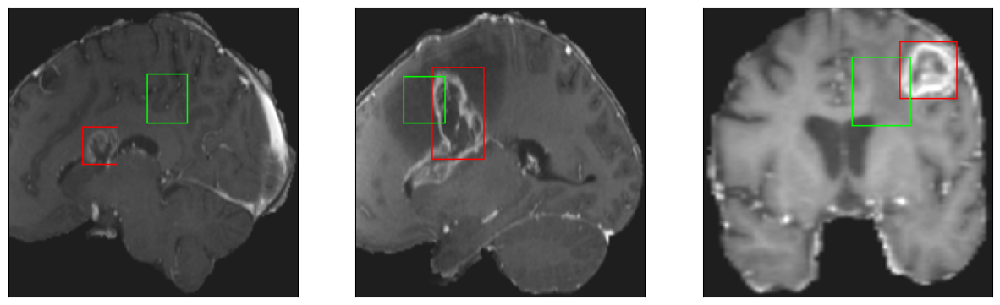

26/26 [==============================] - 2s 93ms/step - loss: 4.3340 - IoU: 0.6505 - val_loss: 10.7921 - val_IoU: 0.3980
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.1226 - IoU: 0.6633
Epoch 139: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


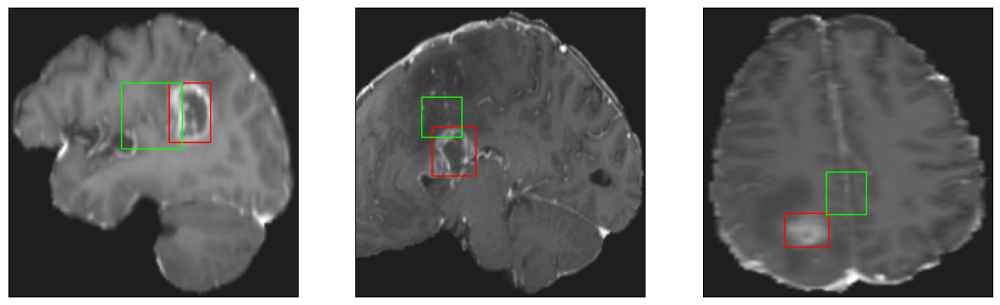

26/26 [==============================] - 3s 117ms/step - loss: 4.1226 - IoU: 0.6633 - val_loss: 10.5970 - val_IoU: 0.4042
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.1018 - IoU: 0.6612
Epoch 140: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


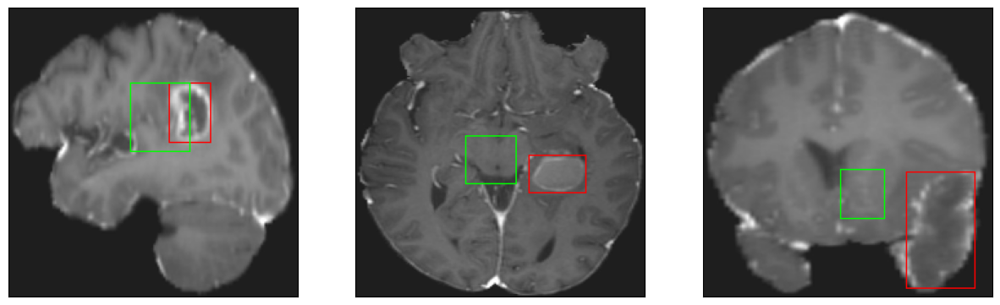

26/26 [==============================] - 3s 132ms/step - loss: 4.1018 - IoU: 0.6612 - val_loss: 10.2792 - val_IoU: 0.4155
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.4573 - IoU: 0.6410
Epoch 141: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


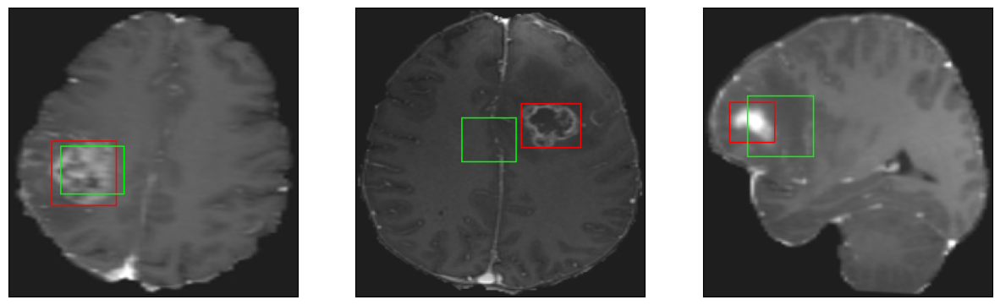

26/26 [==============================] - 3s 128ms/step - loss: 4.4573 - IoU: 0.6410 - val_loss: 10.8407 - val_IoU: 0.3923
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.4166 - IoU: 0.6552
Epoch 142: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


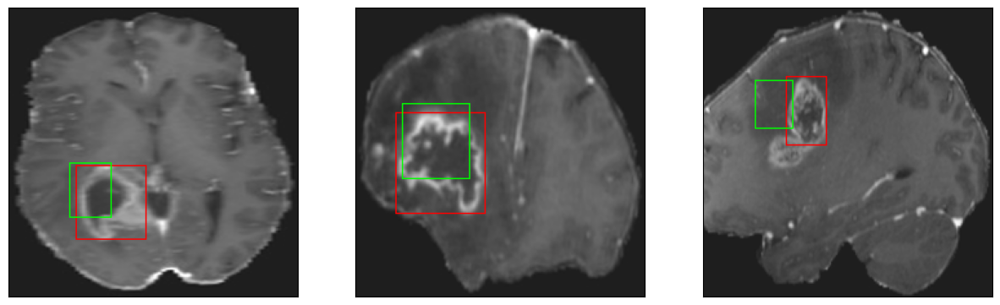

26/26 [==============================] - 3s 107ms/step - loss: 4.4166 - IoU: 0.6552 - val_loss: 9.7438 - val_IoU: 0.4304
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4463 - IoU: 0.6517
Epoch 143: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


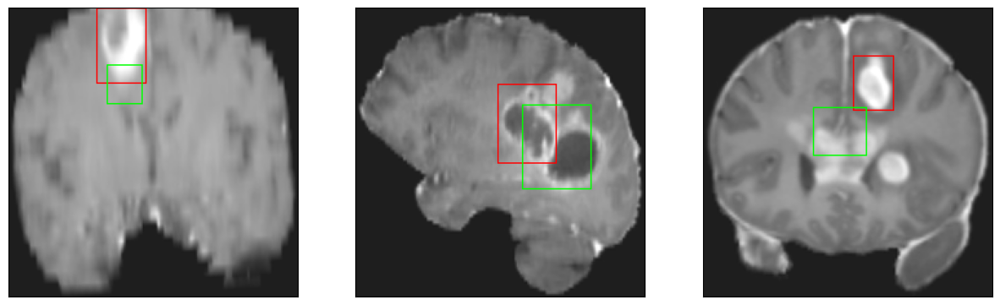

26/26 [==============================] - 3s 100ms/step - loss: 4.4195 - IoU: 0.6524 - val_loss: 10.1305 - val_IoU: 0.4268
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2915 - IoU: 0.6478
Epoch 144: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


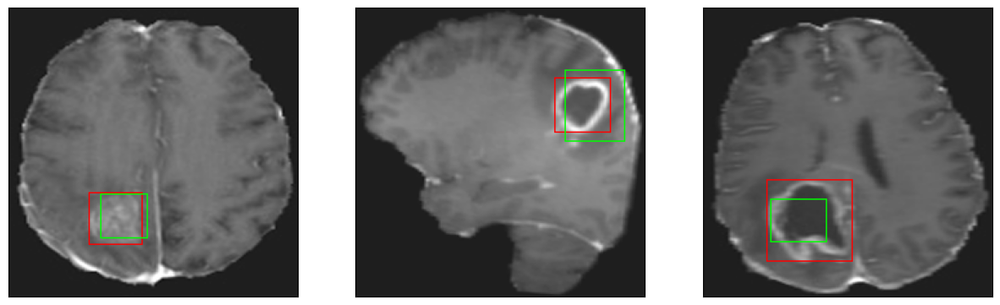

26/26 [==============================] - 3s 128ms/step - loss: 4.2974 - IoU: 0.6490 - val_loss: 10.0101 - val_IoU: 0.4185
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.2606 - IoU: 0.6532
Epoch 145: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


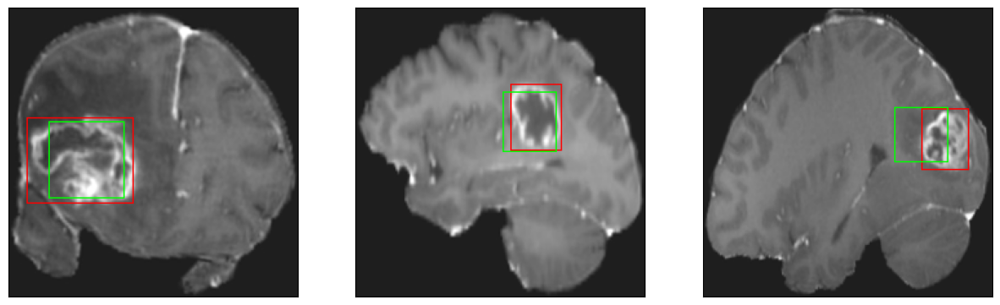

26/26 [==============================] - 3s 126ms/step - loss: 4.2606 - IoU: 0.6532 - val_loss: 9.8777 - val_IoU: 0.4398
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2112 - IoU: 0.6619
Epoch 146: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


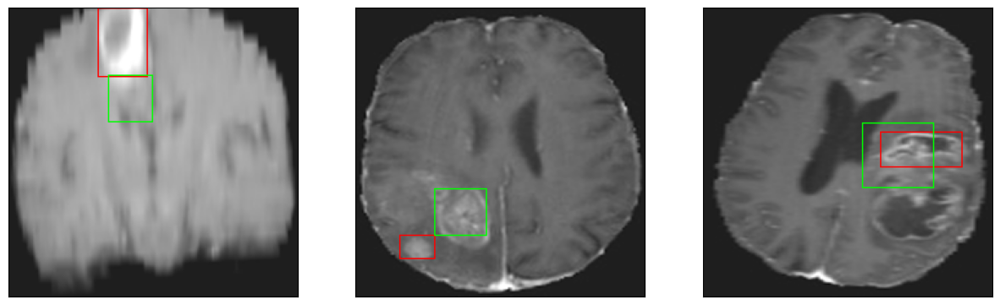

26/26 [==============================] - 3s 110ms/step - loss: 4.1927 - IoU: 0.6614 - val_loss: 10.6190 - val_IoU: 0.3993
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2853 - IoU: 0.6528
Epoch 147: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


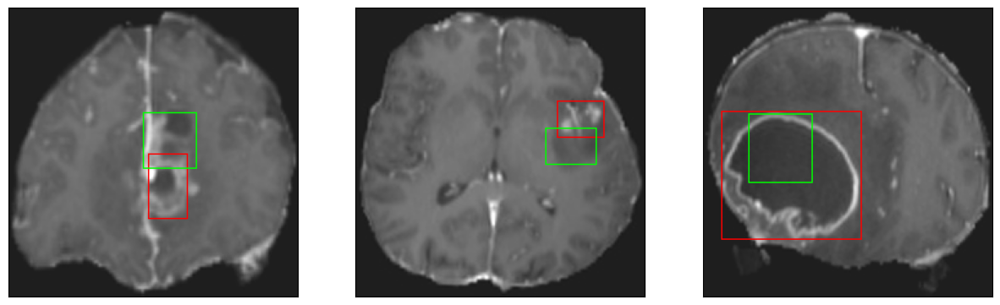

26/26 [==============================] - 3s 98ms/step - loss: 4.3134 - IoU: 0.6516 - val_loss: 10.1073 - val_IoU: 0.4264
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3423 - IoU: 0.6479
Epoch 148: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


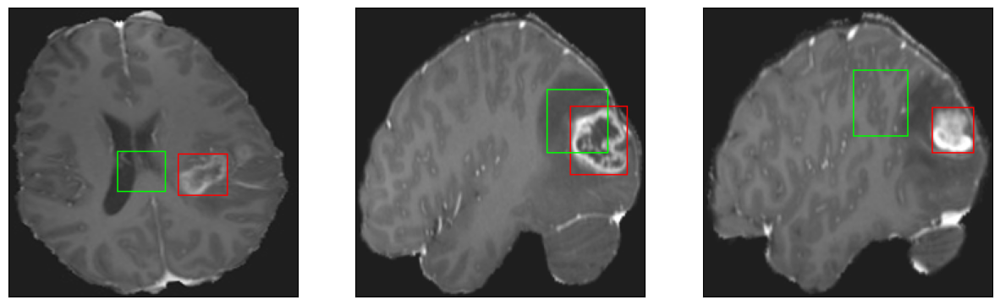

26/26 [==============================] - 3s 110ms/step - loss: 4.3266 - IoU: 0.6483 - val_loss: 9.8904 - val_IoU: 0.4325
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.3041 - IoU: 0.6532
Epoch 149: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


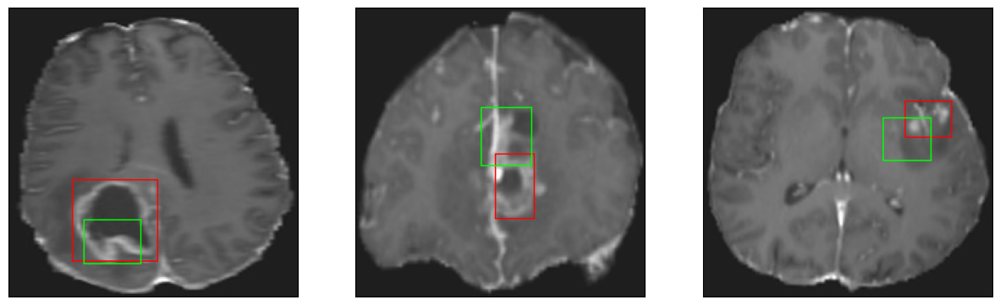

26/26 [==============================] - 3s 134ms/step - loss: 4.3041 - IoU: 0.6532 - val_loss: 9.6830 - val_IoU: 0.4533
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 4.1722 - IoU: 0.6647
Epoch 150: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


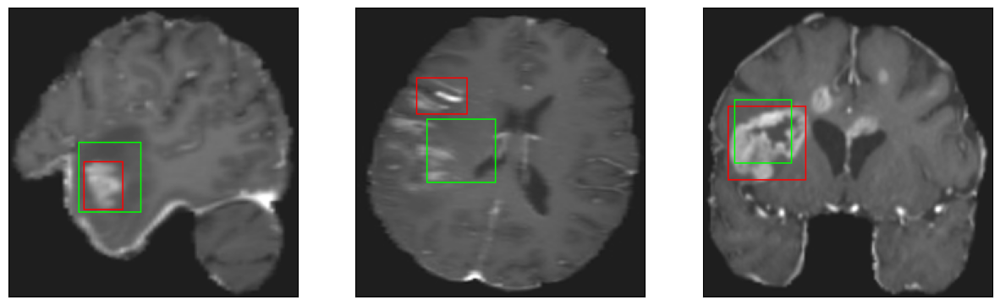

26/26 [==============================] - 3s 96ms/step - loss: 4.1722 - IoU: 0.6647 - val_loss: 10.2049 - val_IoU: 0.4189
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1171 - IoU: 0.6653
Epoch 151: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


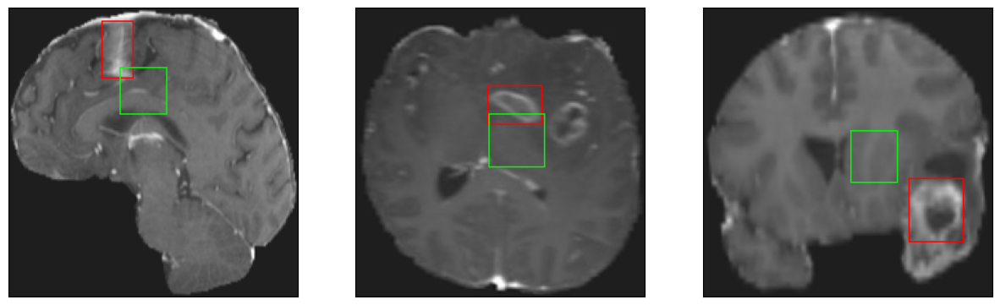

26/26 [==============================] - 3s 103ms/step - loss: 4.0914 - IoU: 0.6664 - val_loss: 10.2618 - val_IoU: 0.4080
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3146 - IoU: 0.6544
Epoch 152: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


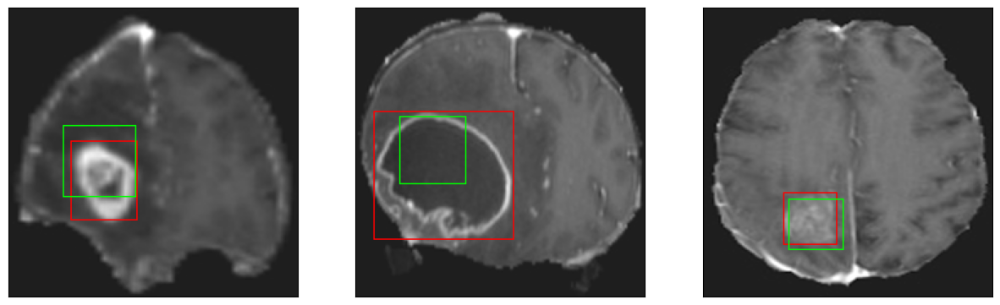

26/26 [==============================] - 3s 114ms/step - loss: 4.2880 - IoU: 0.6553 - val_loss: 9.6873 - val_IoU: 0.4412
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2810 - IoU: 0.6477
Epoch 153: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


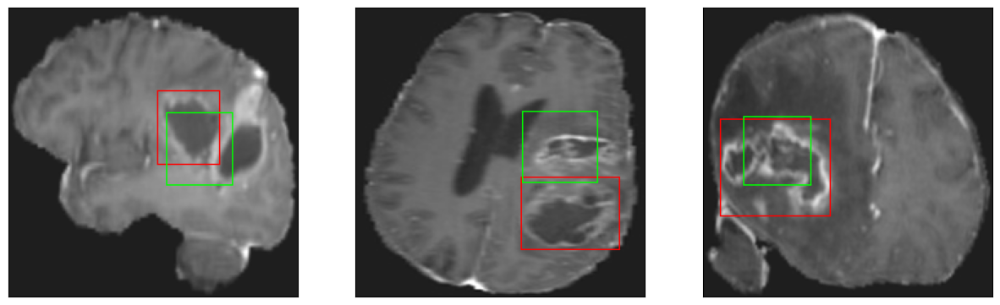

26/26 [==============================] - 3s 134ms/step - loss: 4.3524 - IoU: 0.6460 - val_loss: 9.9527 - val_IoU: 0.4354
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3048 - IoU: 0.6510
Epoch 154: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


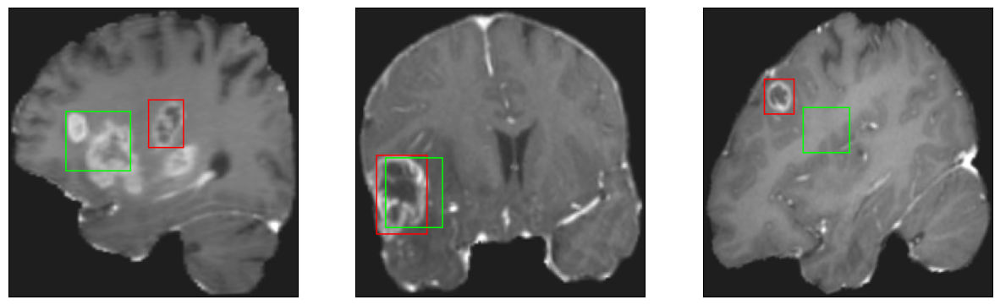

26/26 [==============================] - 3s 110ms/step - loss: 4.3126 - IoU: 0.6511 - val_loss: 10.1963 - val_IoU: 0.4182
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.0534 - IoU: 0.6713
Epoch 155: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


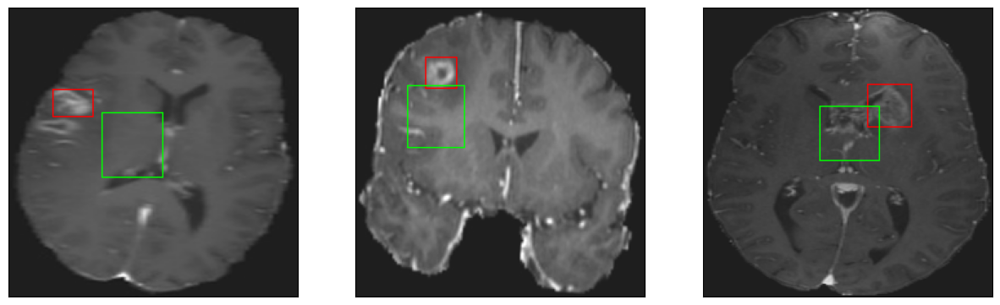

26/26 [==============================] - 3s 98ms/step - loss: 4.0534 - IoU: 0.6713 - val_loss: 9.9457 - val_IoU: 0.4345
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2620 - IoU: 0.6539
Epoch 156: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


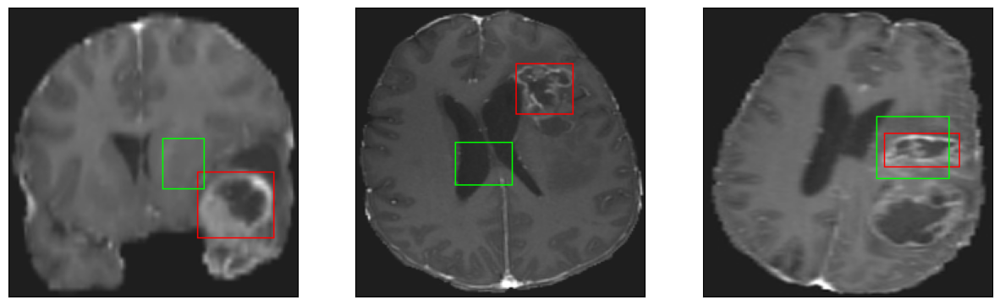

26/26 [==============================] - 3s 97ms/step - loss: 4.2164 - IoU: 0.6553 - val_loss: 9.9669 - val_IoU: 0.4305
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.2346 - IoU: 0.6556
Epoch 157: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


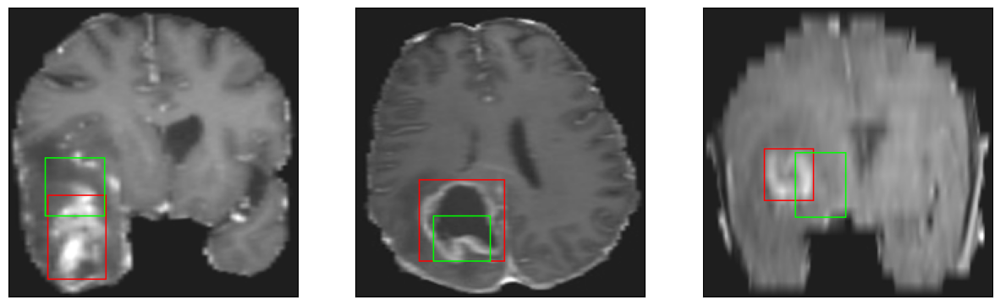

26/26 [==============================] - 3s 124ms/step - loss: 4.2346 - IoU: 0.6556 - val_loss: 9.7369 - val_IoU: 0.4461
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2694 - IoU: 0.6610
Epoch 158: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


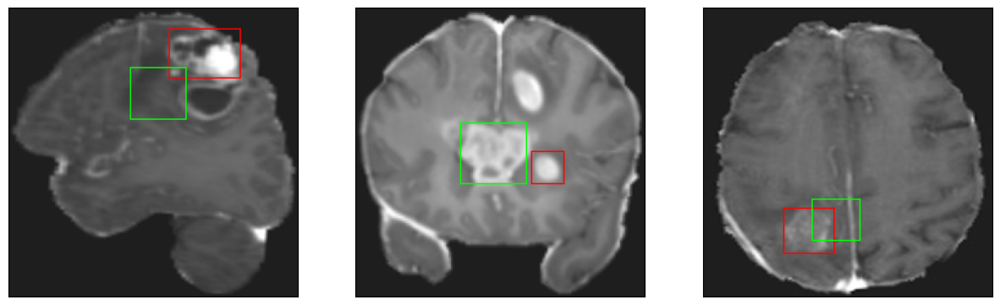

26/26 [==============================] - 4s 143ms/step - loss: 4.2235 - IoU: 0.6641 - val_loss: 10.0988 - val_IoU: 0.4227
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.2272 - IoU: 0.6604
Epoch 159: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


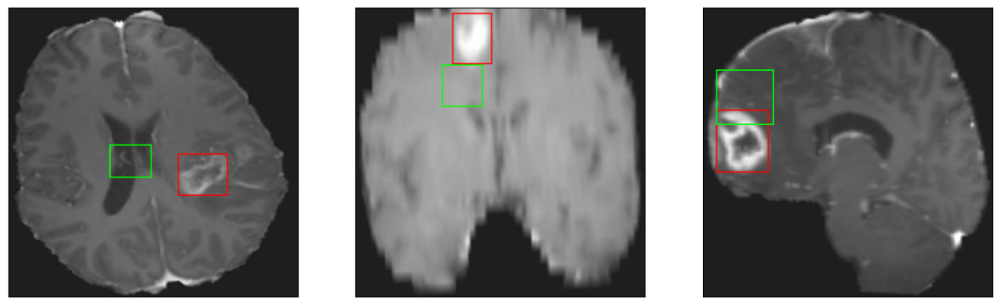

26/26 [==============================] - 3s 103ms/step - loss: 4.2272 - IoU: 0.6604 - val_loss: 11.1372 - val_IoU: 0.3783
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 4.3116 - IoU: 0.6565
Epoch 160: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


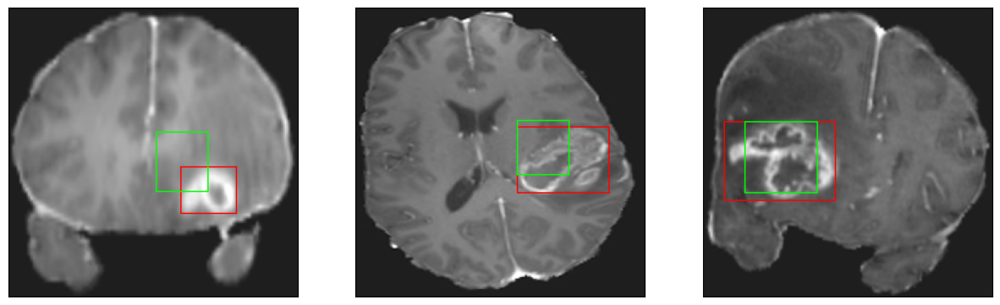

26/26 [==============================] - 3s 106ms/step - loss: 4.3116 - IoU: 0.6565 - val_loss: 10.3649 - val_IoU: 0.4176
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3182 - IoU: 0.6612
Epoch 161: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


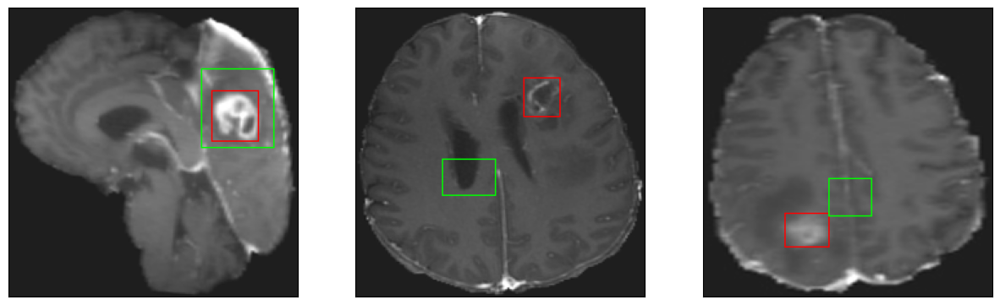

26/26 [==============================] - 3s 98ms/step - loss: 4.2793 - IoU: 0.6616 - val_loss: 10.2522 - val_IoU: 0.4087
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1505 - IoU: 0.6609
Epoch 162: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


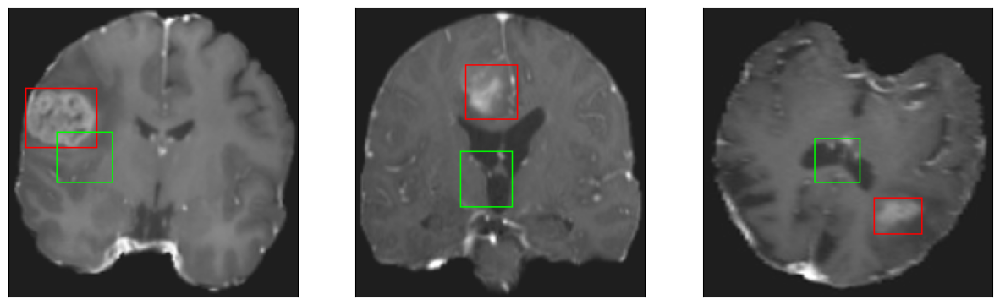

26/26 [==============================] - 4s 143ms/step - loss: 4.1682 - IoU: 0.6597 - val_loss: 9.9842 - val_IoU: 0.4306
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0418 - IoU: 0.6755
Epoch 163: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


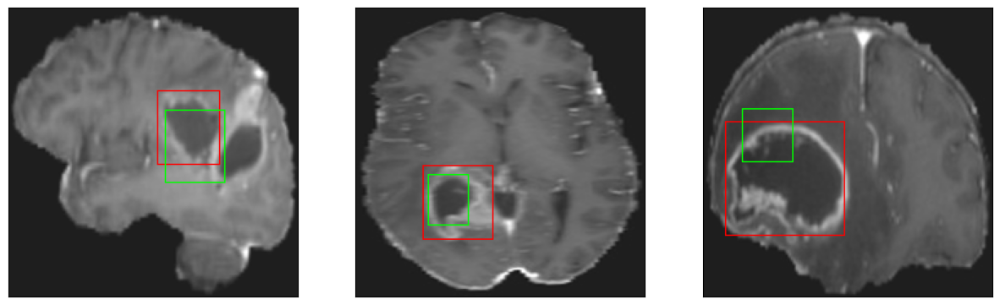

26/26 [==============================] - 3s 103ms/step - loss: 4.0468 - IoU: 0.6743 - val_loss: 10.6464 - val_IoU: 0.3938
Epoch 164/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1197 - IoU: 0.6652
Epoch 164: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


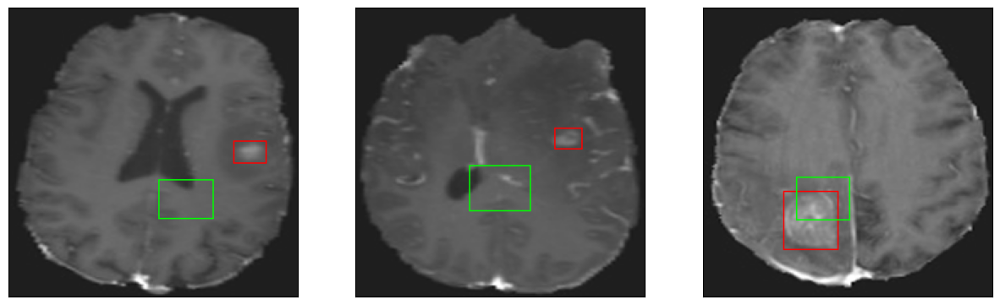

26/26 [==============================] - 3s 115ms/step - loss: 4.1152 - IoU: 0.6653 - val_loss: 12.7691 - val_IoU: 0.3198
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 4.1468 - IoU: 0.6556
Epoch 165: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


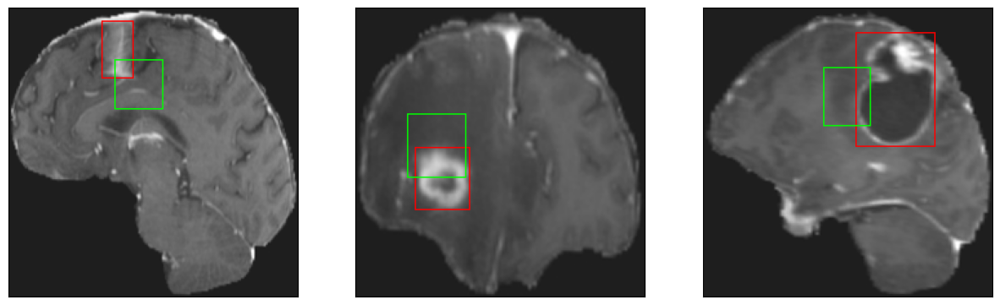

26/26 [==============================] - 4s 143ms/step - loss: 4.1468 - IoU: 0.6556 - val_loss: 9.7831 - val_IoU: 0.4339
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 4.1667 - IoU: 0.6584
Epoch 166: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


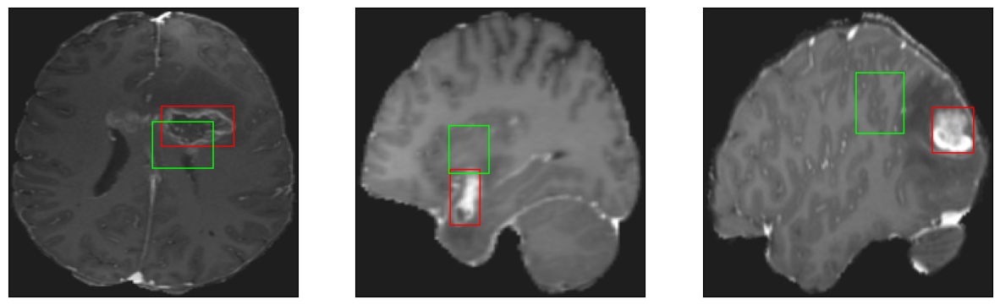

26/26 [==============================] - 3s 97ms/step - loss: 4.1667 - IoU: 0.6584 - val_loss: 9.9063 - val_IoU: 0.4378
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 4.1067 - IoU: 0.6664
Epoch 167: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


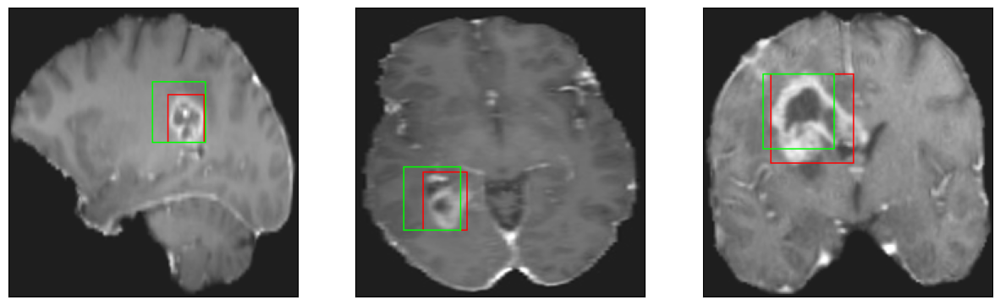

26/26 [==============================] - 3s 103ms/step - loss: 4.1067 - IoU: 0.6664 - val_loss: 10.2915 - val_IoU: 0.4199
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.1344 - IoU: 0.6586
Epoch 168: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


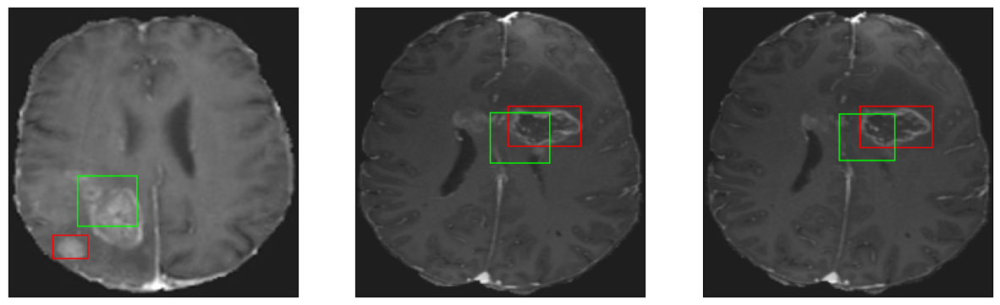

26/26 [==============================] - 3s 126ms/step - loss: 4.1344 - IoU: 0.6586 - val_loss: 10.1124 - val_IoU: 0.4247
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1235 - IoU: 0.6588
Epoch 169: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


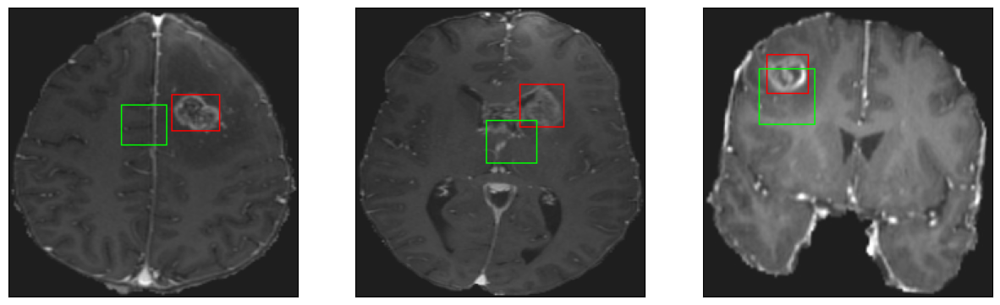

26/26 [==============================] - 3s 106ms/step - loss: 4.2400 - IoU: 0.6544 - val_loss: 11.0012 - val_IoU: 0.3936
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.1138 - IoU: 0.6653
Epoch 170: val_loss did not improve from 9.65672
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


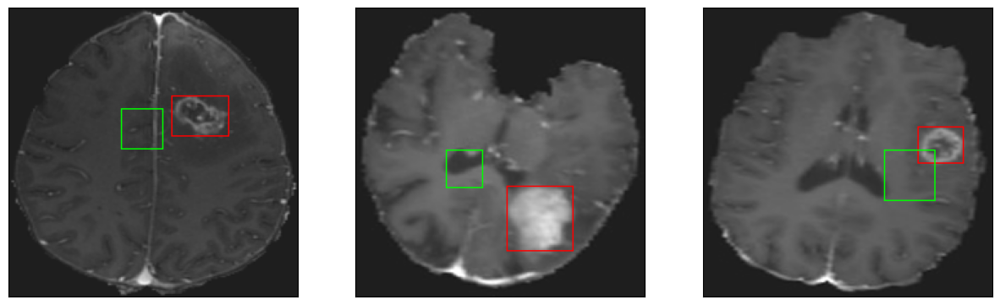

26/26 [==============================] - 3s 111ms/step - loss: 4.1138 - IoU: 0.6653 - val_loss: 9.9604 - val_IoU: 0.4319
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.0430 - IoU: 0.6653
Epoch 171: val_loss improved from 9.65672 to 9.59746, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


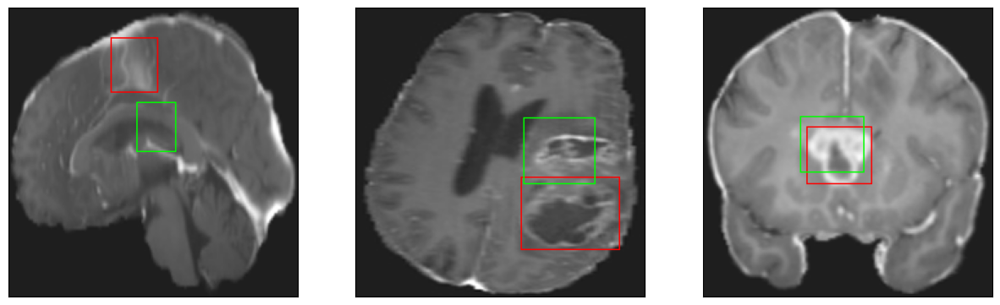

26/26 [==============================] - 5s 197ms/step - loss: 4.0430 - IoU: 0.6653 - val_loss: 9.5975 - val_IoU: 0.4478
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.1051 - IoU: 0.6654
Epoch 172: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


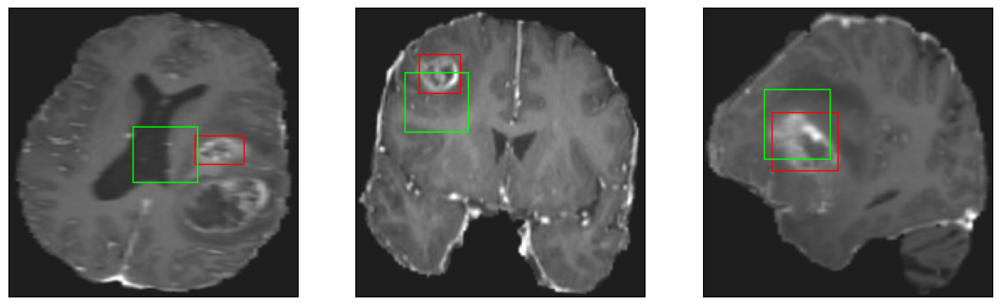

26/26 [==============================] - 3s 134ms/step - loss: 4.1051 - IoU: 0.6654 - val_loss: 10.9308 - val_IoU: 0.3922
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 4.0349 - IoU: 0.6640
Epoch 173: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 7ms/step
4


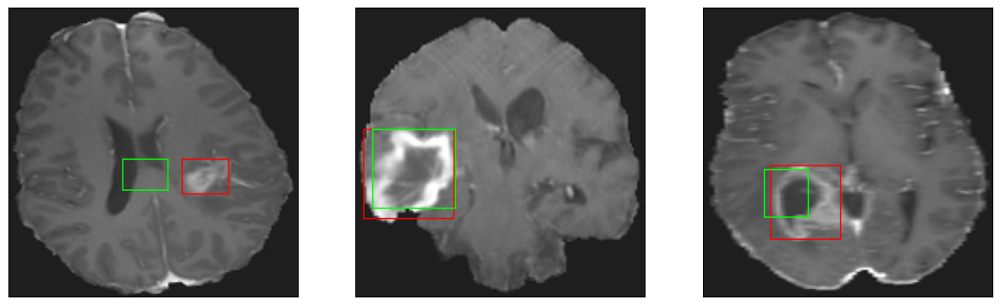

26/26 [==============================] - 3s 109ms/step - loss: 4.0349 - IoU: 0.6640 - val_loss: 9.6183 - val_IoU: 0.4457
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7895 - IoU: 0.6808
Epoch 174: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


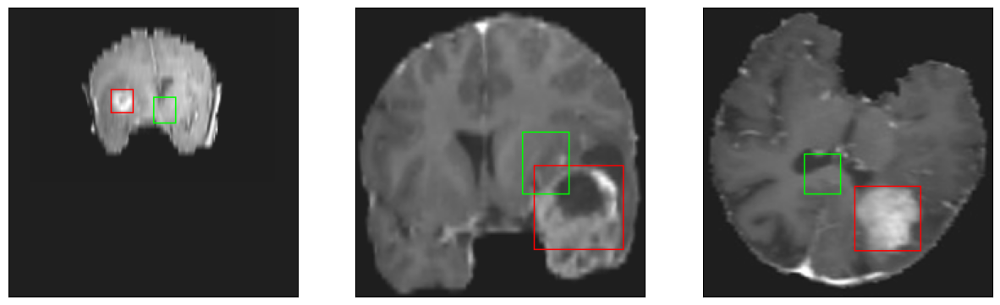

26/26 [==============================] - 3s 105ms/step - loss: 3.9038 - IoU: 0.6788 - val_loss: 10.4617 - val_IoU: 0.4132
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0613 - IoU: 0.6698
Epoch 175: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


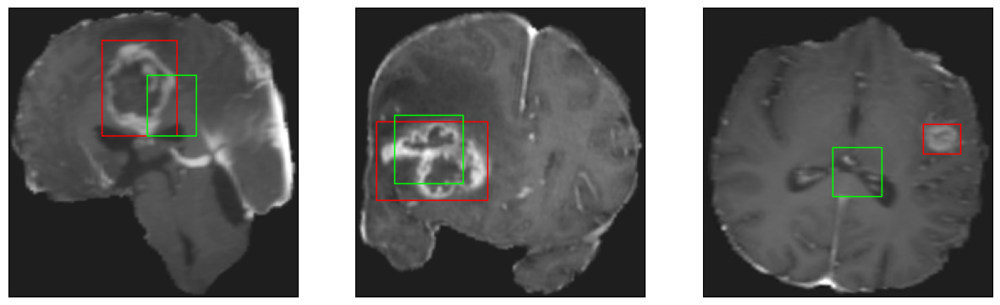

26/26 [==============================] - 3s 103ms/step - loss: 4.0378 - IoU: 0.6721 - val_loss: 10.2503 - val_IoU: 0.4186
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1886 - IoU: 0.6595
Epoch 176: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


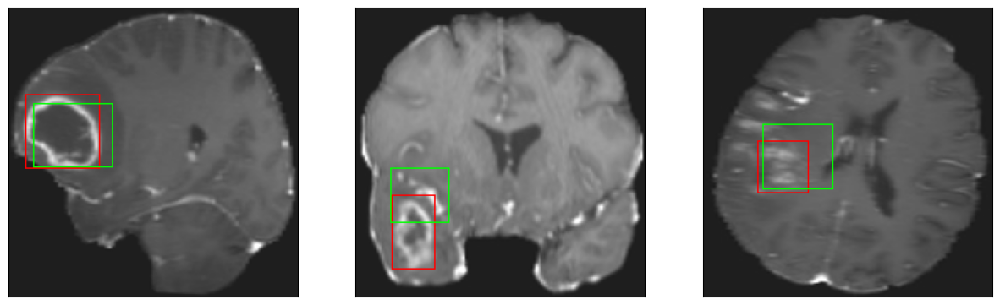

26/26 [==============================] - 3s 98ms/step - loss: 4.1709 - IoU: 0.6601 - val_loss: 9.6114 - val_IoU: 0.4541
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.1992 - IoU: 0.6609
Epoch 177: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


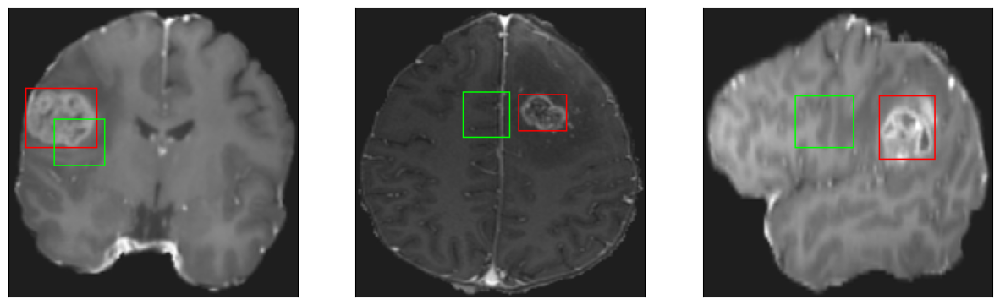

26/26 [==============================] - 4s 147ms/step - loss: 4.1992 - IoU: 0.6609 - val_loss: 9.6322 - val_IoU: 0.4508
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.0212 - IoU: 0.6725
Epoch 178: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


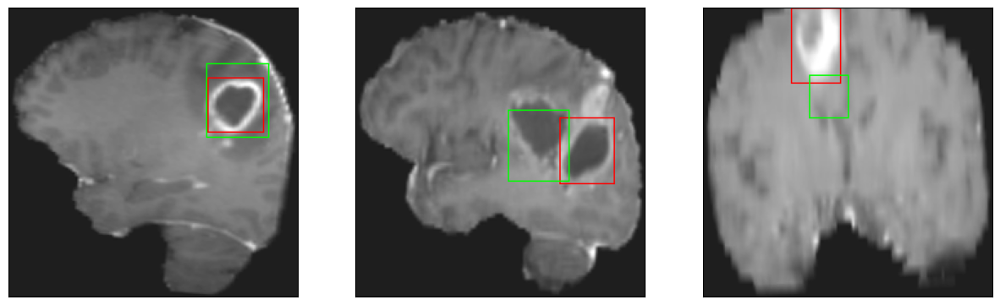

26/26 [==============================] - 3s 118ms/step - loss: 4.0212 - IoU: 0.6725 - val_loss: 10.2254 - val_IoU: 0.4319
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0613 - IoU: 0.6725
Epoch 179: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


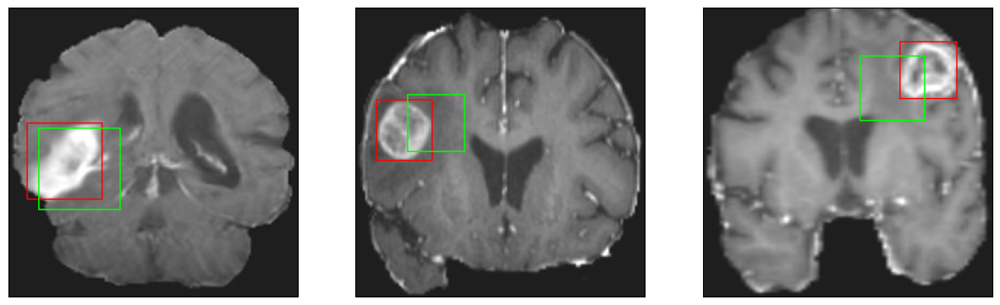

26/26 [==============================] - 2s 95ms/step - loss: 4.0962 - IoU: 0.6703 - val_loss: 9.9012 - val_IoU: 0.4488
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8538 - IoU: 0.6823
Epoch 180: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


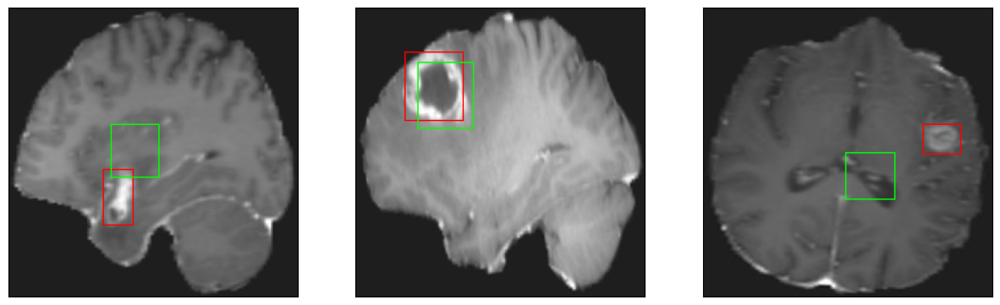

26/26 [==============================] - 2s 92ms/step - loss: 3.9508 - IoU: 0.6789 - val_loss: 10.1745 - val_IoU: 0.4404
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9793 - IoU: 0.6805
Epoch 181: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


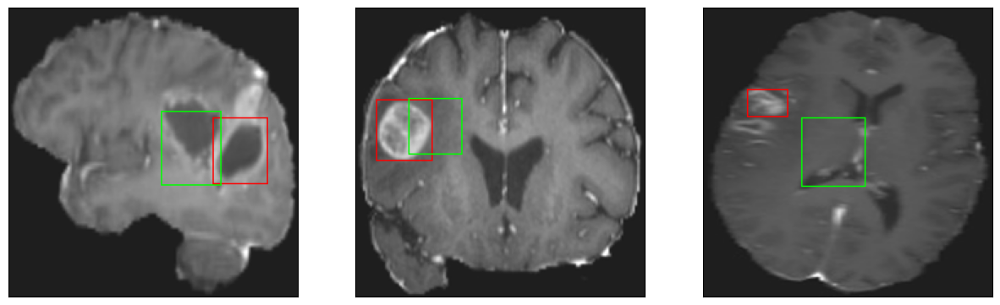

26/26 [==============================] - 3s 103ms/step - loss: 3.9629 - IoU: 0.6819 - val_loss: 9.6551 - val_IoU: 0.4487
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9805 - IoU: 0.6733
Epoch 182: val_loss did not improve from 9.59746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


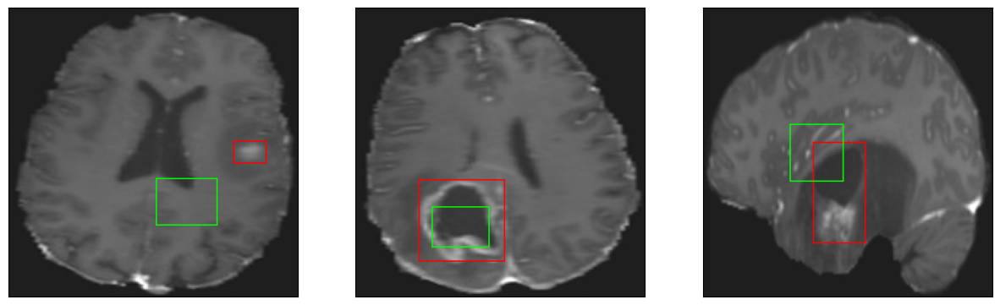

26/26 [==============================] - 3s 110ms/step - loss: 3.9699 - IoU: 0.6731 - val_loss: 10.0037 - val_IoU: 0.4381
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 3.9999 - IoU: 0.6729
Epoch 183: val_loss improved from 9.59746 to 9.52423, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


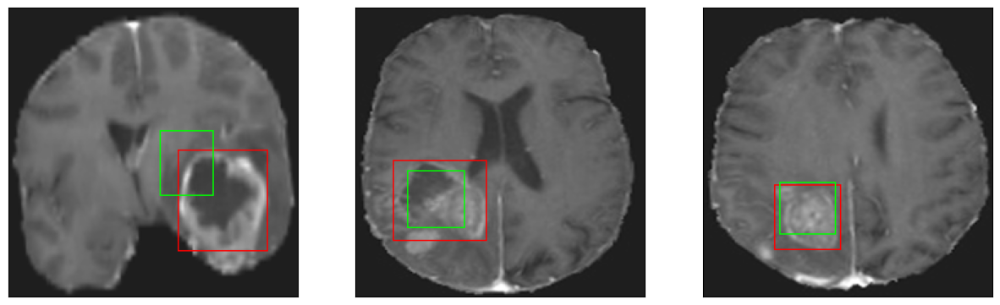

26/26 [==============================] - 4s 148ms/step - loss: 3.9999 - IoU: 0.6729 - val_loss: 9.5242 - val_IoU: 0.4456
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.0803 - IoU: 0.6679
Epoch 184: val_loss did not improve from 9.52423
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


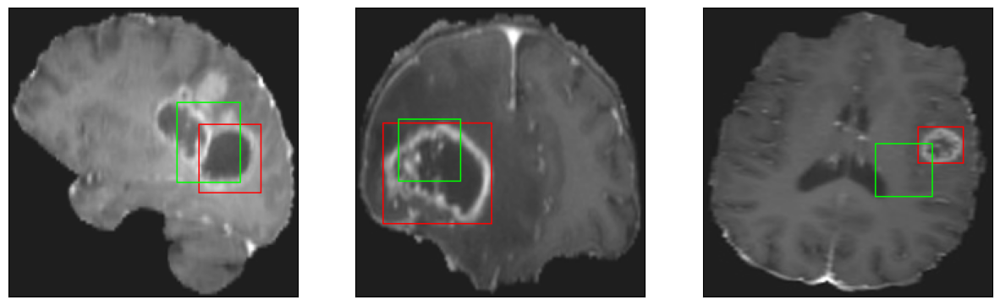

26/26 [==============================] - 3s 109ms/step - loss: 4.0803 - IoU: 0.6679 - val_loss: 10.5633 - val_IoU: 0.4139
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8909 - IoU: 0.6788
Epoch 185: val_loss improved from 9.52423 to 9.10325, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


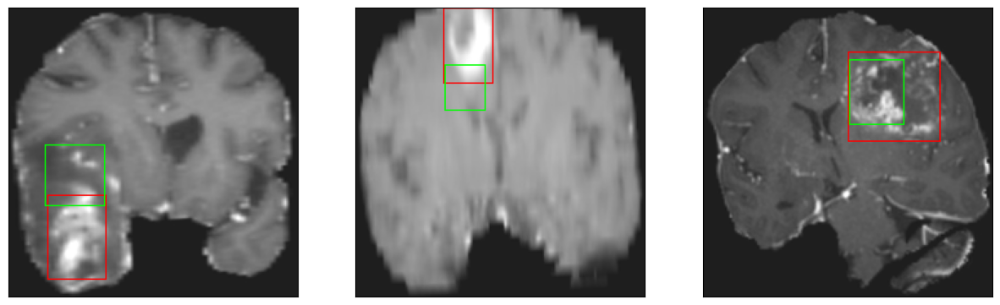

26/26 [==============================] - 3s 134ms/step - loss: 4.0388 - IoU: 0.6732 - val_loss: 9.1033 - val_IoU: 0.4780
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0979 - IoU: 0.6686
Epoch 186: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


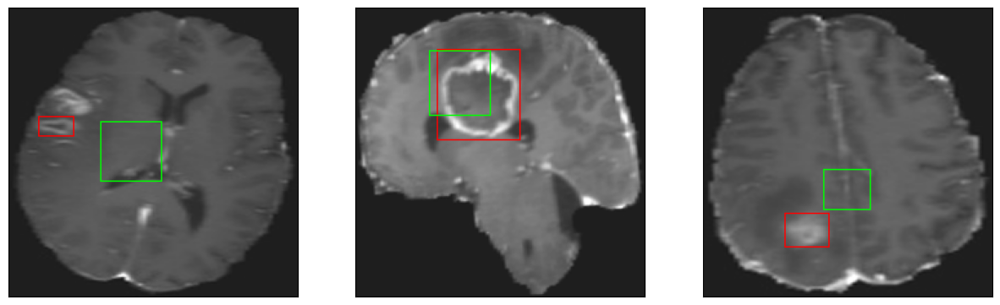

26/26 [==============================] - 3s 106ms/step - loss: 4.0857 - IoU: 0.6698 - val_loss: 9.5865 - val_IoU: 0.4551
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9980 - IoU: 0.6727
Epoch 187: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


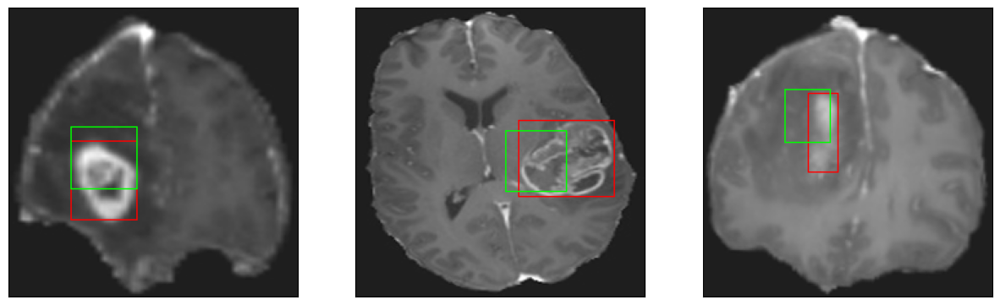

26/26 [==============================] - 3s 112ms/step - loss: 4.0190 - IoU: 0.6716 - val_loss: 9.6978 - val_IoU: 0.4468
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0203 - IoU: 0.6776
Epoch 188: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


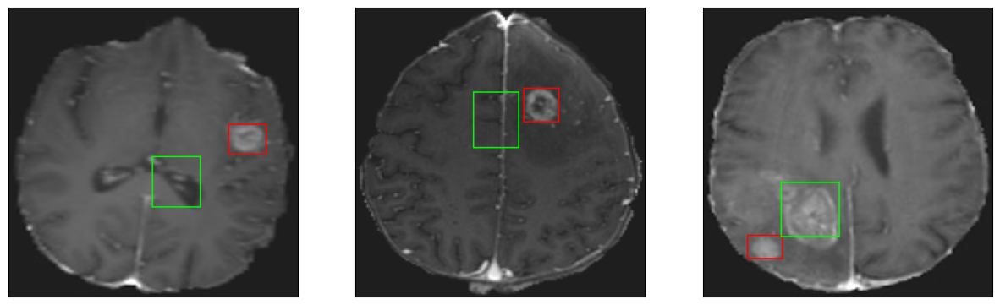

26/26 [==============================] - 3s 110ms/step - loss: 3.9994 - IoU: 0.6776 - val_loss: 9.6733 - val_IoU: 0.4515
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0924 - IoU: 0.6734
Epoch 189: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


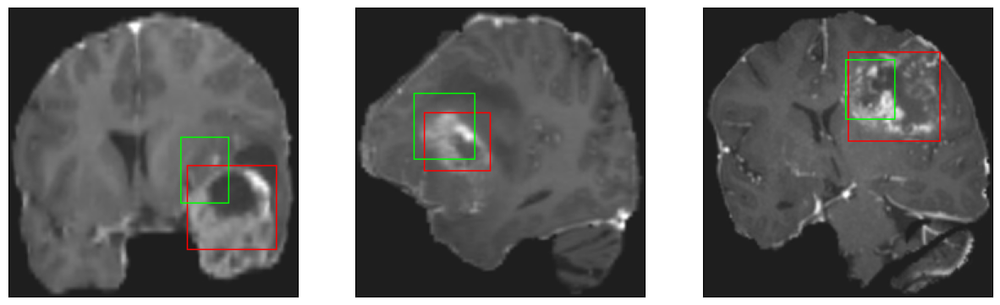

26/26 [==============================] - 3s 104ms/step - loss: 4.0512 - IoU: 0.6747 - val_loss: 9.8182 - val_IoU: 0.4404
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 3.8874 - IoU: 0.6893
Epoch 190: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


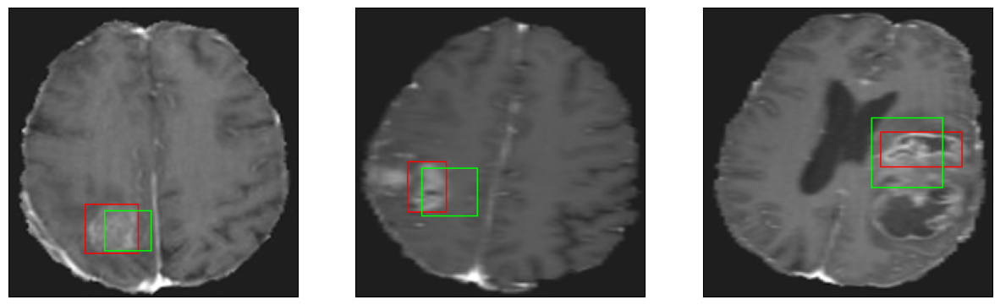

26/26 [==============================] - 3s 122ms/step - loss: 3.8874 - IoU: 0.6893 - val_loss: 9.3925 - val_IoU: 0.4683
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8492 - IoU: 0.6802
Epoch 191: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


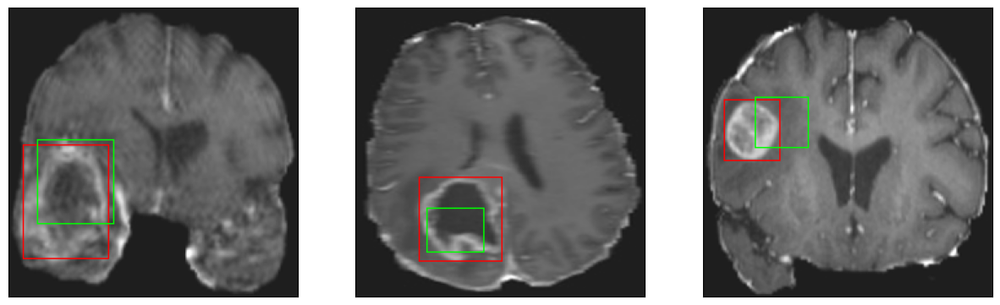

26/26 [==============================] - 3s 105ms/step - loss: 3.9238 - IoU: 0.6777 - val_loss: 9.9575 - val_IoU: 0.4422
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 3.8592 - IoU: 0.6874
Epoch 192: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


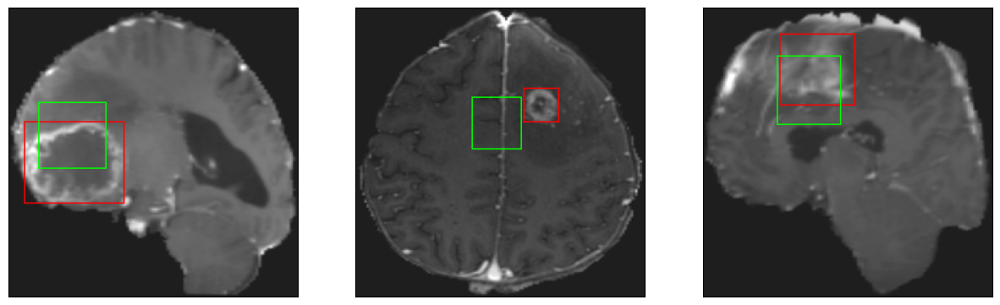

26/26 [==============================] - 3s 106ms/step - loss: 3.8592 - IoU: 0.6874 - val_loss: 9.4738 - val_IoU: 0.4579
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8602 - IoU: 0.6863
Epoch 193: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


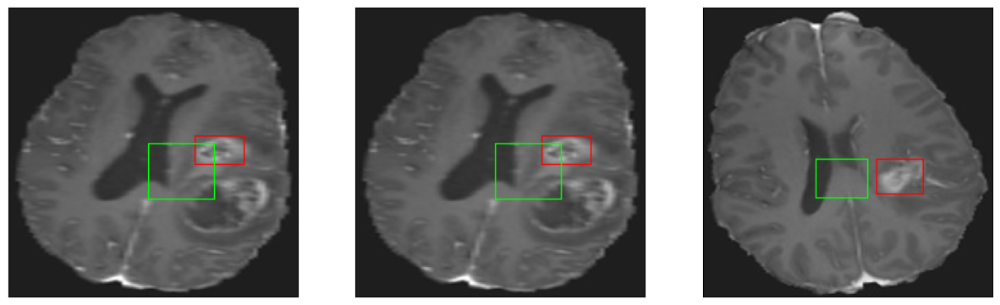

26/26 [==============================] - 3s 124ms/step - loss: 3.8564 - IoU: 0.6851 - val_loss: 10.3678 - val_IoU: 0.4212
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 3.9244 - IoU: 0.6760
Epoch 194: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


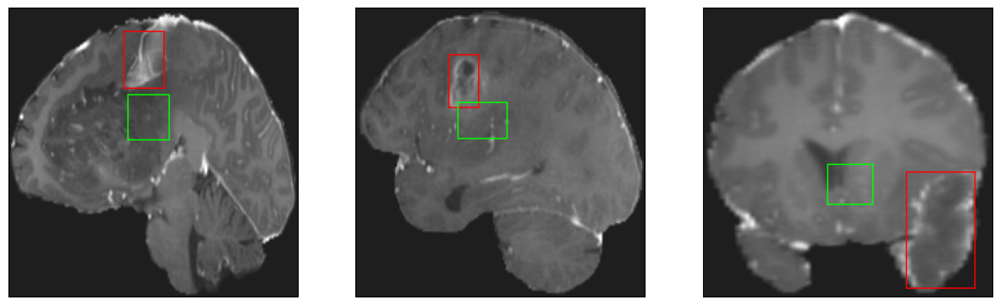

26/26 [==============================] - 2s 95ms/step - loss: 3.9244 - IoU: 0.6760 - val_loss: 10.2032 - val_IoU: 0.4218
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.1368 - IoU: 0.6640
Epoch 195: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


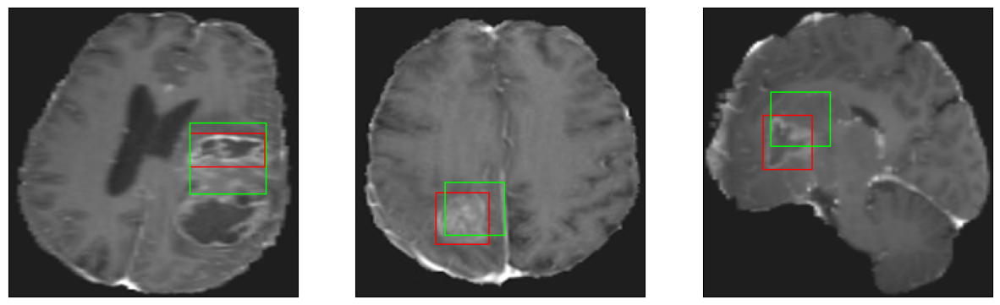

26/26 [==============================] - 3s 103ms/step - loss: 4.1368 - IoU: 0.6640 - val_loss: 10.7039 - val_IoU: 0.4164
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 4.1233 - IoU: 0.6709
Epoch 196: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


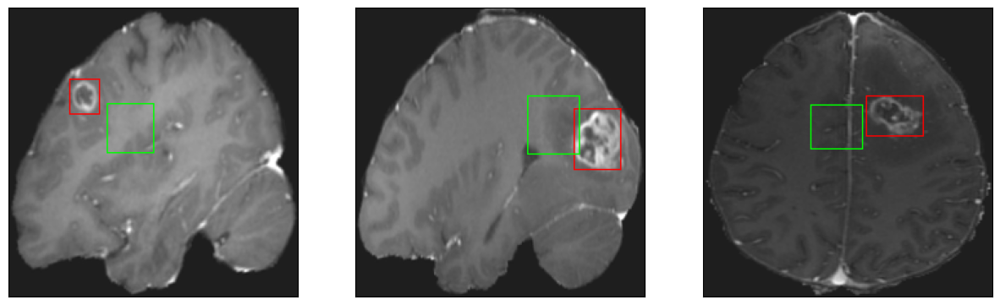

26/26 [==============================] - 3s 110ms/step - loss: 4.1233 - IoU: 0.6709 - val_loss: 10.7580 - val_IoU: 0.3993
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 3.9608 - IoU: 0.6791
Epoch 197: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


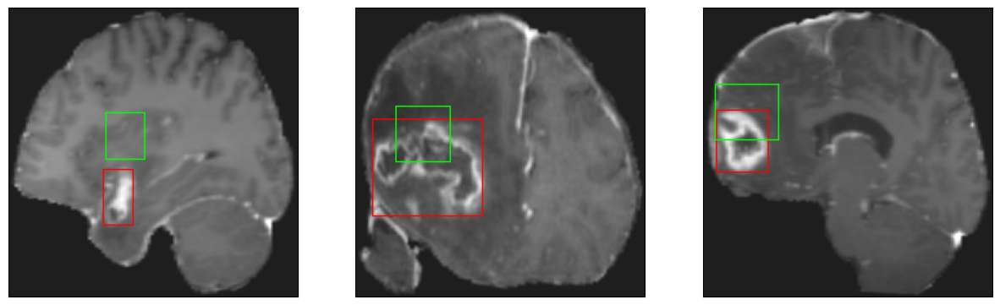

26/26 [==============================] - 3s 127ms/step - loss: 3.9608 - IoU: 0.6791 - val_loss: 11.2647 - val_IoU: 0.3816
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9881 - IoU: 0.6799
Epoch 198: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


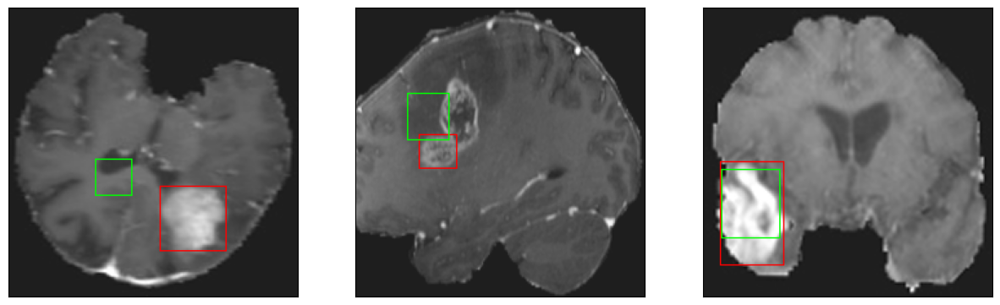

26/26 [==============================] - 4s 137ms/step - loss: 4.0151 - IoU: 0.6781 - val_loss: 9.7953 - val_IoU: 0.4341
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9891 - IoU: 0.6783
Epoch 199: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


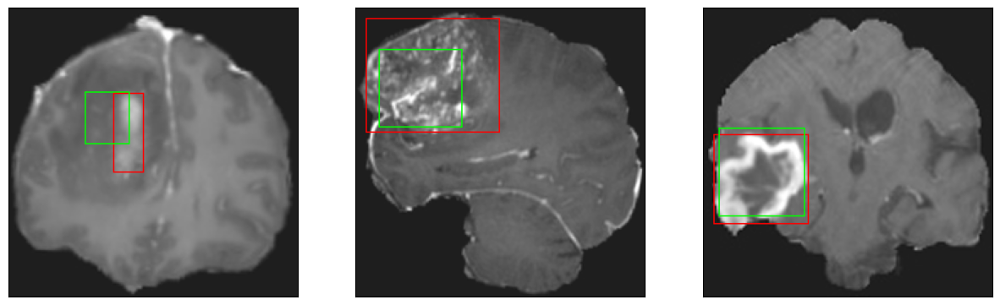

26/26 [==============================] - 3s 102ms/step - loss: 3.9644 - IoU: 0.6801 - val_loss: 9.5315 - val_IoU: 0.4494
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9146 - IoU: 0.6790
Epoch 200: val_loss did not improve from 9.10325
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


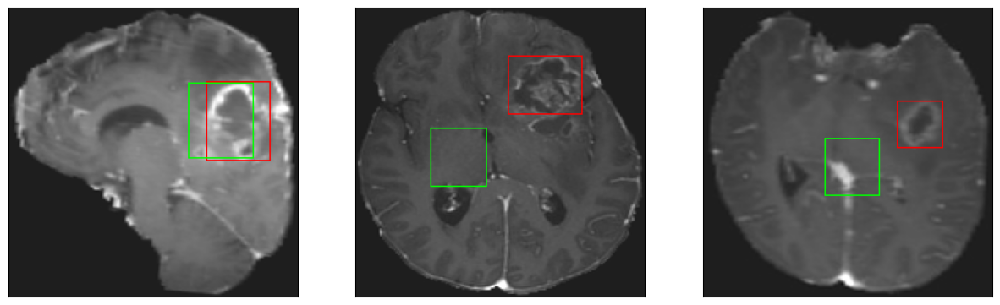

26/26 [==============================] - 3s 100ms/step - loss: 3.9073 - IoU: 0.6794 - val_loss: 9.8142 - val_IoU: 0.4494


In [24]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [25]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [26]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [27]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 33ms/step - loss: 16.8526 - IoU: 0.2360


[16.852611541748047, 0.23604772984981537]